# Recommendation Analysis - MovieLens/DDD

This notebook will train 3 recommendation algorithms on the MovieLens 25M rating data: NormalPredictor, TopPop, and SVD. We generate accuracy metrics for each algorithm's rating predictions and recommendations for 1000 randomly chosen users. We look at the prevalence of https://www.doesthedogdie.com/ warnings in the users' histories vs their top recommendations.

## Set Up

In [1]:
# Install necessary packages. Uncomment following lines if the packages are not included in your environment.

# !pip install numpy
# !pip install pandas
# !pip install surprise
# !pip install matplotlib
# !pip install seaborn

from surprise import accuracy, Dataset, Reader, SVD, NormalPredictor
# from surprise.model_selection import train_test_split
from sklearn.model_selection import train_test_split

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

try:
    plt.style.use("seaborn-v0_8-darkgrid")
except:
    plt.style.use("seaborn-darkgrid")
plt.rcParams.update({'font.size': 16})

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


### Load Relevant Data Frames

In [2]:
# user_id | work_id | rating
interaction_table = pd.read_csv("data/ml-ddd_interaction_table.csv")

# work_id | one-hot encoded warnings (Clear Yes, Clear No, Unclear, No Votes) | n_ratings | av_rating | user_ratings | all_warnings
work_metadata = pd.read_csv("data/ml-ddd_sensitivity_table.csv")

### Select 1000 Random Users
These users will be used to generate recommendations for throughout the analysis

In [3]:
np.random.seed(42)
random_users = np.random.choice(interaction_table['user_id'].unique(), 1000, replace=False)

# Dictionary user_id : set(work_ids)
random_user_works_dict = {user : set(interaction_table[interaction_table["user_id"] == user]["work_id"].values) for user in random_users}

# Subset of user interaction dataframe for users in the 1000 randomly selected group
interaction_table_subset = interaction_table[interaction_table["user_id"].isin(random_user_works_dict.keys())]

### Initialize Surprise Tools

In [5]:
# Initialize surprise reader to process ratings.csv, the entirety of the MovieLens25M interactions, into a surprise Dataset
reader = Reader(line_format="user item rating timestamp", sep=',', rating_scale=(0.5, 5.0), skip_lines=1)

# Load the data into a 90-10 train-test split
data = Dataset.load_from_df(interaction_table[["user_id", "work_id", "rating"]], reader=reader)
full_trainset = data.build_full_trainset()

# Load user subset data to test on
data_subset = Dataset.load_from_df(interaction_table_subset, reader=reader).build_full_trainset()
data_subset_seen = data_subset.build_testset()

### Helper Functions

In [5]:
def get_liked_works(user_id, interactions_dict):
    """
    Gets the works liked by user_id. "Liked" is defined as having a rating in the top quartile of the user's ratings.
    """
    sorted_user_ratings = np.sort(interaction_table[interaction_table['user_id'] == user_id]['rating'])
    quartile_cutoff = np.percentile(sorted_user_ratings, 75)
    top_quartile_ratings = sorted_user_ratings[sorted_user_ratings >= quartile_cutoff]
    
    return set(top_quartile_ratings)


def metrics_at_k(recommendations, interactions_dict):
    """
    Calculates the Precision@k and Recall@k for the given recommendations with respect to the user histories in interactions_dict.
    Args:
        recommendations: dictionary of user_id : [recs].
        interactions_dict: dictionary of user_id : [work_ids]. Ground truth interactions. user_ids are the same as in recommendations.
    Returns:
        Precision@k = num recommended items @k that are relevant (i.e. were liked by user) / k.
        Recall@k = num recommended items @ k that are relevant (i.e. were liked by user) / num relevant items.
    
    """
    precisions = []
    recalls = []
    for user in random_users:
        liked_works = get_liked_works(user, interactions_dict)
        user_recs = recommendations[user]
        hits = liked_works.intersection(user_recs)
        precision = len(hits)/len(user_recs)
        recall = len(hits)/len(liked_works) if len(liked_works) > 0 else 0
        precisions.append(precision)
        recalls.append(recall)
    
    return sum(precisions)/len(precisions), sum(recalls)/len(recalls)


def train_test_split_user(df, test_size=0.1):
    """
    Splits df into a 90-10 train-test split from a user perspective.
    90% of each user's interactions are in the trainset and the other 10% are in the testset.
    """
    train_list = []
    test_list = []
    
    grouped = df.groupby('user_id')
    
    for user_id, group in grouped:
        train, test = train_test_split(group, test_size=test_size, random_state=36)
        train_list.append(train)
        test_list.append(test)
    
    # Concatenate all the train and test DataFrames
    train_df = pd.concat(train_list).reset_index(drop=True)
    test_df = pd.concat(test_list).reset_index(drop=True)
    
    return train_df, test_df

## Model Training

Create 90-10 train-test split of user interactions to generate accuracy metrics. The split is made with respect to each user, so 90% of a users ratings appear in the trainset and 10% appear in the testset.

In [6]:
train_interactions, test_interactions = train_test_split_user(interaction_table)

In [7]:
train_user_works_dict = train_interactions.groupby('user_id')['work_id'].apply(set).to_dict()
test_user_works_dict = test_interactions.groupby('user_id')['work_id'].apply(set).to_dict()

### Top Pop Algorithm
This algorithm recommends users the most popular works in the dataset. We consider popularity from an engagement stand point, ranking the most popular movies as those that have received the most ratings.

In [8]:
def gen_top_pop_recs(top_pop_algo, k, interactions_dict, remove_seen):
    """
    Generates top k recommendations for the top pop algorithm.
    Args:
        top_pop_algo: list of potential works to recommend sorted by popularity in descending order (i.e. index 0 is most popular).
        k: number of recs to generate per user.
        interactions_dict: dictionary of user : [work_ids], the history of interactions for each user. Recommendations will be generated for the users in this dict.
        remove_seen: if True, do not include a user's historical interactions (i.e. interactions_dict[user_id]) in their recs.
    Returns:
        top_pop_recs: dictionary of user : [recommended work_ids], the k top recs for each user.
    """
    top_pop_recs = {}
    for user_id, seen_works in interactions_dict.items():
        if remove_seen:
            top_pop_recs[user_id] = []
            for i in range(len(top_pop_algo)):
                if top_pop_algo[i] not in seen_works:
                    top_pop_recs[user_id].append(top_pop_algo[i])
                if len(top_pop_recs[user_id]) == k:
                    break
        else:
            top_pop_recs[user_id] = top_pop_algo[:k]
    return top_pop_recs

Generate Precision, Recall, and F1 scores on the test split.

In [9]:
# Group the ratings DataFrame by work_id and count the number of ratings for each work
work_ratings_count = interaction_table.groupby('work_id').size().reset_index(name='ratings_count')

# Sort the works based on the number of ratings in descending order to find the most popular works
top_popular_works = work_ratings_count.sort_values(by='ratings_count', ascending=False)['work_id']

# Store the sorted list of popular works as the Top Pop model
top_pop_algo = top_popular_works.tolist()

In [9]:
# Recommend k top ranked works to all users. 
# Remove seen is true so recs don't include items the user saw in the trainset. Evaluate recs against testset.
for k in [10, 50, 100]:
    top_pop_recs_test = gen_top_pop_recs(top_pop_algo, k, train_user_works_dict, True)
    precision, recall = metrics_at_k(top_pop_recs_test, test_user_works_dict)
    if recall + precision > 0:
        f1 = 2*recall*precision / (recall + precision)
    else:
        f1 = 0
    print(f"Precision@k={k}: {precision}")
    print(f"Recall@k={k}: {recall}")
    print(f"F1@k={k}: {f1}\n")

Precision@k=10: 0.0001
Recall@k=10: 0.0005

Precision@k=50: 2e-05
Recall@k=50: 0.0005

Precision@k=100: 2e-05
Recall@k=100: 0.00075



Train the algorithm on the entire dataset and generate recommendations for the 1000 users that do not appear in their history.

In [10]:
top_pop_recs = gen_top_pop_recs(top_pop_algo, 100, random_user_works_dict, True)

### Random Algorithm
The Random recommendation algorithm chooses works from the interaction table at random following a uniform distribution.

In [11]:
def gen_random_recs(k, interactions_df, interactions_dict, remove_seen):
    """
    Generates k random recommendations for all users.
    Args:
        k: number of recs to generate per user.
        interactions_df: dataframe of user_id | work_id | rating. Defines potential work_ids for recommendation.
        interactions_dict: dictionary of user : [work_ids], the history of interactions for each user. Recommendations will be generated for the users in this dict.
        remove_seen: if True, do not include a user's historical interactions (i.e. interactions_dict[user_id]) in their recs.
    Returns:
        random_recs: dictionary of user : [recommended work_ids], the k random recs for each user.
    """
    random_recs = {}
    candidate_works = interactions_df["work_id"].unique()
    if remove_seen:
        for user_id, seen_works in interactions_dict.items():
            works_for_rec = list(set(candidate_works) - seen_works)
            random_recs[user_id] = set(np.random.choice(works_for_rec, size=k, replace=False))
    else:
        for user_id in interactions_dict.keys():
            random_recs[user_id] = set(np.random.choice(candidate_works, size=k, replace=False))
    return random_recs

Generate Precision, Recall, and F1 scores on the test split.

In [12]:
for k in [10, 50, 100]:
    # Recommend works not seen in the trainset
    test_random_recs = gen_random_recs(k, interaction_table, train_user_works_dict, True)
    # Evaluate on works in the testset
    precision, recall = metrics_at_k(test_random_recs, test_user_works_dict)
    if recall + precision > 0:
        f1 = 2*recall*precision / (recall + precision)
    else:
        f1 = 0
    print(f"Precision@k={k}: {precision}")
    print(f"Recall@k={k}: {recall}")
    print(f"F1@k={k}: {f1}\n")

Precision@k=10: 0.0001
Recall@k=10: 0.0005
F1@k=10: 0.00016666666666666666

Precision@k=50: 0.00012
Recall@k=50: 0.0026666666666666666
F1@k=50: 0.00022966507177033495

Precision@k=100: 4e-05
Recall@k=100: 0.0021666666666666666
F1@k=100: 7.85498489425982e-05



In [12]:
# Recommend 100 unseen works to the 1000 random users for analysis
random_recs = gen_random_recs(100, interaction_table, random_user_works_dict, True)

### Singular Value Decomposition (SVD) Algorithm
SVD is a model-based collaborative filtering recommendation method. We use the Surprise library implementation based on Simon Funk's method from the Netflix recommendation system contest https://surprise.readthedocs.io/en/stable/matrix_factorization.html

In [13]:
def gen_rating_table(algo):
    """
    Generates a rating table for a surprise recommendation algorithm.
    
    Args:
        algo: surprise recommendation algorithm.
    Returns:
        rating_table: pandas dataframe. Indices represent each user_id and there is a column for each work_id.
        Each cell contains the algorithm's predicted rating for user_id interacting with work_id.
    """
    # Create an empty DataFrame with user IDs as index and work IDs as columns
    rating_table = pd.DataFrame(index=random_users, columns=work_metadata['work_id'])

    # Apply predictions to each row of the rating_table
    for work_id in work_metadata['work_id']:
        rating_table[work_id] = rating_table.index.map(lambda user_id: algo.predict(str(user_id), str(work_id)).est)

    return rating_table


def gen_svd_recs(rating_table, k, interactions_dict, remove_seen):
    """
    Generates top k recommendations for each user in random_users.
    Args:
        rating_table: output from gen_rating_table. The work_id columns represent potential works to recommend.
        k: number or recommendations to generate for each user.
        interactions_dict: dictionary of user_id : [work_ids]. Ground truth historical interactions. Recs will be generated for all user_ids in the dict.
        remove_seen: if True, do not include works a user has already interacted with (i.e. interactions_dict[user_id]) in their recommendations.
    Returns:
        recs: dictionary of user_id : [recommended work_ids].
    """
    recs = {}
    for user_id, seen_works in interactions_dict.items():
        if remove_seen:
            masked_rating_table = rating_table.copy()
            masked_rating_table.loc[user_id, seen_works] = float('nan')
            recs[user_id] = masked_rating_table.loc[user_id].sort_values(ascending=False).head(k).index
        else:
            recs[user_id] = rating_table.loc[user_id].sort_values(ascending=False).head(k).index
    return recs

In [15]:
# Load the train and test sets into Surprise data objects
train_data = Dataset.load_from_df(train_interactions, reader=reader)
surprise_trainset = train_data.build_full_trainset()

test_data = Dataset.load_from_df(test_interactions, reader=reader).build_full_trainset()
surprise_testset = test_data.build_testset()

In [16]:
# Train the algorithm on the trainset
test_svd_algo = SVD(n_factors=100, n_epochs=100, lr_all=0.003, reg_all=0.04, biased=False)
test_svd_algo.fit(surprise_trainset)

# Test predictive accuracy on testset
predictions = test_svd_algo.test(surprise_testset)
accuracy.rmse(predictions)
accuracy.mae(predictions)
accuracy.mse(predictions)

RMSE: 0.7625
MAE:  0.5801
MSE: 0.5814


0.5813526921074872

In [17]:
test_svd_rating_table = gen_rating_table(test_svd_algo)

In [18]:
# Recommend k top ranked works to all users for classification accuracy metrics
# remove_seen is True so recommendations are unseen to the trainset and then evaluated against the testset.
for k in [10, 50, 100]:
    svd_recs_test = gen_svd_recs(test_svd_rating_table, k, random_user_works_dict, True)
    precision, recall = metrics_at_k(svd_recs_test, test_user_works_dict)
    if recall + precision > 0:
        f1 = 2*recall*precision / (recall + precision)
    else:
        f1 = 0
    print(f"Precision@k={k}: {precision}")
    print(f"Recall@k={k}: {recall}")
    print(f"F1@k={k}: {f1}\n")

Precision@k=10: 0.0021000000000000007
Recall@k=10: 0.008483333333333332
F1@k=10: 0.0033666141732283474

Precision@k=50: 0.0004400000000000001
Recall@k=50: 0.008816666666666667
F1@k=50: 0.0008381706877925822

Precision@k=100: 0.00022000000000000006
Recall@k=100: 0.008816666666666667
F1@k=100: 0.0004292880855772779



Retrain on the full dataset to generate recommendations used for the warning analysis.

In [14]:
# Retrain on the entire dataset
svd_algo = SVD(n_factors=100, n_epochs=100, lr_all=0.003, reg_all=0.04, biased=False)
svd_algo.fit(full_trainset)

# Test on 1000 user subset interactions
predictions = svd_algo.test(data_subset_seen)
accuracy.rmse(predictions)
accuracy.mae(predictions)
accuracy.mse(predictions)

RMSE: 0.6734
MAE:  0.5195
MSE: 0.4535


0.45348233042827324

In [15]:
svd_rating_table = gen_rating_table(svd_algo)

In [16]:
# Recommend 100 unseen works for analysis
svd_recs = gen_svd_recs(svd_rating_table, 100, random_user_works_dict, True)

## Warning Analysis

In [17]:
warnings = set()
for col in work_metadata.columns:
    if len(col) > 11 and col[:11] == "Clear Yes: ":
        warnings.add(col[11:])
warnings

{'Are animals abused',
 'Are any teeth damaged',
 'Are needles/syringes used',
 'Are there "Man in a dress" jokes',
 'Are there 9/11 depictions',
 'Are there abortions',
 'Are there anxiety attacks',
 'Are there babies or unborn children',
 'Are there bugs',
 'Are there clowns',
 'Are there fat jokes',
 'Are there fat suits',
 'Are there flashing lights or images',
 'Are there ghosts',
 'Are there homophobic slurs',
 'Are there incestuous relationships',
 'Are there jumpscares',
 'Are there mannequins',
 'Are there n-words',
 'Are there nude scenes',
 'Are there razors',
 'Are there snakes',
 'Are there spiders',
 'Does a baby cry',
 'Does a car crash',
 'Does a car honk or tires screech',
 'Does a cat die',
 'Does a dragon die',
 'Does a head get squashed',
 'Does a horse die',
 'Does a kid die',
 'Does a non-human character die',
 'Does a parent die',
 'Does a pet die',
 'Does a plane crash',
 'Does a pregnant person die',
 'Does an LGBT person die',
 'Does an animal die',
 'Does it 

### Graph Generation Functions

In [18]:
plt.rcParams.update({'font.size': 16})

def amplification_dfs(top_recommendations):
    warning_data_maps = {"warning": [], "data": []}
    for warning in warnings:
        warning_data_maps["warning"].append(warning)
        data = {'user_id': [], 'amplification_scores': [], 'history_warnings': [], 'recs_warnings': []}
        
        for user_id, work_ids in random_user_works_dict.items():
            # Count the fraction of works in user's history with warning
            user_history_warning_fraction = sum(work_metadata[work_metadata['work_id'].isin(work_ids)][f'Clear Yes: {warning}'])/(len(work_ids))

            # Count the fraction of works in user's top recommendations with warning
            try:
                user_recs_warning_fraction = sum(work_metadata[work_metadata['work_id'].isin(set(top_recommendations[user_id].astype(int)))][f'Clear Yes: {warning}']) / len(top_recommendations[user_id].astype(int))
            except:
                user_recs_warning_fraction = sum(work_metadata[work_metadata['work_id'].isin(set(top_recommendations[user_id]))][f'Clear Yes: {warning}']) / len(top_recommendations[user_id])

            # Calculate the ratio and append the data to the dictionary. Subtract 1 to normalize: amplification score = 0 means same fraction in both recs and history
            if user_history_warning_fraction == 0:
                # Hallucinate an item with the warning to avoid div by zero
                data["amplification_scores"].append(user_recs_warning_fraction/(1/len(top_recommendations[user_id])) - 1)
            else:
                data["amplification_scores"].append(user_recs_warning_fraction/user_history_warning_fraction - 1)
            data["user_id"] = user_id
            data["history_warnings"].append(user_history_warning_fraction)
            data["recs_warnings"].append(user_recs_warning_fraction)
        warning_data_maps["data"].append(data)
    return pd.DataFrame(warning_data_maps)


def single_warning_amplification(warning, warning_data_maps, name="", color="purple", xlim=4):
    data = pd.DataFrame(warning_data_maps[warning_data_maps["warning"] == warning]["data"].iloc[0])
    av_amp = data["amplification_scores"].mean()
    print(f"{name} av amp for {warning}: {av_amp}")
    fig, ax = plt.subplots(figsize=(6,6))
    ax.axvline(x = 0, ymin = 0, ymax = 1, color="black", linestyle="dashed")
    ax.set_xlim(-1, xlim)
    ax.text(0.75, 0.75, f"Av score: \n{av_amp:2f}", transform = ax.transAxes, fontsize=16)
    sns.histplot(data=data["amplification_scores"], bins=20, kde=True, line_kws={'lw':5}, color=color, label=f'{name}', alpha=0.3)
    plt.title(f'ML-DDD: {name} {warning} \nAmplification Scores', fontsize=18)
    plt.xlabel(f'Amplification of {warning}', fontsize=14)
    plt.ylabel('')
    plt.legend(loc='best', frameon=True)
    fig = plt.gcf()
    plt.show()
#     plt.savefig(f"ao3_{warning}_amp.png")
    plt.close()
                                          

def warning_distribution_plots(warning_data_maps):
    for warning in warnings:
        data = pd.DataFrame(warning_data_maps[warning_data_maps["warning"] == warning]["data"].iloc[0])

        fig, ax = plt.subplots()
        sns.histplot(data=data["history_warnings"], bins=20, kde=True, color='blue', label='User History', alpha=0.5)
        sns.histplot(data=data["recs_warnings"], bins=20, color='red', label='Top Recommendations', alpha=0.5)
        plt.title(f'{warning} in History vs Recommendations')
        plt.xlabel(f'Percent of Works with {warning}')
        plt.ylabel('Frequency')
        plt.legend()
        fig = plt.gcf()
        plt.show()
        plt.close()


def warning_amplification_plots(warning_data_maps):
    for warning in warnings:
        single_warning_amplification(warning, warning_data_maps)
        

def user_amplification_plots(warning_data_maps):
    summed_amplifications = np.zeros(len(random_user_works_dict))
    for warning in warnings:
        data = pd.DataFrame(warning_data_maps[warning_data_maps["warning"] == warning]["data"].iloc[0])
        summed_amplifications += np.array(data["amplification_scores"])
        
    fig, ax = plt.subplots()
    sns.histplot(data=summed_amplifications/len(warnings), bins=20, kde=True, color='green', label='Average Amplification', alpha=0.5)
    plt.title('Average Warning Amplification Over All Users')
    plt.xlabel(f'Average Amplification')
    plt.ylabel('Frequency')
    plt.legend()
    fig = plt.gcf()
    plt.show()
    plt.close()
    

def overlay_user_amplifications(dms):
    fig, ax = plt.subplots()
    for name, warning_data_maps, color in dms:
        summed_amplifications = np.zeros(len(random_user_works_dict))
        for warning in warnings:
            data = pd.DataFrame(warning_data_maps[warning_data_maps["warning"] == warning]["data"].iloc[0])
            summed_amplifications += np.array(data["amplification_scores"])
        print(f"{name} av amp: {summed_amplifications.sum()/(len(warnings)*len(random_user_works_dict))}")
        sns.histplot(data=summed_amplifications/len(warnings), bins=20, kde=True, edgecolor=color, line_kws={'lw':3}, label=f'{name}', color=color, alpha=0.3)
    ax.axvline(x = 0, ymin = 0, ymax = 1, color="black", linestyle="dashed")
    plt.title('ML-DDD: User Average Amplification Scores \nOver All Warnings', fontsize=18)
    plt.xlabel(f'Average Amplification', fontsize=14)
    plt.xlim(-1, 2)
    plt.xticks([-1, 0, 1, 2])
    plt.ylabel('')
    plt.legend(loc='best', fontsize=14)
    fig = plt.gcf()
    plt.show()
    plt.close()

    
def overlay_single_warning_amps(warning, dms):
    fig, ax = plt.subplots()
    for name, warning_data_maps, color in dms:
        data = pd.DataFrame(warning_data_maps[warning_data_maps["warning"] == warning]["data"].iloc[0])
        sns.histplot(data=data["amplification_scores"], bins=20, kde=True, color=color, label=f'{name}', alpha=0.5)
        av_amp = data["amplification_scores"].mean()
        print(f"{name} av amp for {warning}: {av_amp}")
    ax.axvline(x = 1, ymin = 0, ymax = 1, color="black", linestyle="dashed")
    ax.set_xlim(0, 6)
    plt.title(f'{warning} Amplification Scores')
    plt.xlabel(f'Amplification of {warning}')
    plt.ylabel('Frequency')
    plt.legend()
    fig = plt.gcf()
    plt.show()
    plt.close()

### Top Pop Algorithm

In [19]:
top_pop_amplification_dfs = amplification_dfs(top_pop_recs)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there blood/gore: 0.2881515170635059


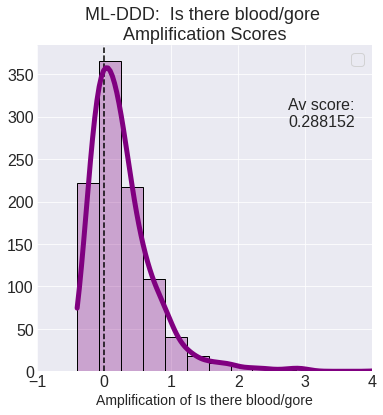

In [20]:
single_warning_amplification("Is there blood/gore", top_pop_amplification_dfs)

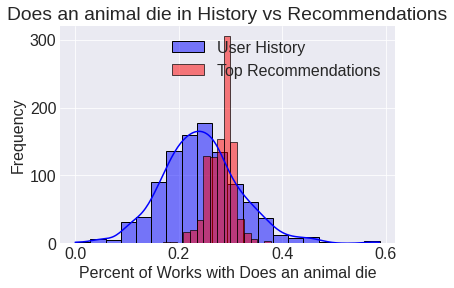

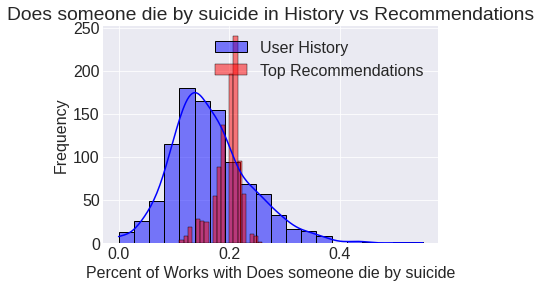

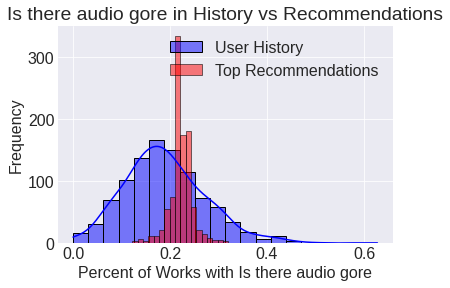

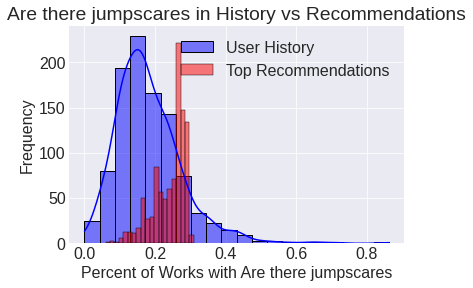

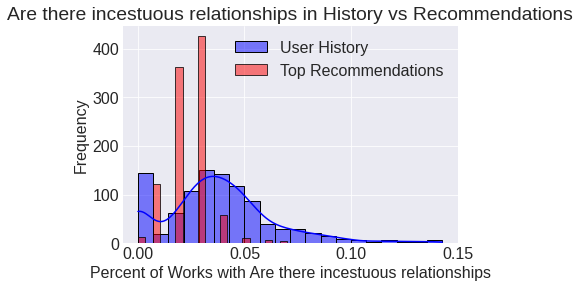

...

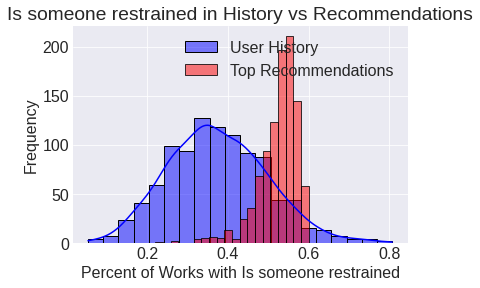

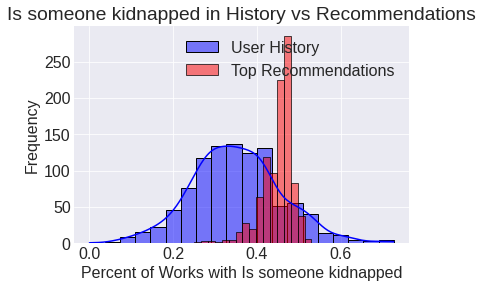

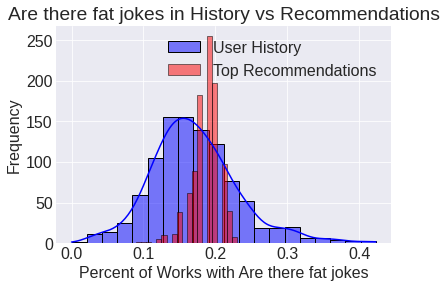

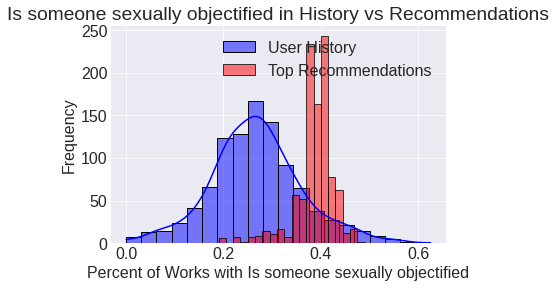

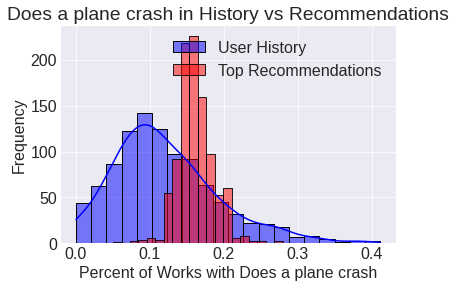

In [21]:
warning_distribution_plots(top_pop_amplification_dfs)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does an animal die: 0.39754929863452365


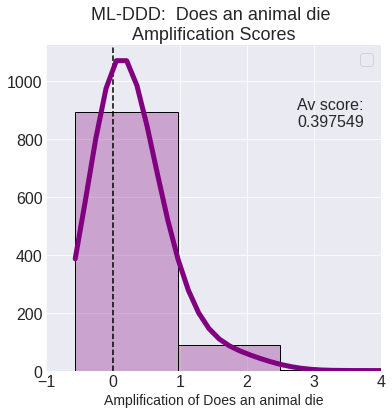

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone die by suicide: 0.6677609385319597


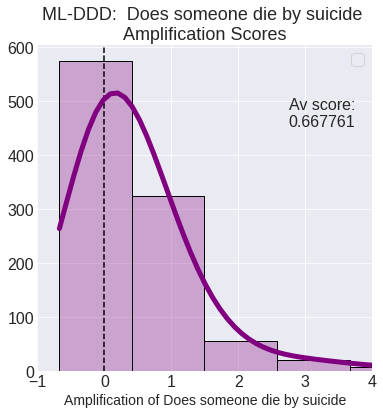

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there audio gore: 0.7717675237507814


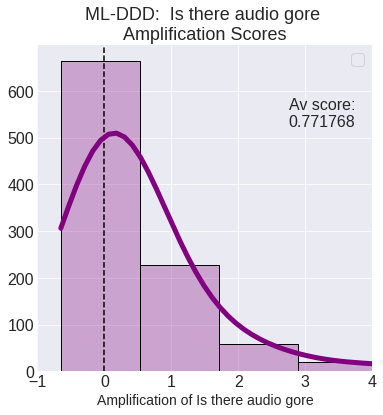

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there jumpscares: 1.045337105841255


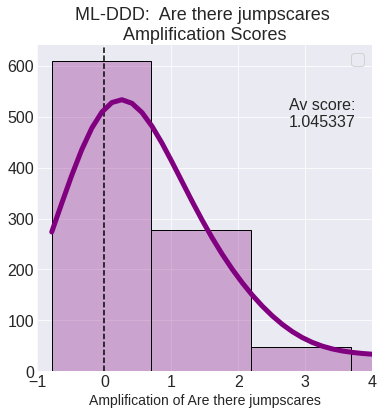

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there incestuous relationships: 0.04828318674347782


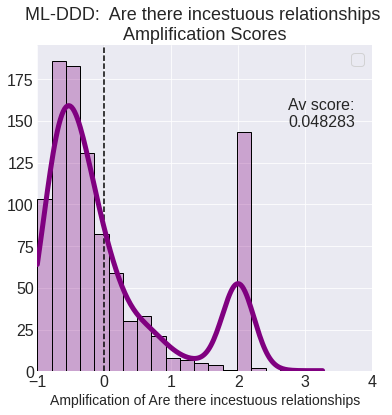

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there shaving/cutting: 0.5055472388294999


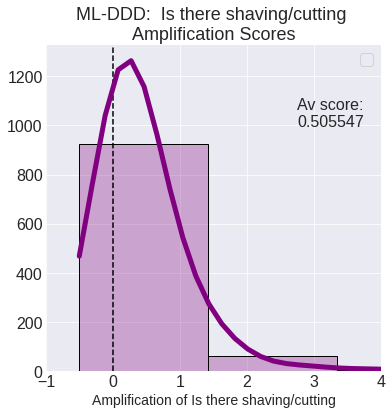

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone abuse alcohol: 0.22756502576170143


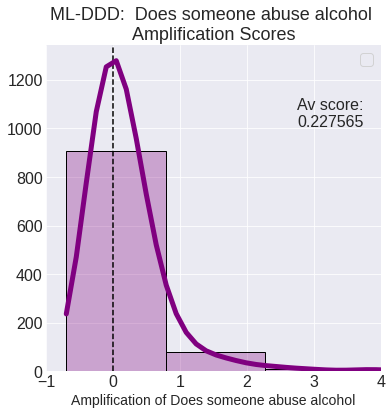

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone use drugs: 0.2992250014701081


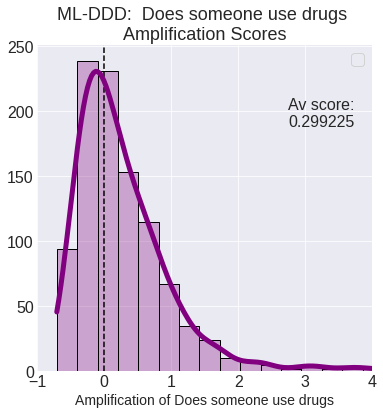

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a car honk or tires screech: 0.6665101602865422


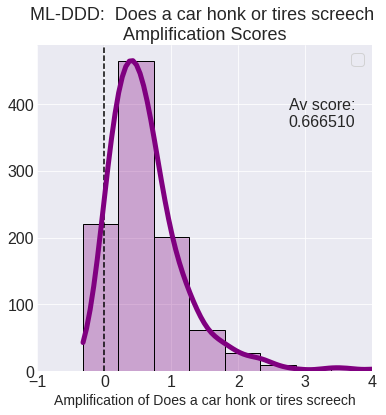

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does it have a sad ending: 0.6985226264557121


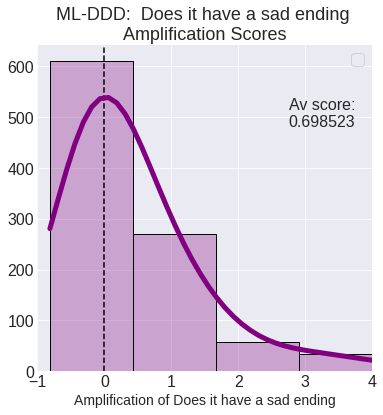

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a hospital scene: 0.2399516122911855


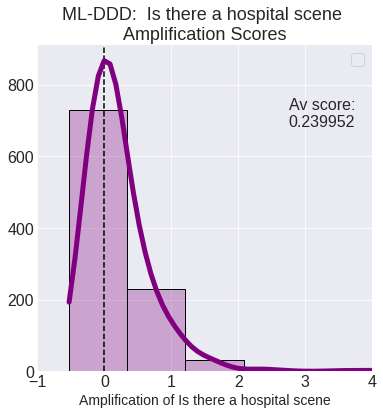

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there ableist language or behavior: 0.6593696864204192


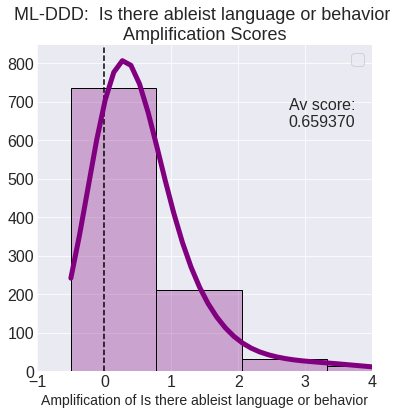

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone burned alive: 0.5856629424638478


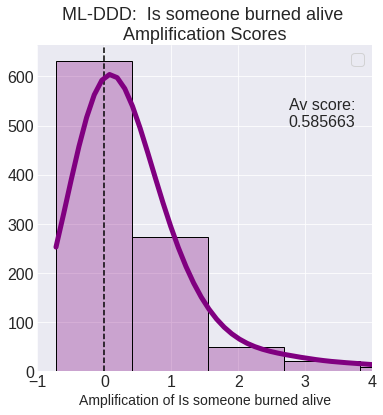

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there copaganda: 1.502092780666837


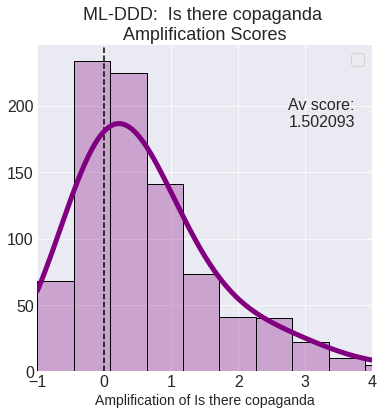

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there anxiety attacks: 0.9954796510401981


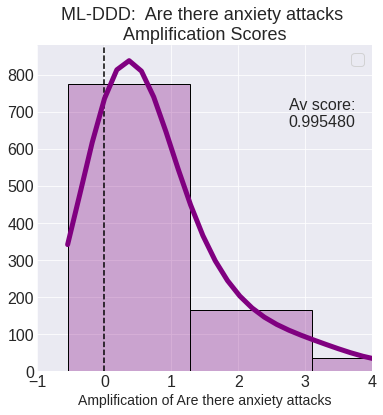

 av amp for Are there abortions: -0.03273394144086905


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


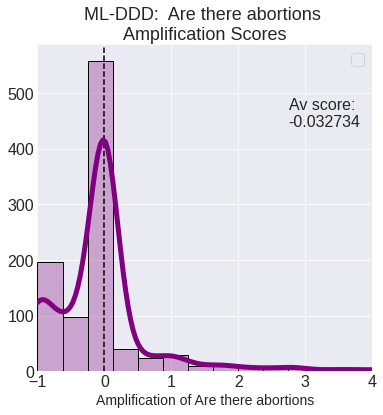

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there sexual content: 0.2494272186733639


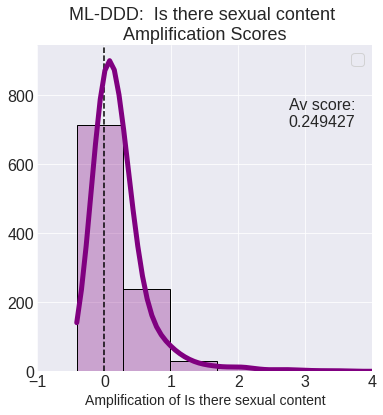

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a child abandoned by a parent: 1.3828817369201132


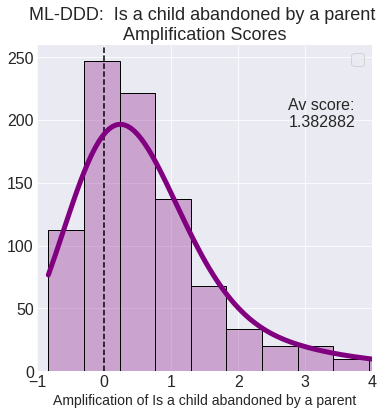

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there bisexual cheating: -0.99238


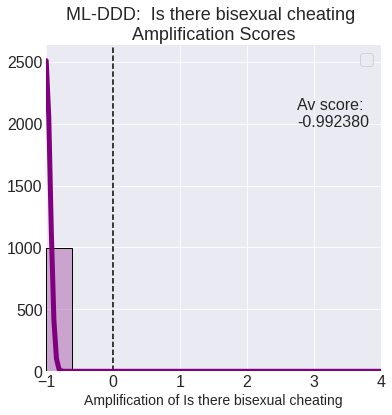

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there eye mutilation: 1.0181483177260757


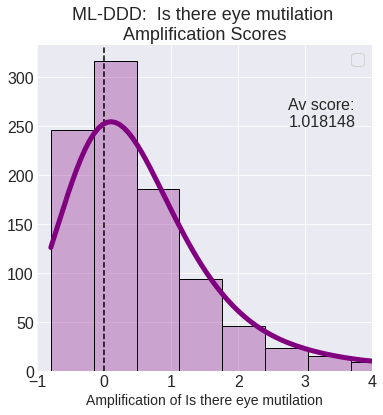

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there dementia/Alzheimer's: 1.0510391037296034


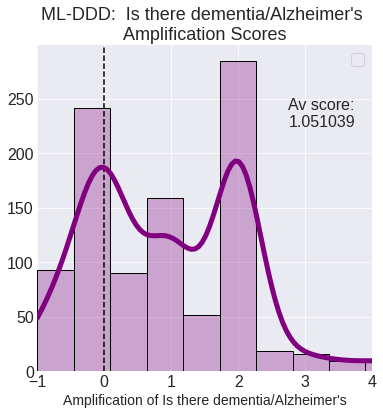

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a head get squashed: 1.0936510023714126


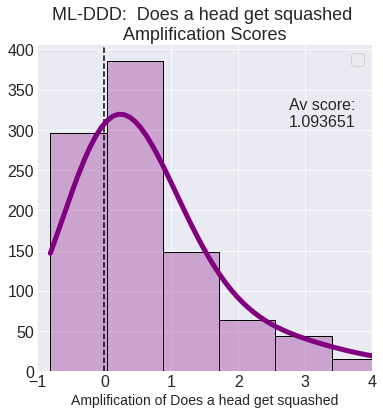

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there blood/gore: 0.2881515170635059


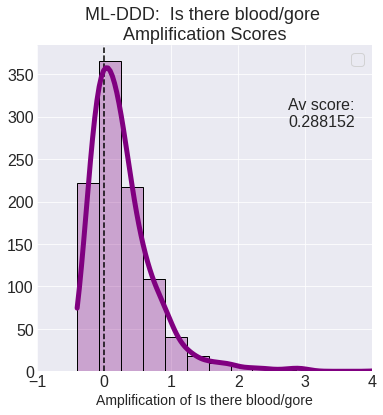

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone crushed to death: 1.4908543053879757


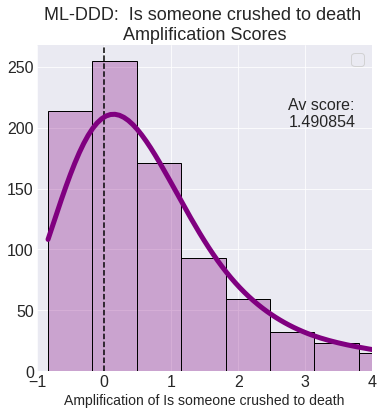

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone becomes unconscious: 1.6264656788018295


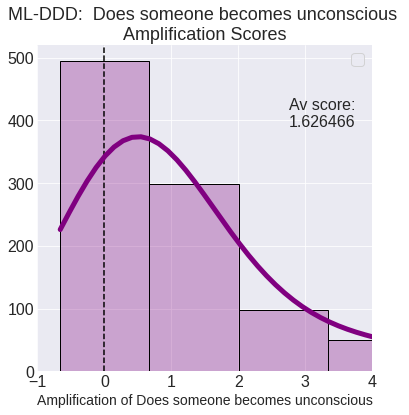

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there dog fighting: -0.33758693086978364


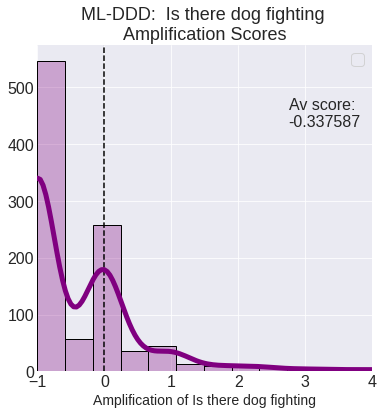

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there bestiality: -0.2586


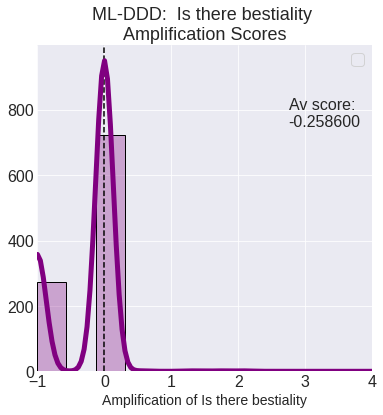

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there finger/toe mutilation: 0.9575508460524446


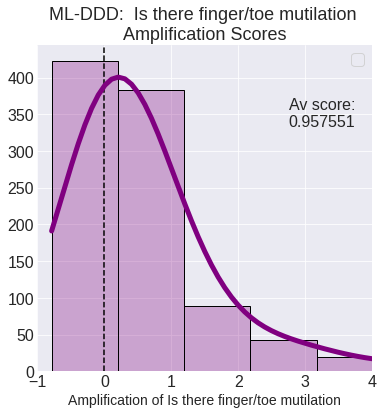

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone suffer from PTSD: 0.9544285249174996


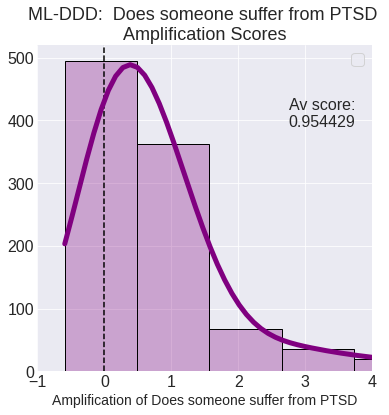

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone fart or spit: 0.5076244885673138


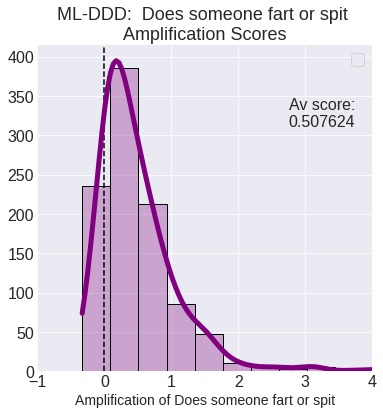

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone drugged: 2.468468318379194


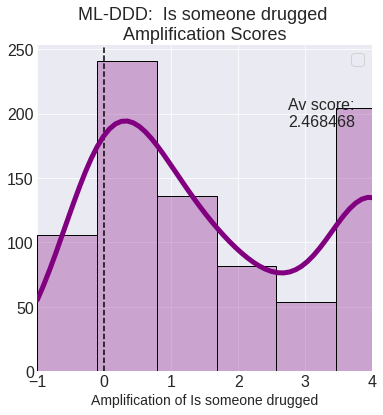

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone drown: 0.5043555084092477


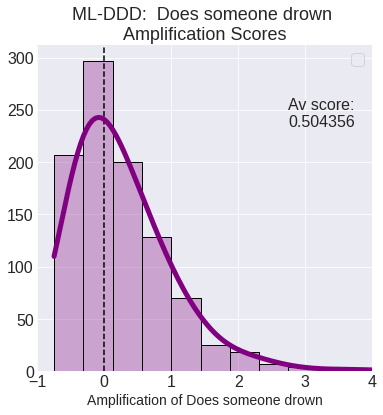

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have an eating disorder: -0.231167638082237


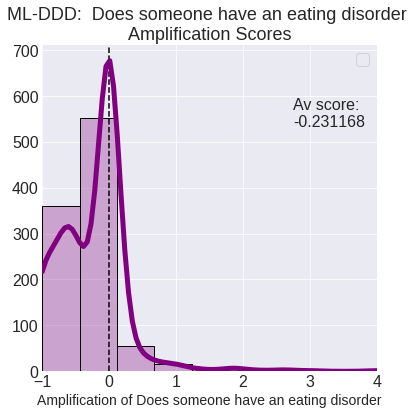

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does the abused become the abuser: -0.2053316666666667


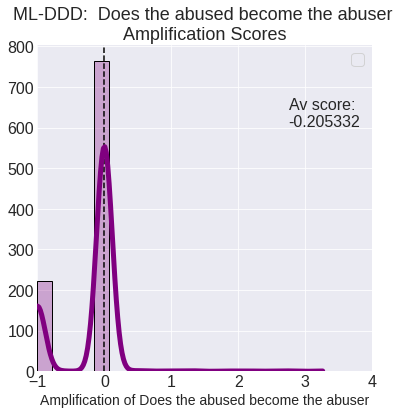

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a parent die: 0.3639603160341813


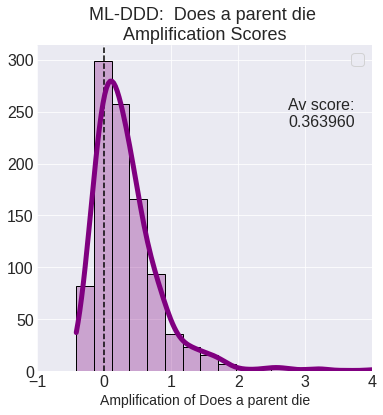

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone buried alive: 0.38257103625220784


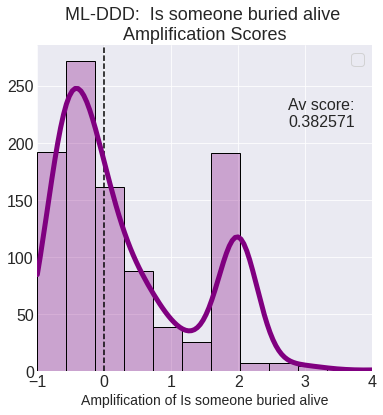

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a minority is misrepresented: 1.6212773230535322


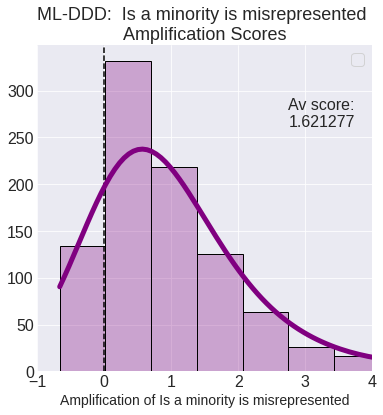

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there obscene language/gestures: 1.2698884479640171


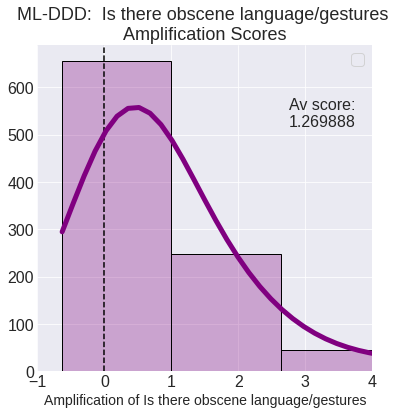

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a hanging: 0.9298608250024741


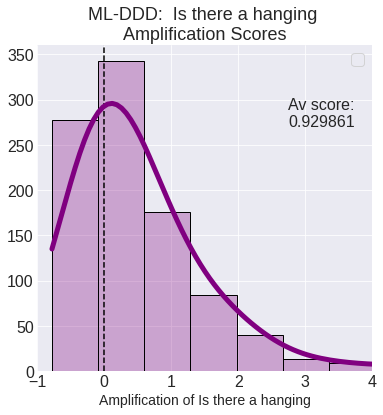

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone cheat: 0.14650433880123942


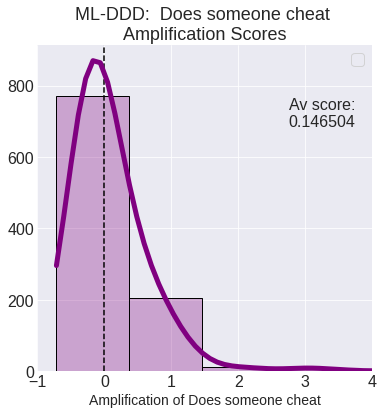

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have a chronic illness: 1.244820942247701


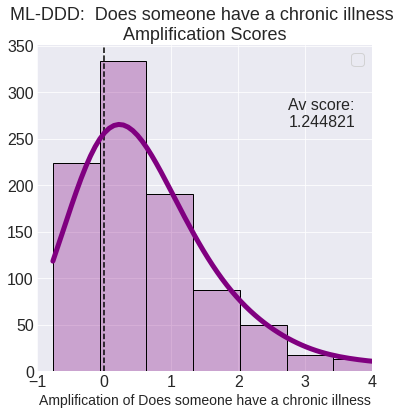

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone fall down stairs: 1.3335559209330095


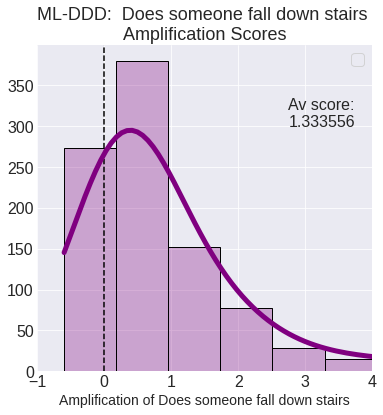

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there flashing lights or images: 0.7562727267853637


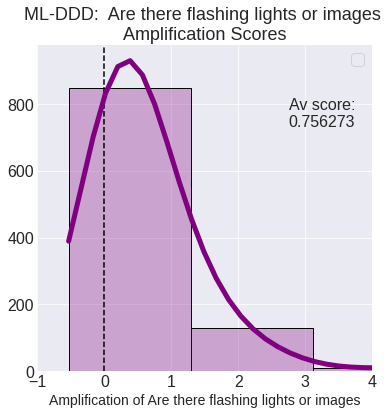

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone say "I'll kill myself": 0.6688707504175535


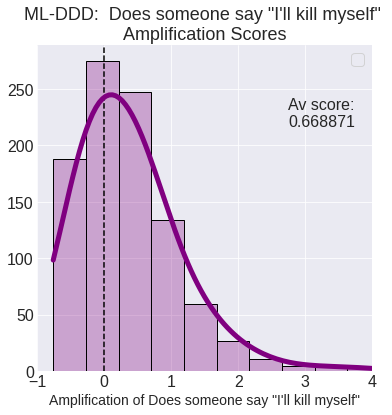

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there snakes: 0.8731183014988517


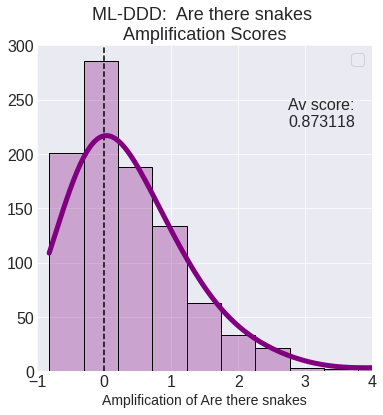

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there hate speech: 0.411096825237987


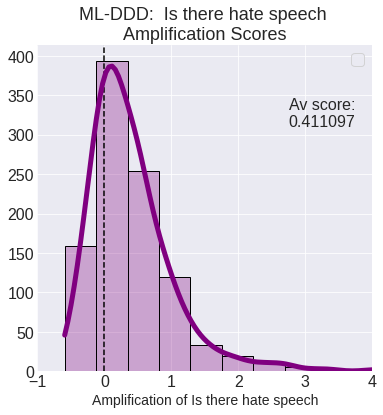

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone vomit: 0.20567206108433


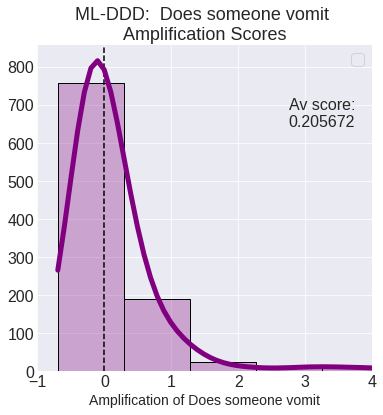

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there gun violence: 0.3239560111868003


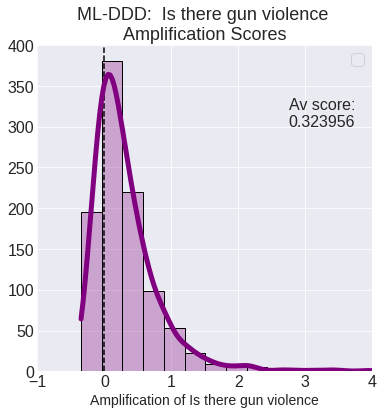

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is the fourth wall broken: 1.9465375219545507


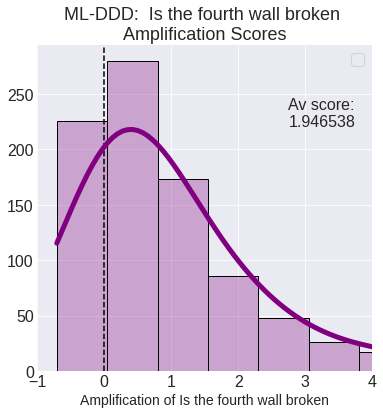

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there body horror: 2.2006658983642695


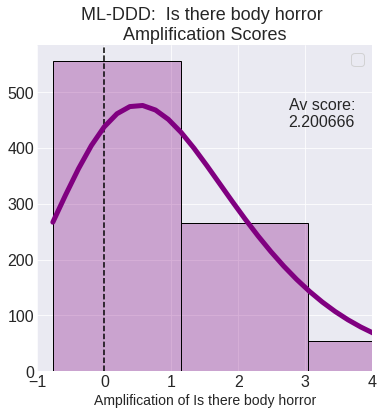

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a horse die: 0.9549664840230696


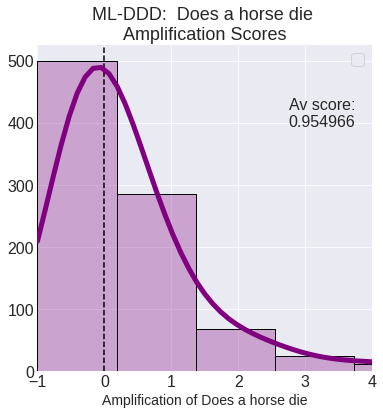

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a shower scene: 0.47077389044110424


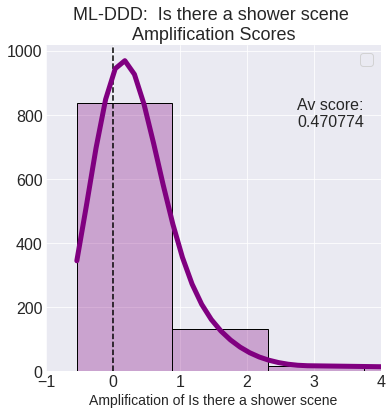

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone self harm: 1.2244344777489564


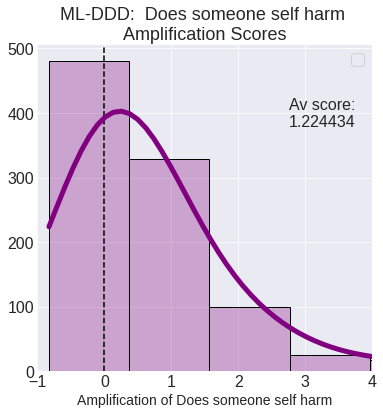

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there childbirth: 0.10184543726623306


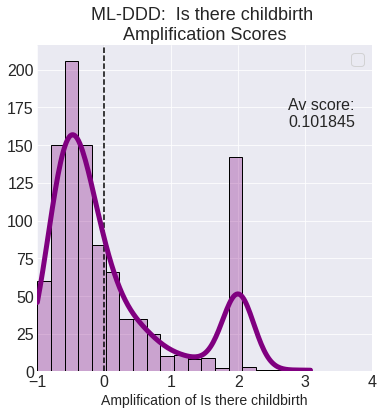

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a nuclear explosion: 1.3749152794017756


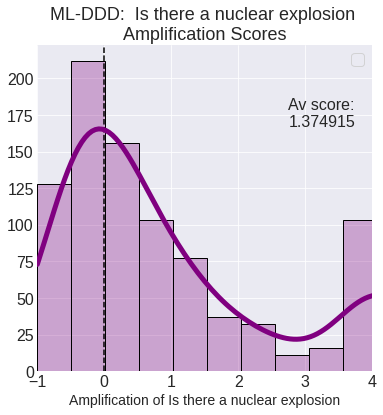

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there autism specific abuse: 0.8218454047336462


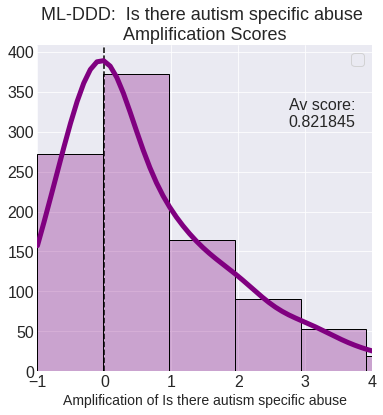

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there cannibalism: 0.2538840371941838


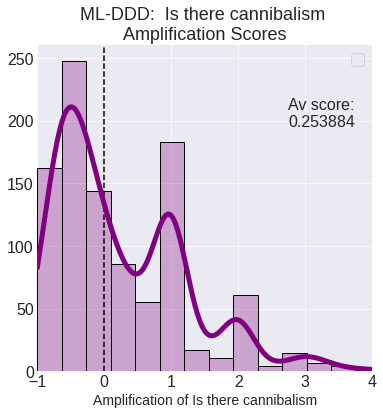

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone misgendered: 0.6320487981205318


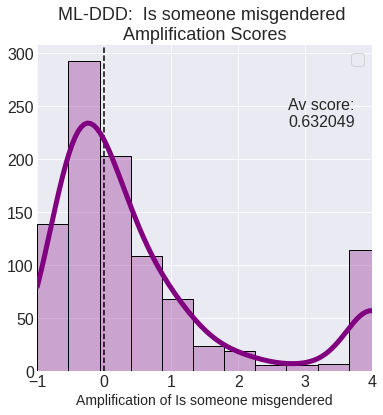

/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there aphobia: -1.0


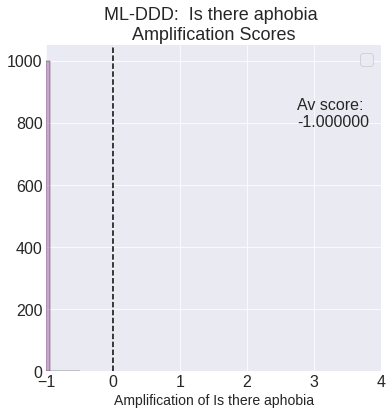

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a cat die: 0.7082778444866151


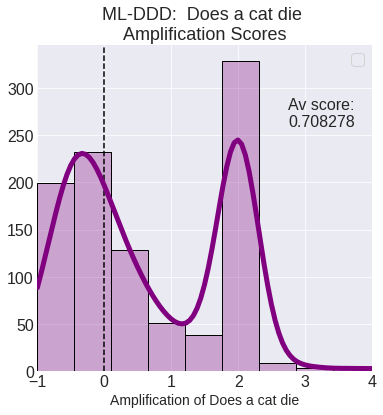

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a dragon die: 0.18308017063492066


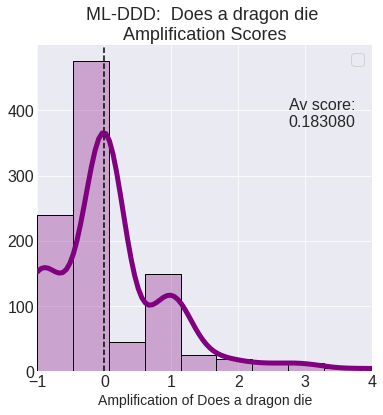

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone overdose: 0.723803305724372


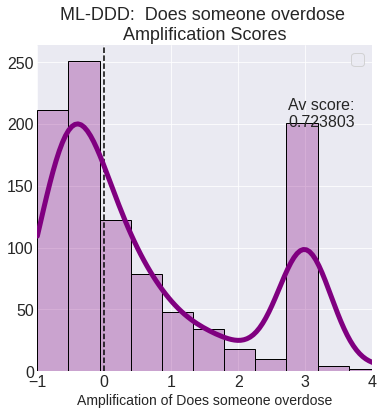

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a mental institution scene: 1.416605971233157


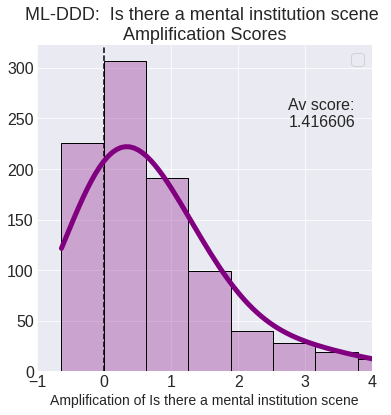

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have a stroke: -0.26716271771284267


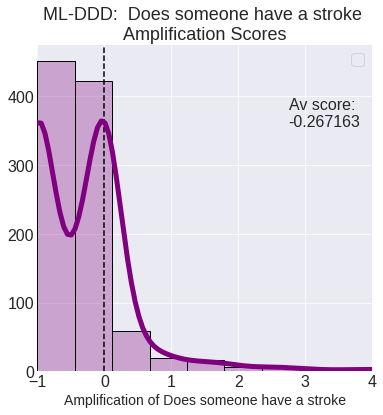

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does an LGBT person die: 0.7541762490142375


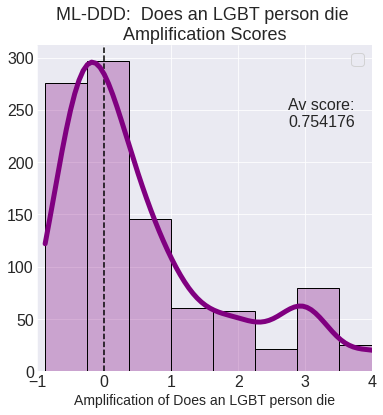

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there body dysphoria: -0.7658050000000001


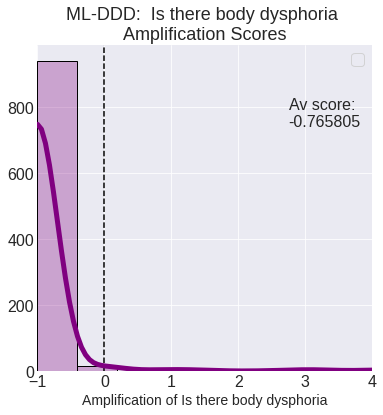

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone struggle to breathe: 0.5341566978092952


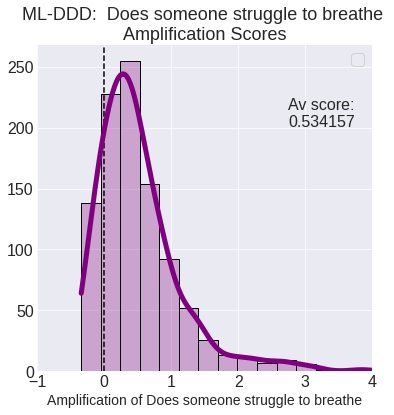

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have cancer: 0.3302905907844089


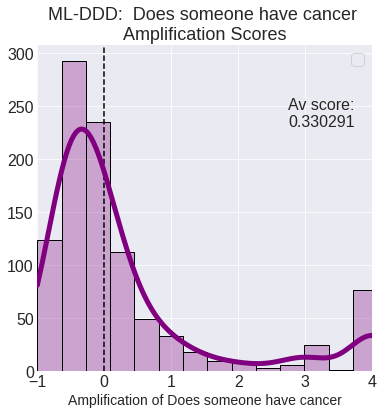

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone fall to their death: 0.7363775283720475


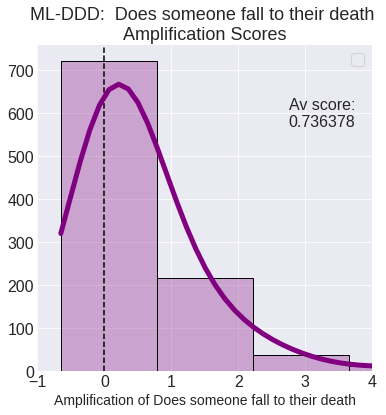

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there ghosts: 1.7170388302843451


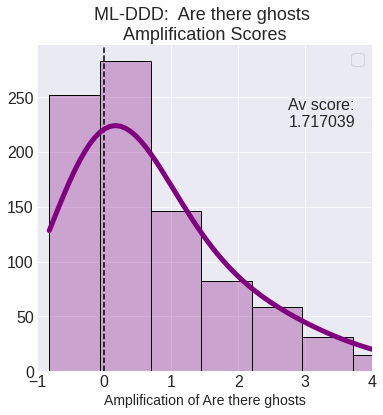

 av amp for Is someone raped onscreen: 0.6853305358178239


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


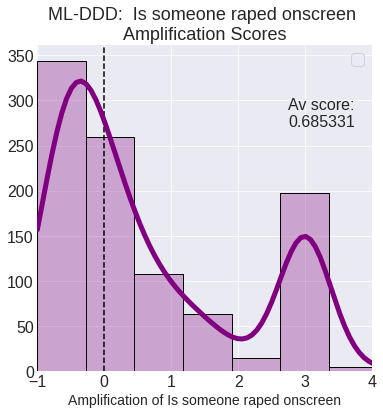

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there babies or unborn children: 0.9007859800392699


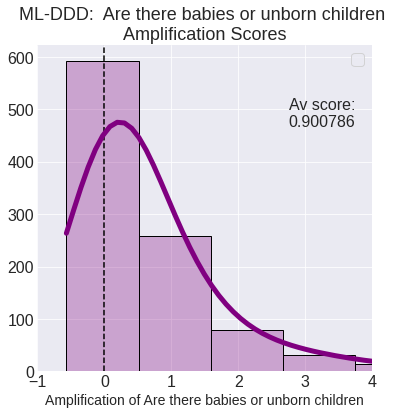

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone asphyxiate: 1.4085559836554722


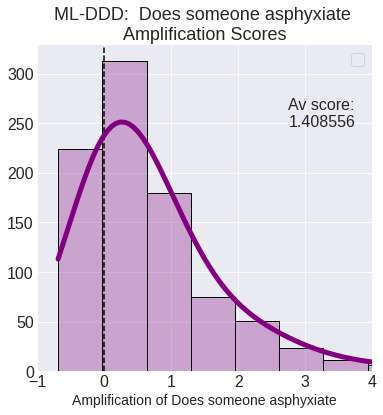

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is the R word used: 1.4859628369450741


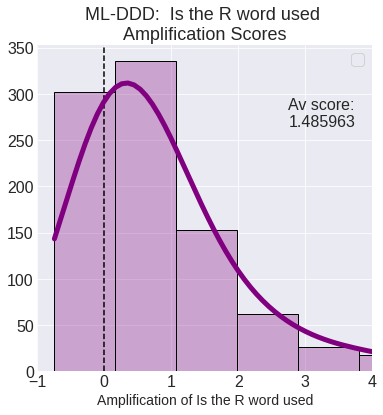

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does the dog die: 0.46264739869529825


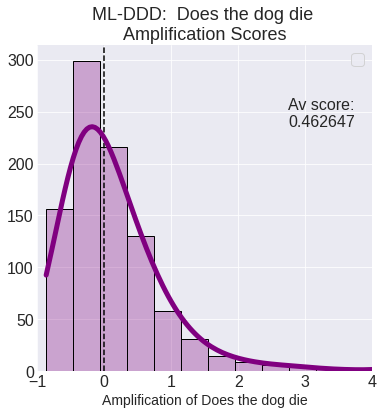

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a baby cry: 0.7598245840458383


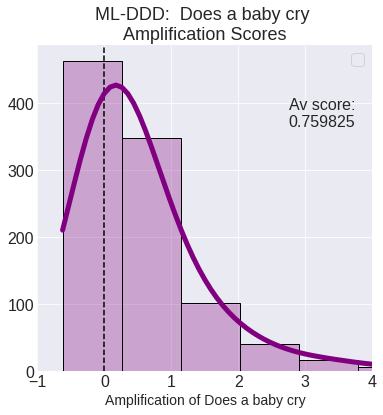

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there bugs: 0.5708350336712948


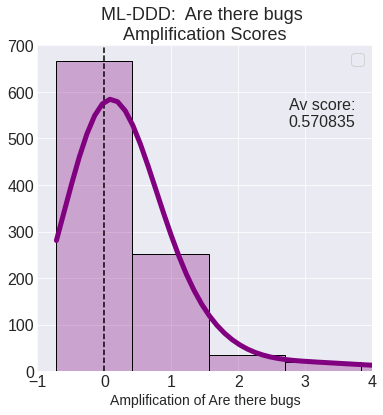

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a non-human character die: -0.16622416666666665


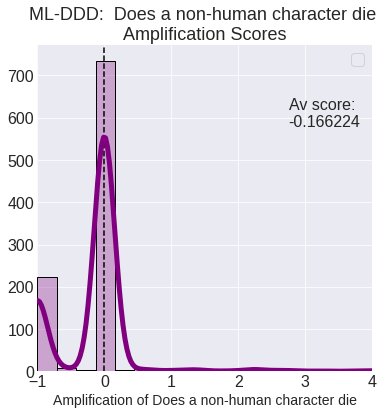

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a minor sexualized: 1.1896983869131772


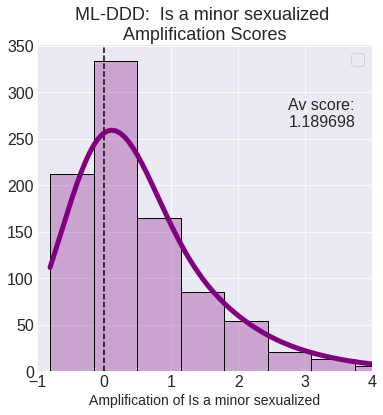

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are needles/syringes used: 0.5252108119969906


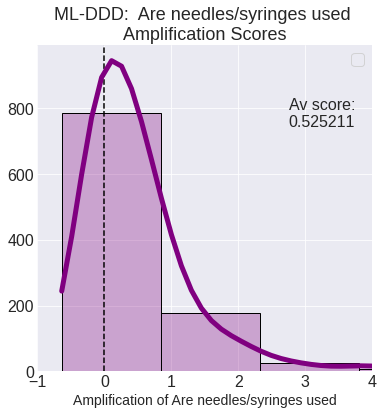

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there nude scenes: 0.7625266558326541


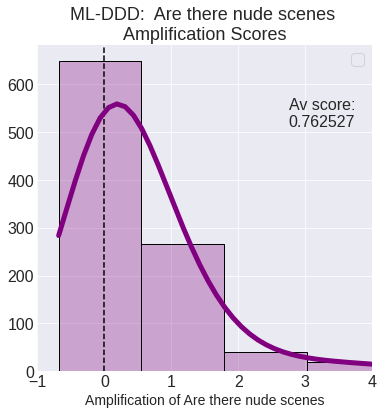

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone tortured: 0.3683130024176335


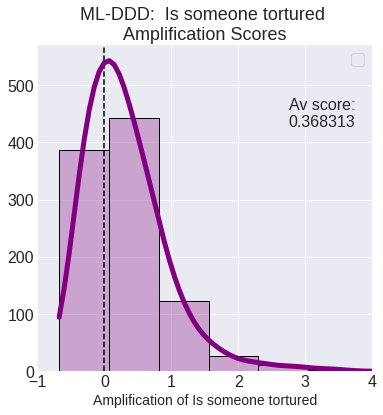

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a kid die: 0.6307588503222129


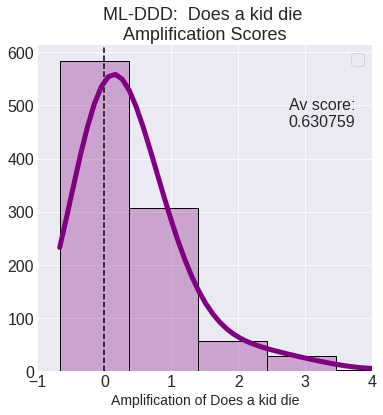

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a pregnant person die: -0.29603319176052717


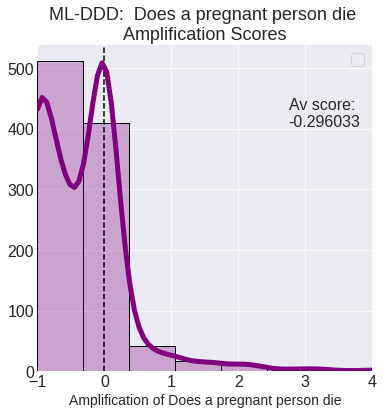

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there homophobic slurs: 0.8849367330423584


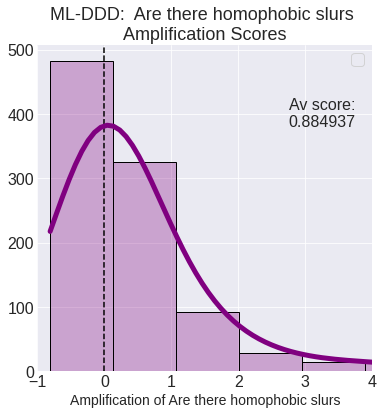

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone break a bone: 0.6292662627979129


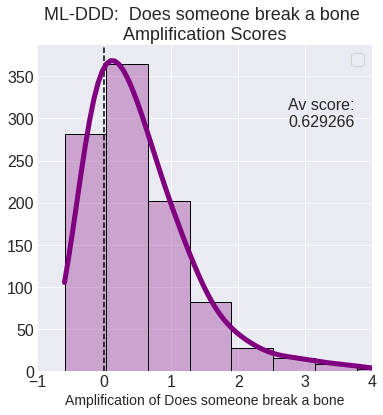

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there n-words: 1.2791433996963046


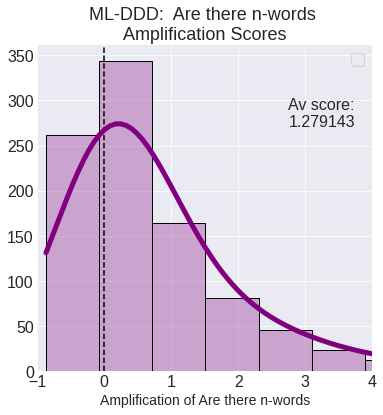

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there addiction: 0.5925766384356562


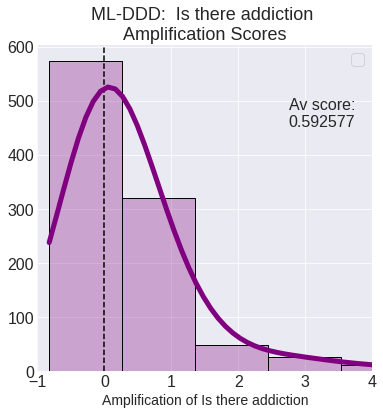

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there shakey cam: 0.7563436249073686


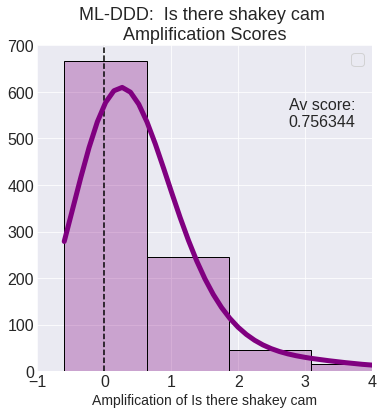

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there body dysmorphia: 0.46060502215572713


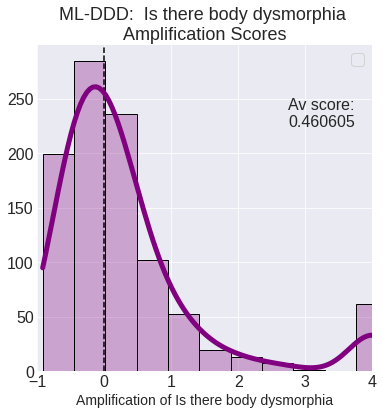

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a dead animal: 0.24376876883395002


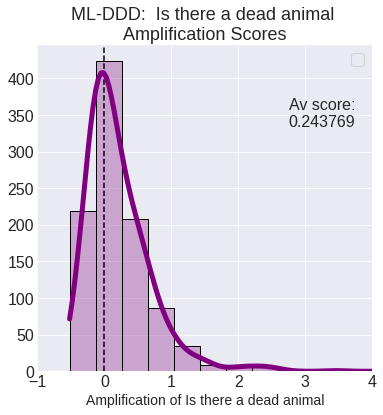

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there clowns: 0.8787879961115325


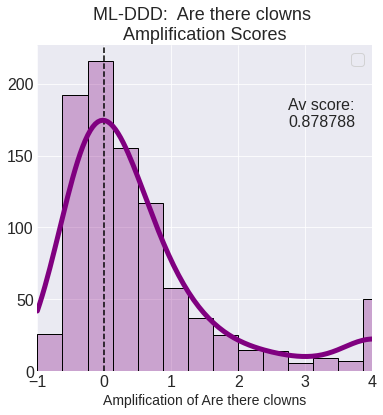

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a mentally ill person violent: 1.234217200833897


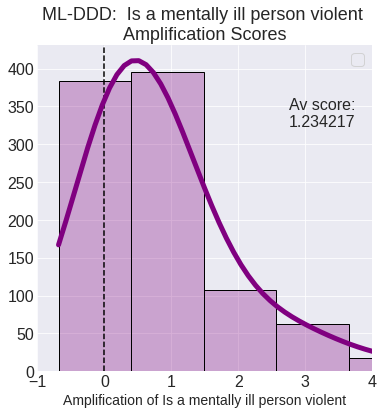

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there spiders: 1.4351171069762965


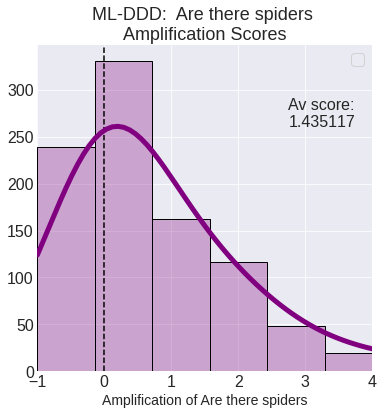

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a child's toy destroyed: 1.642478823941472


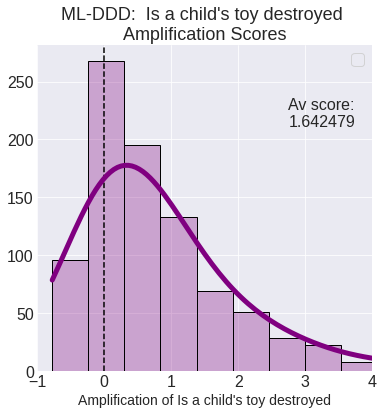

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there mannequins: 2.1079414715358986


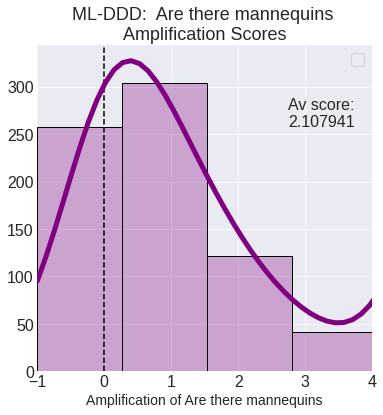

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there Achilles Tendon injury: -0.09741299999999996


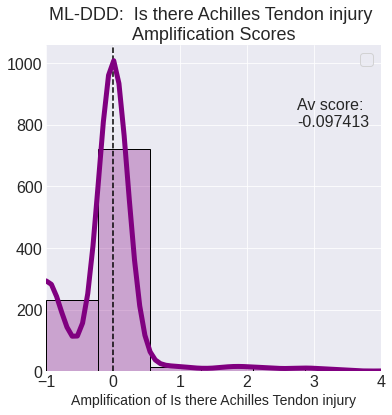

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone stalked: 0.47931207535824866


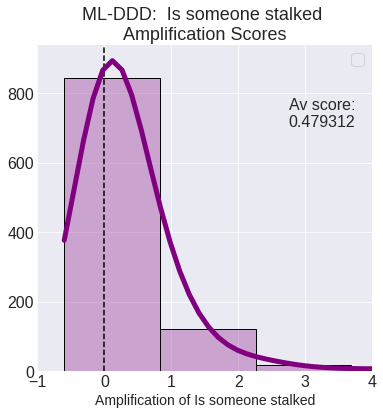

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there D.I.D. misrepresentation: 0.5925826904761907


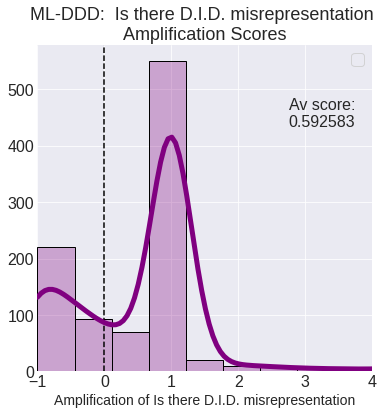

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there 9/11 depictions: 0.5884887619047616


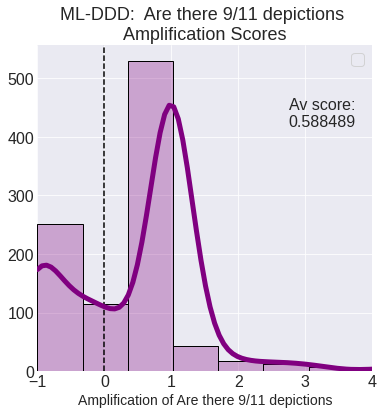

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a child abused: 0.6461972971496643


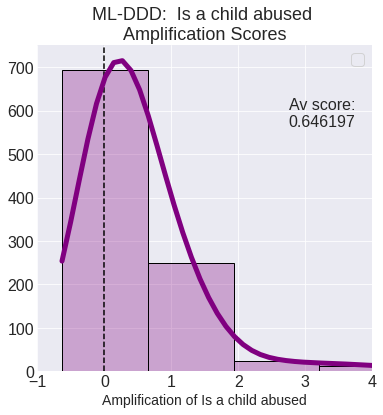

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are animals abused: 0.41200024026487786


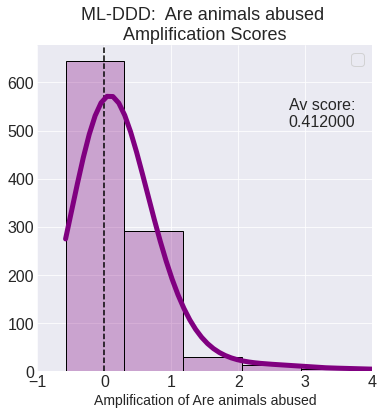

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is an infant abducted: 1.281422754485381


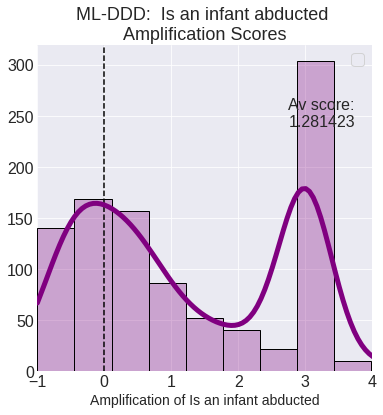

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a large age gap: 0.8318792805665639


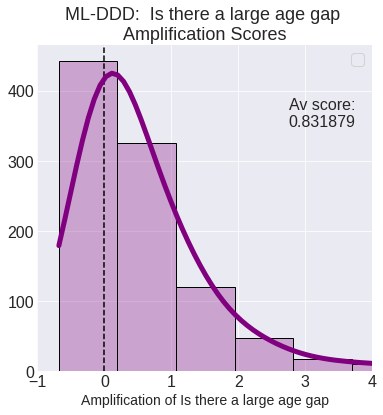

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a claustrophobic scene: 0.6689269684977942


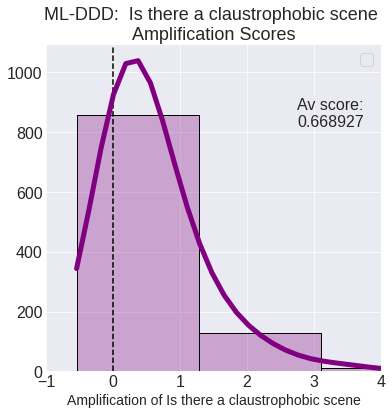

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone miscarry: 0.05883548633169093


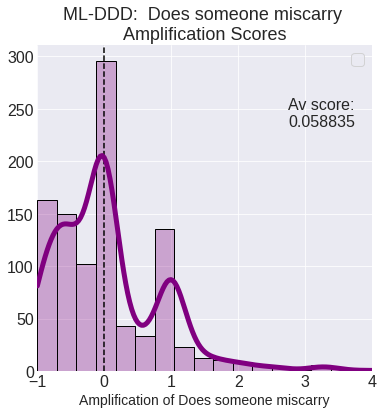

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does the black guy die first: 0.6858958932751358


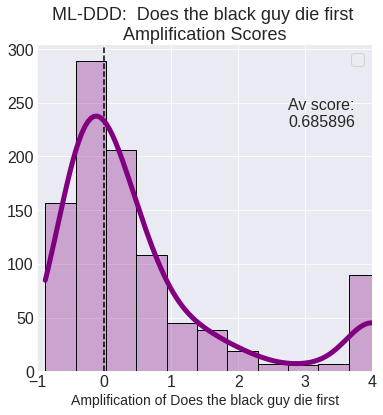

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there misophonia: 1.0675074780754021


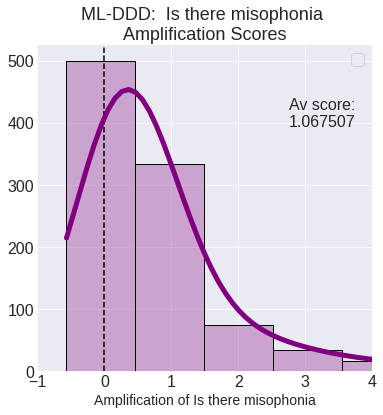

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a pet die: 0.7573723912023079


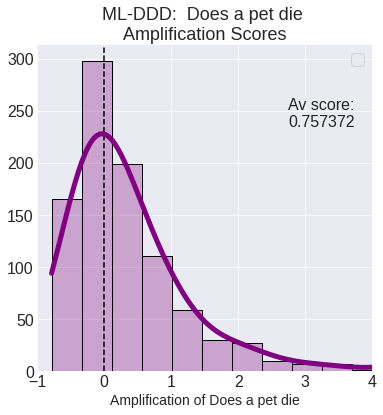

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a baby stillborn: -0.968835


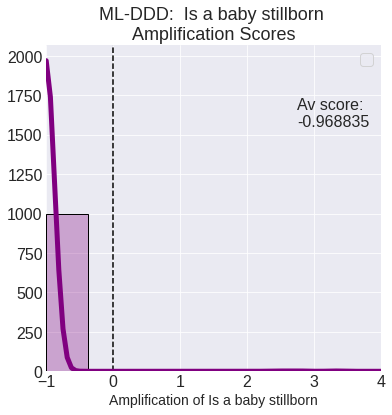

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there "Man in a dress" jokes: 0.8370177314520824


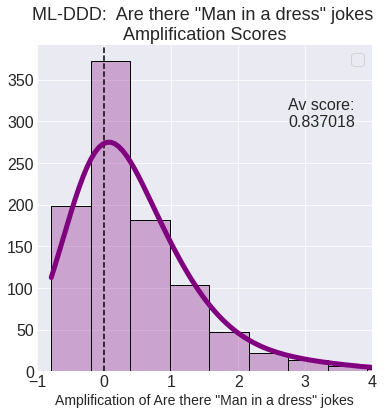

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone hit by a car: 0.3685587161195898


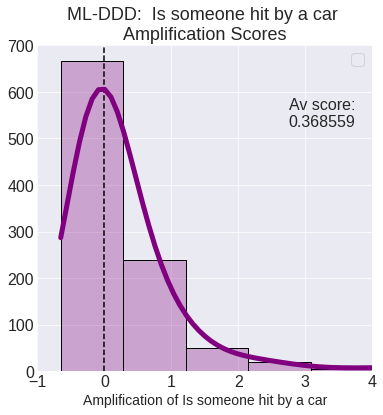

/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is Santa (et al) spoiled: -1.0


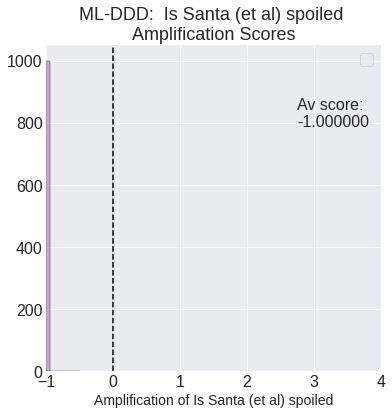

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have a seizure: 2.212936778831727


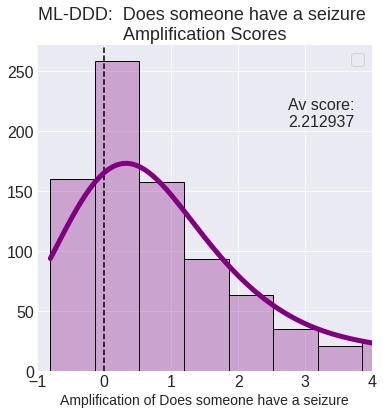

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there domestic violence: 0.6369345964839002


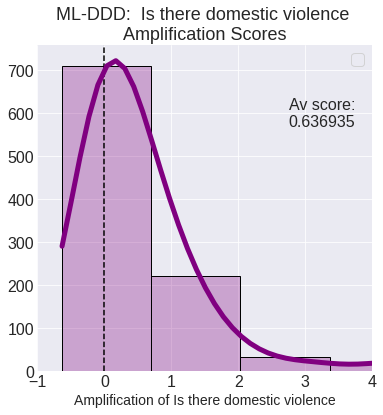

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone possessed: 1.0092833861556407


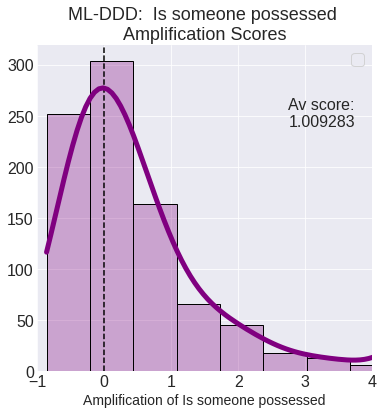

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there amputation: 0.37293153721836153


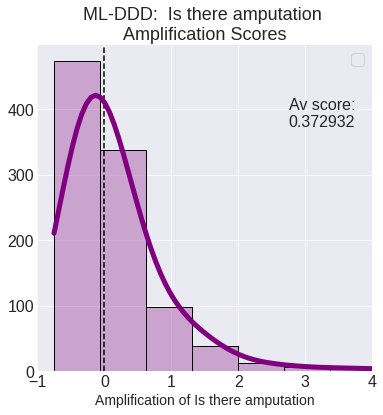

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there razors: 2.0821256007454774


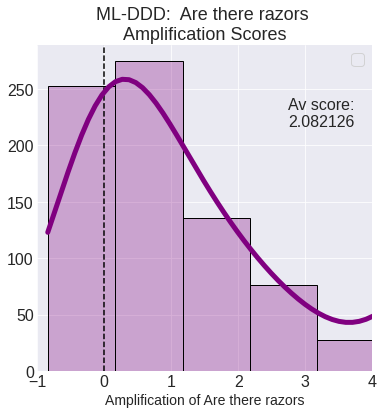

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there genital trauma/mutilation: 0.9860833207078734


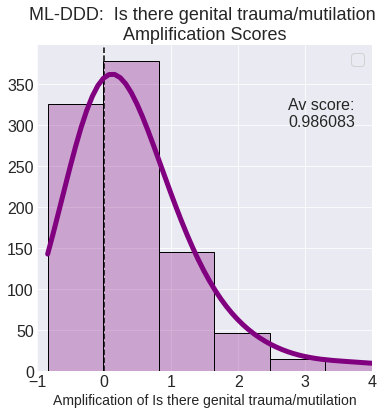

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are any teeth damaged: 1.3556436396432567


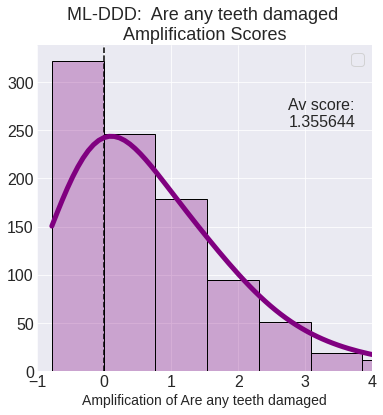

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there antisemitism: 1.1446404026415635


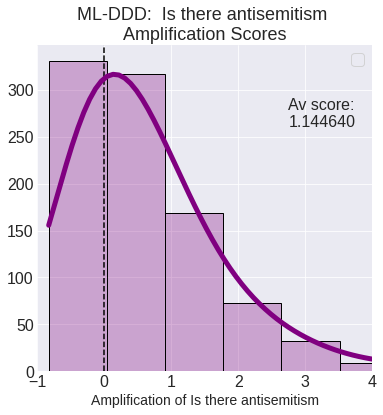

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is electro-therapy used: 2.1871594640367826


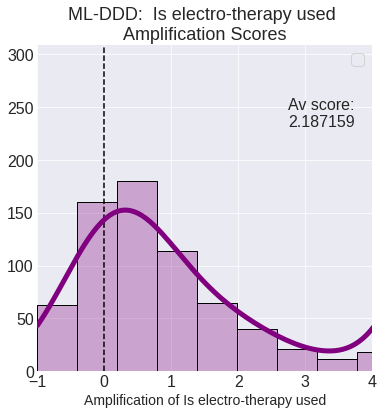

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone gaslighted: 0.509500292067774


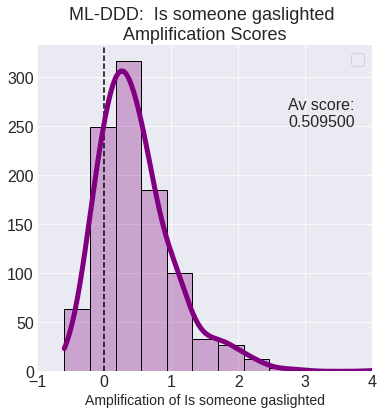

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone wet/soil themselves: 1.725077296487789


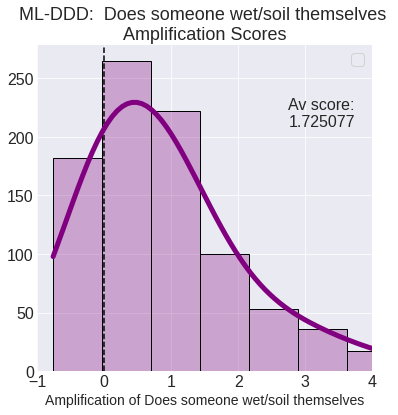

 av amp for Does someone attempt suicide: 1.3985726219738146


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


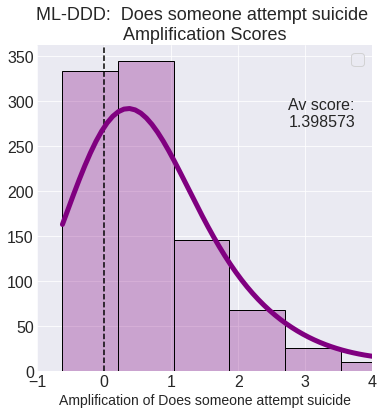

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a male character ridiculed for crying: 0.1805789518362017


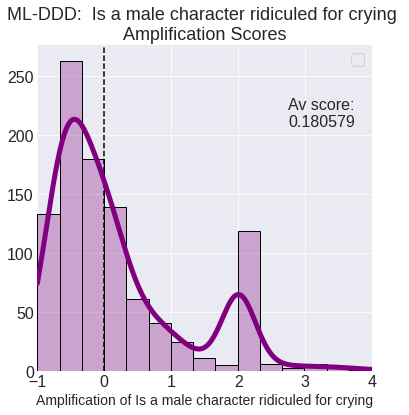

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone sacrifice themselves: 1.8164012386814492


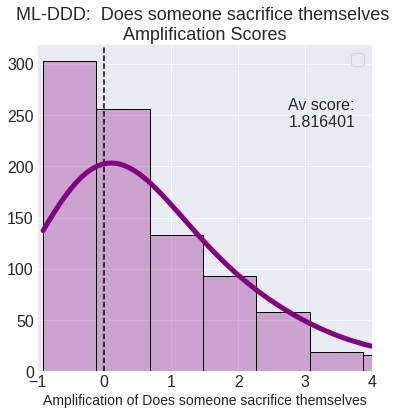

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a car crash: 0.4754362714814953


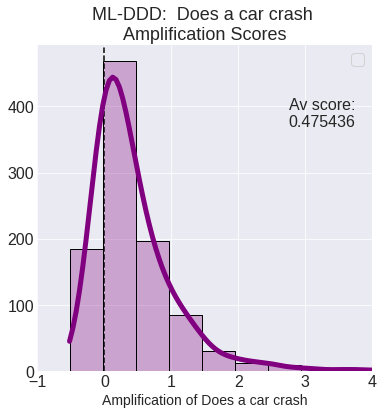

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone sexually assaulted: 0.3255202919101894


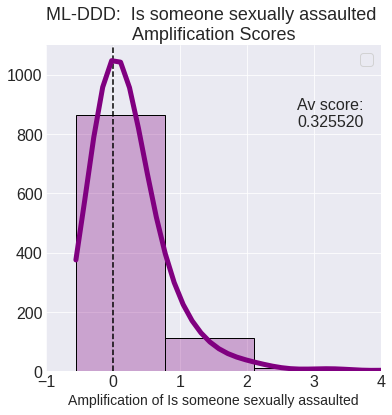

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone homeless: 1.103052768271052


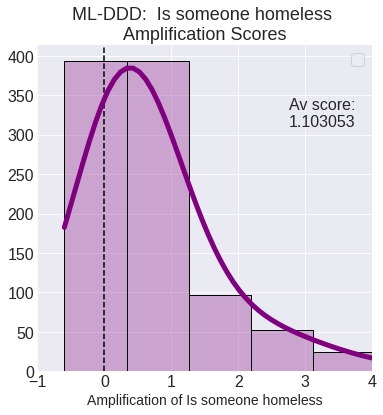

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there fat suits: -0.2895758993783995


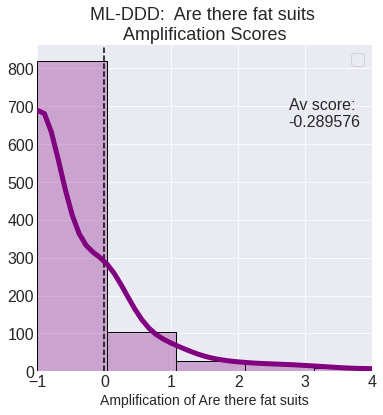

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there excessive gore: 1.3239450404554325


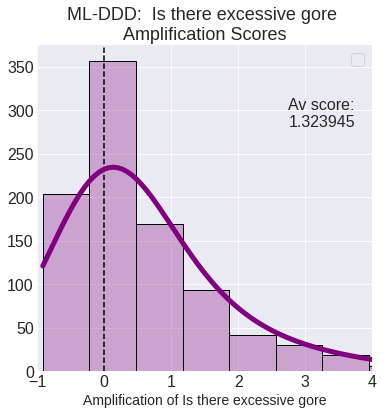

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone restrained: 0.6334291113252273


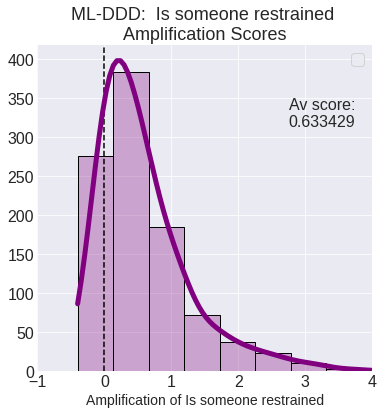

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone kidnapped: 0.5088403062075852


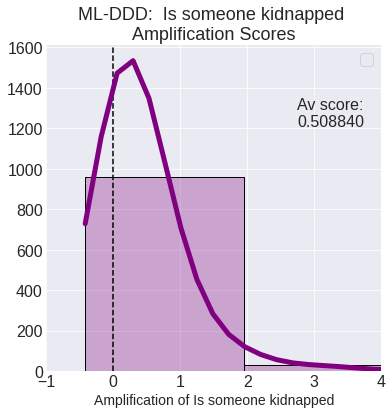

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there fat jokes: 0.3152335274610466


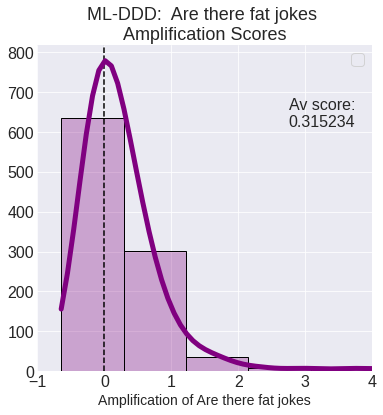

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone sexually objectified: 0.9626599168925221


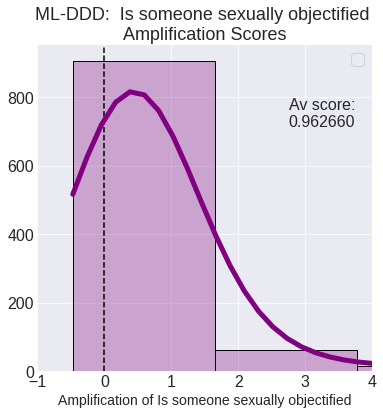

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a plane crash: 1.3968209477107032


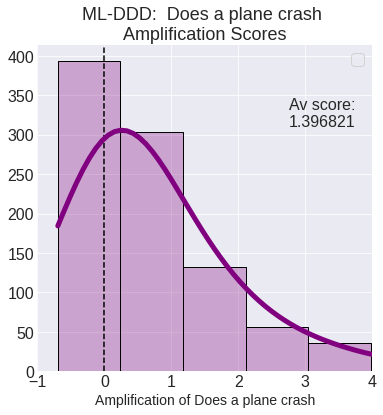

In [22]:
warning_amplification_plots(top_pop_amplification_dfs)

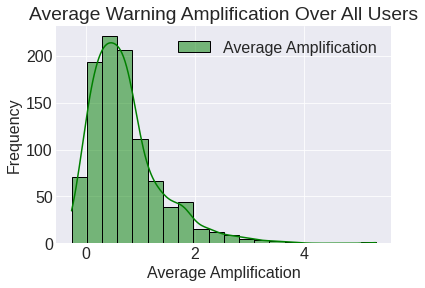

In [23]:
user_amplification_plots(top_pop_amplification_dfs)

### Random Algorithm

In [24]:
random_amplification_dfs = amplification_dfs(random_recs)

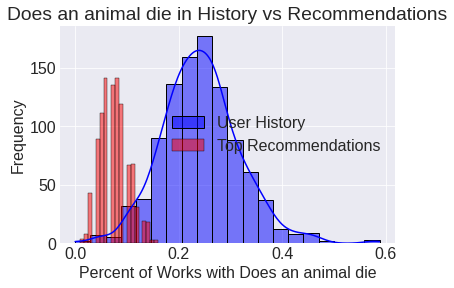

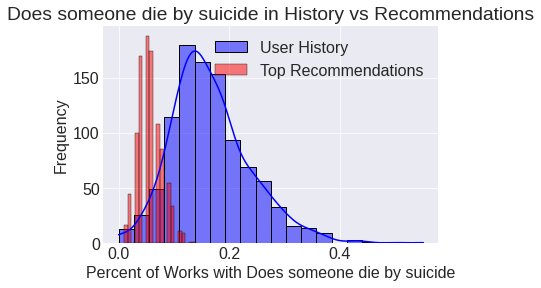

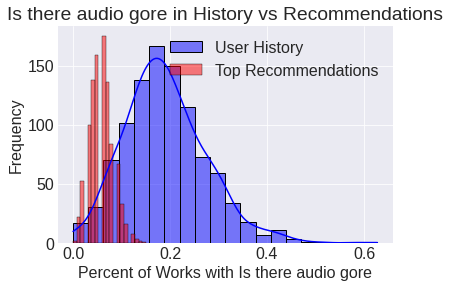

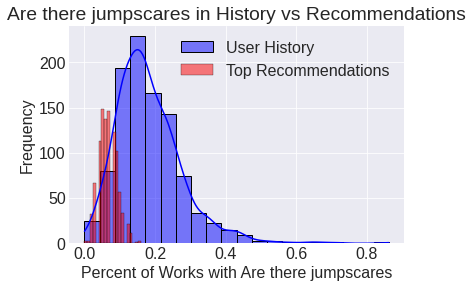

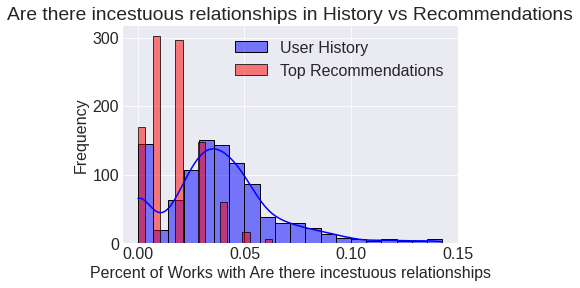

...

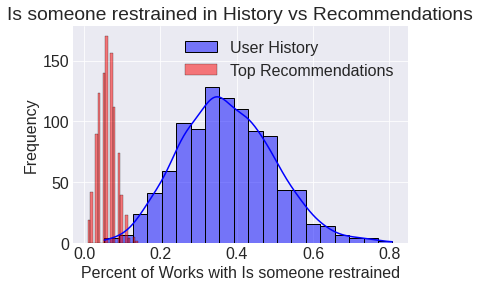

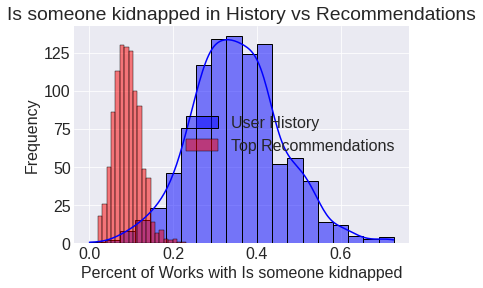

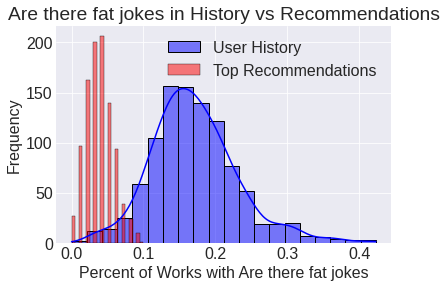

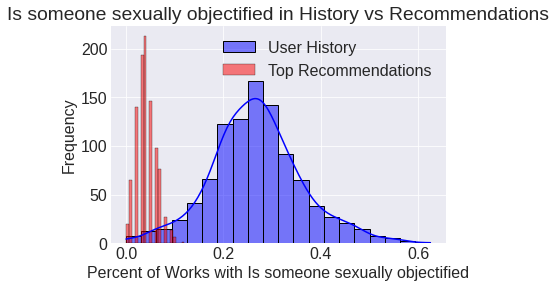

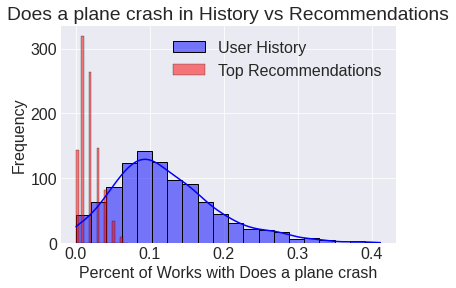

In [25]:
warning_distribution_plots(random_amplification_dfs)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does an animal die: -0.6270209181799162


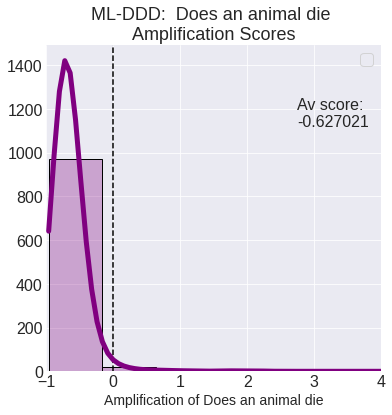

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone die by suicide: -0.5384754865269409


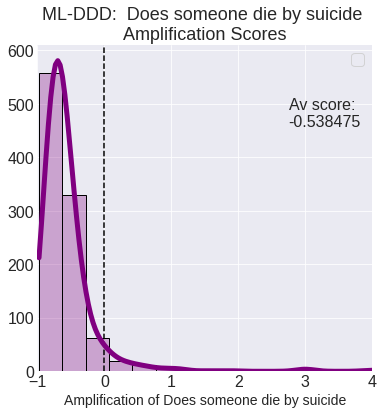

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there audio gore: -0.559228958965197


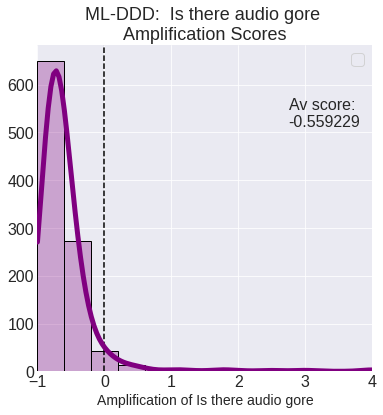

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there jumpscares: -0.4748608788768425


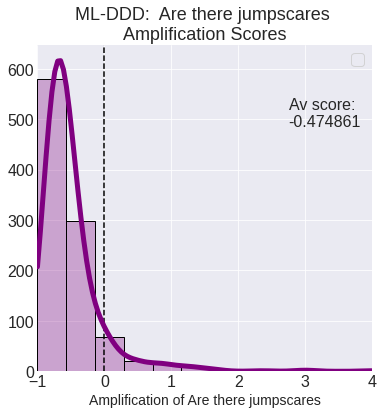

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there incestuous relationships: -0.323227222852346


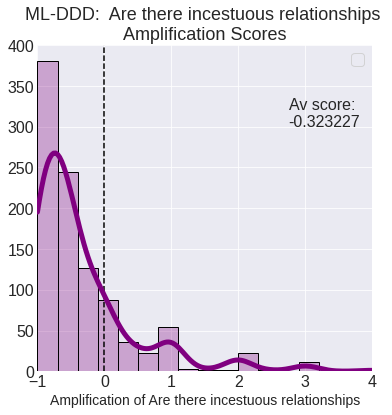

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there shaving/cutting: -0.6593579208209938


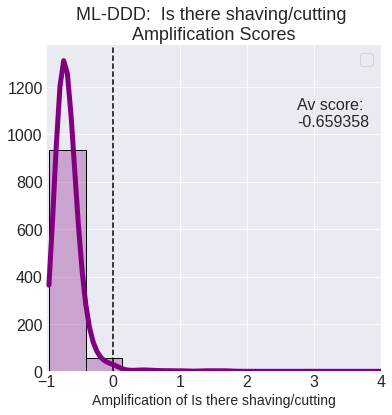

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone abuse alcohol: -0.5557520057790176


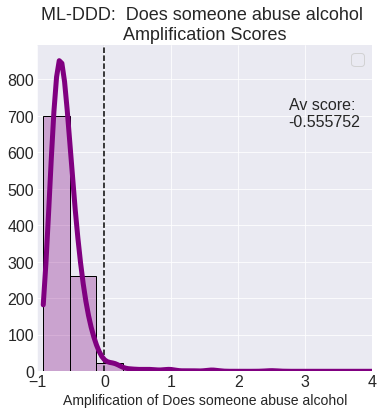

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone use drugs: -0.5606478712849774


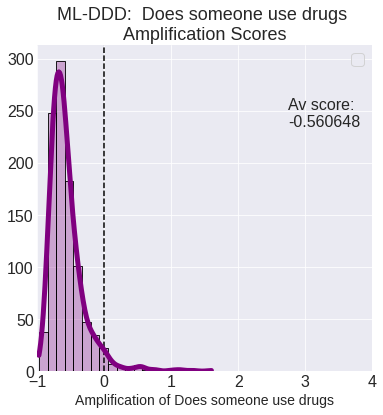

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a car honk or tires screech: -0.829512327775448


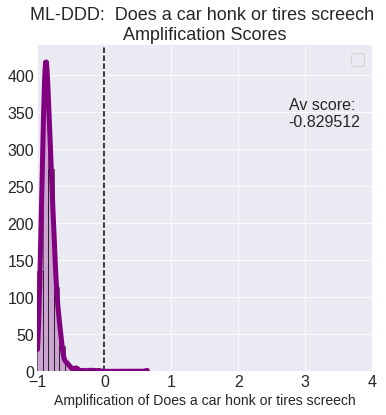

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does it have a sad ending: -0.24651369719820274


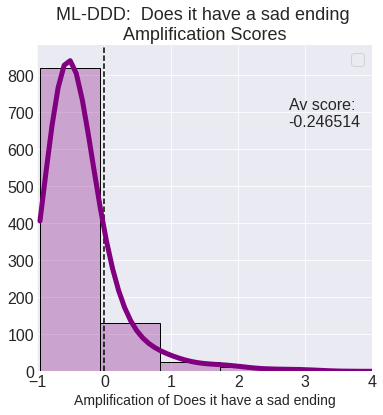

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a hospital scene: -0.6405313618774088


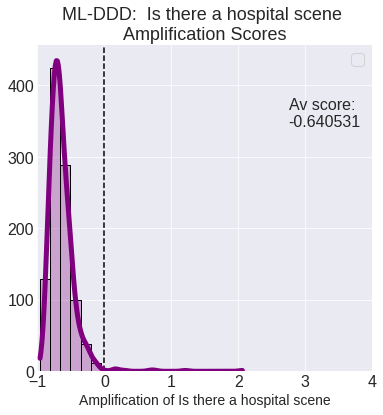

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there ableist language or behavior: -0.685144554004534


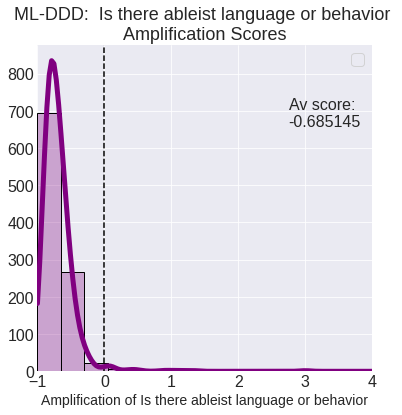

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone burned alive: -0.6744712182988003


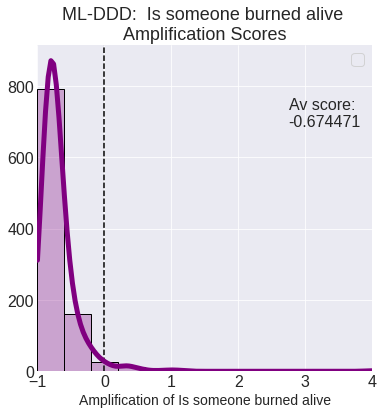

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there copaganda: -0.6246404470131511


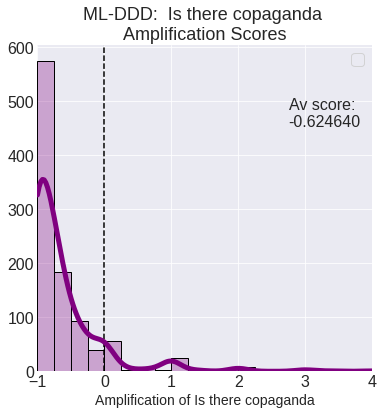

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there anxiety attacks: -0.5820822429929378


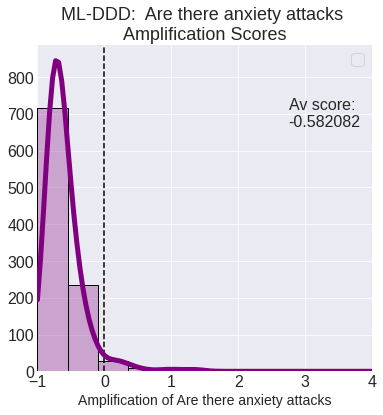

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there abortions: -0.48589347058058907


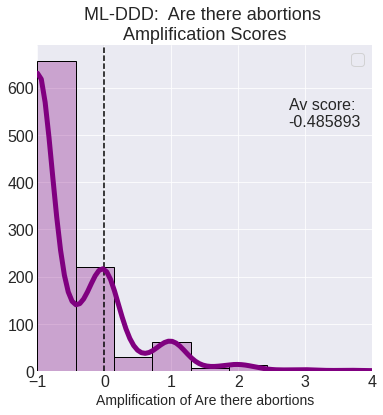

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there sexual content: -0.6222529018783081


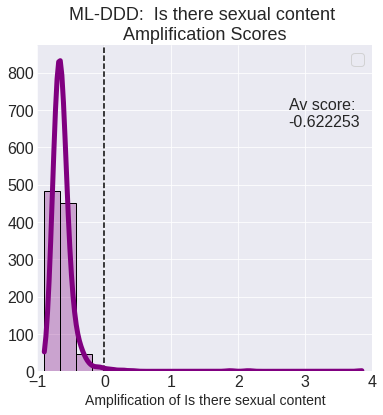

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a child abandoned by a parent: -0.7940691901821565


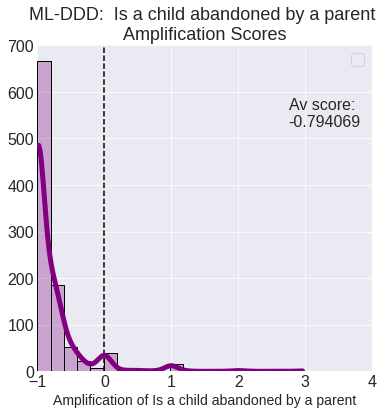

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there bisexual cheating: -0.94049


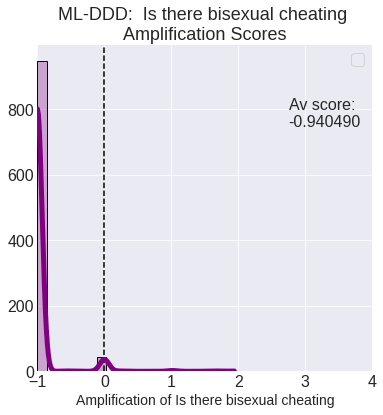

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there eye mutilation: -0.43800816332540365


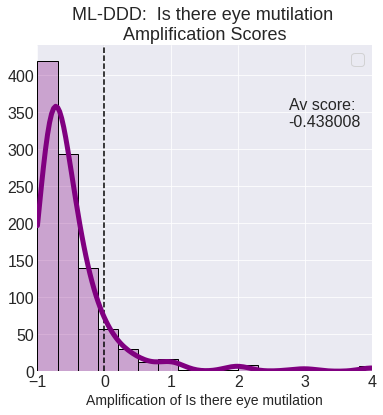

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there dementia/Alzheimer's: -0.8543095238095239


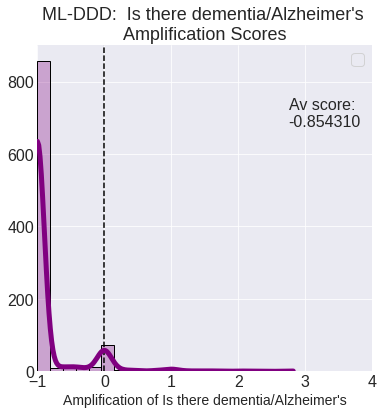

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a head get squashed: -0.5525323748577269


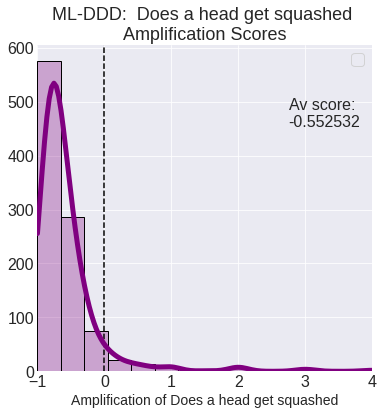

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there blood/gore: -0.6254629676742917


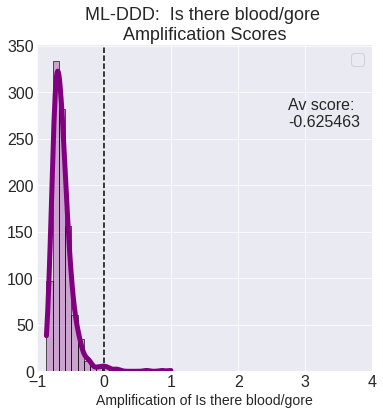

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone crushed to death: -0.7657377840121623


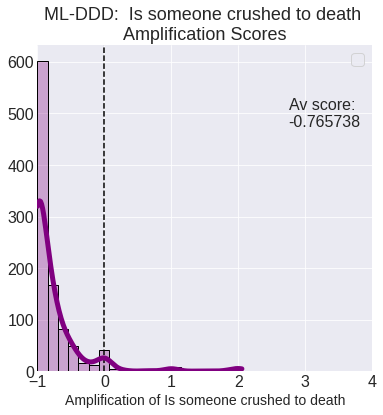

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone becomes unconscious: -0.8167442387540446


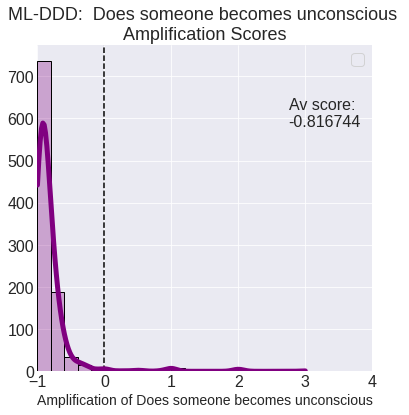

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there dog fighting: -0.653286821895425


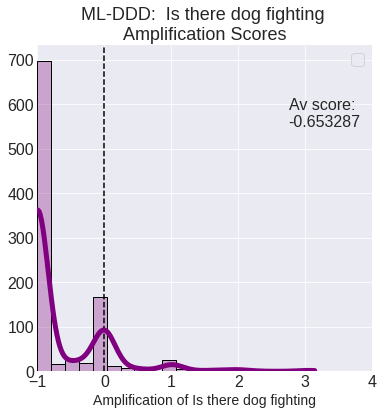

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there bestiality: -0.9895799999999999


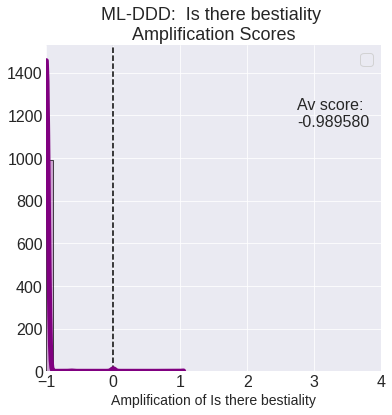

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there finger/toe mutilation: -0.5835232147252811


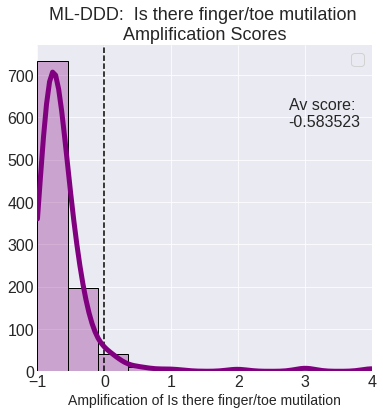

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone suffer from PTSD: -0.7743473905068173


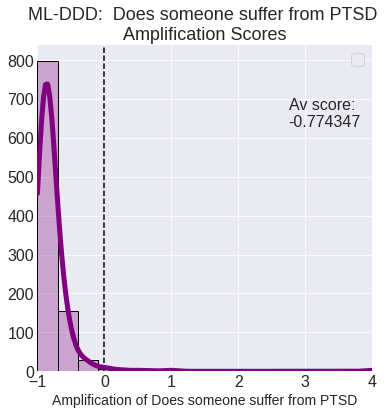

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone fart or spit: -0.7418674334159259


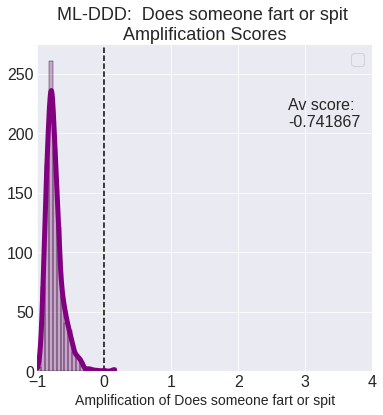

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone drugged: -0.799476086261777


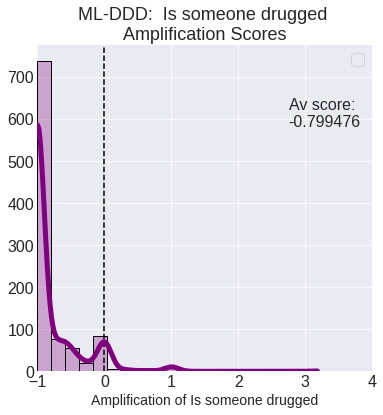

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone drown: -0.4967276094467391


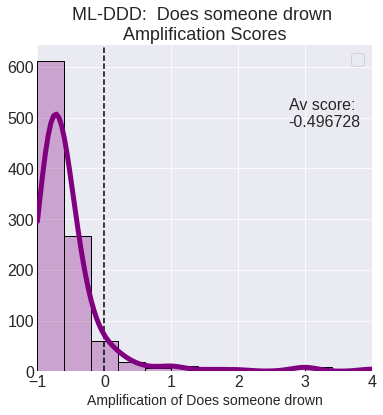

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have an eating disorder: -0.44158239592553794


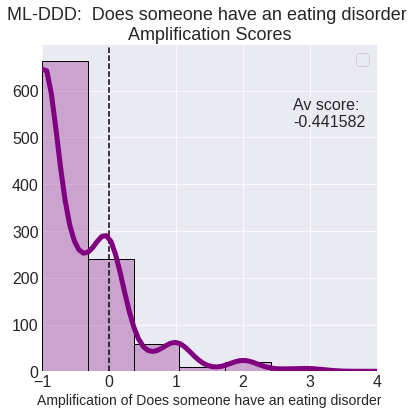

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does the abused become the abuser: -0.981


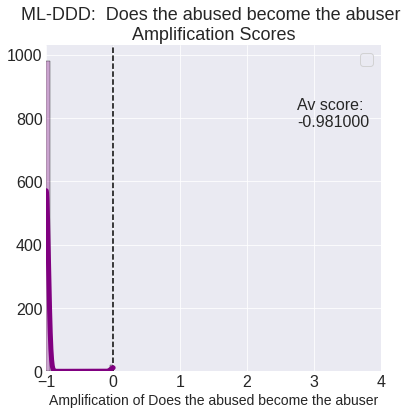

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a parent die: -0.6207258742053006


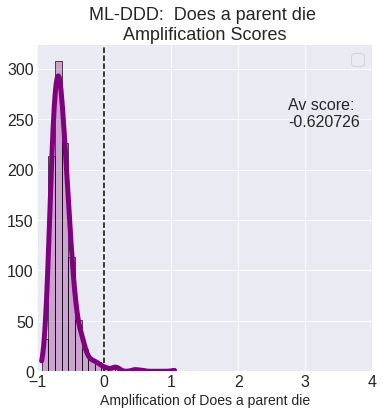

 av amp for Is someone buried alive: -0.49865932354474757


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


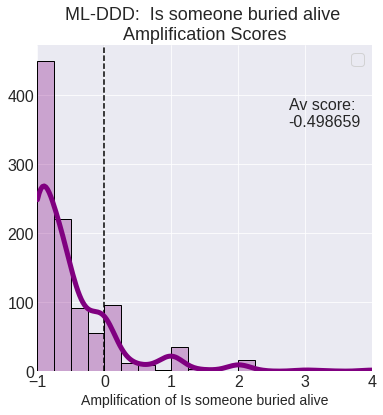

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a minority is misrepresented: -0.8766957370261182


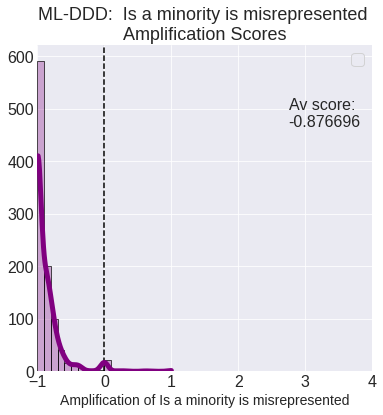

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there obscene language/gestures: -0.8227494027853086


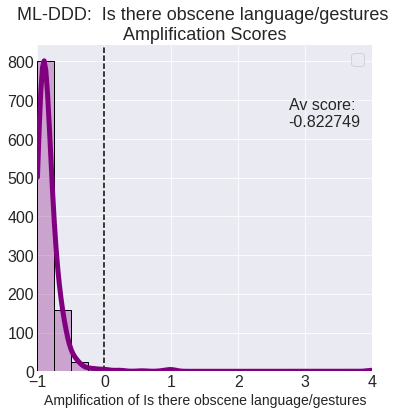

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a hanging: -0.5305436383439378


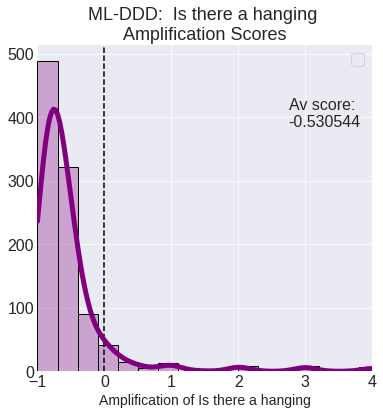

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone cheat: -0.5643603059263665


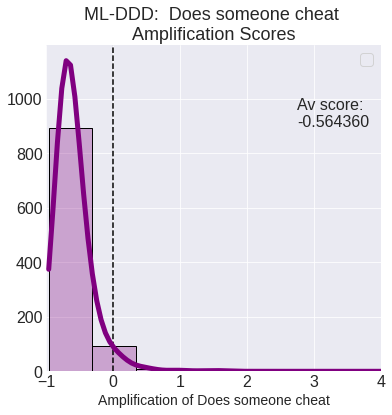

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have a chronic illness: -0.7994898759359466


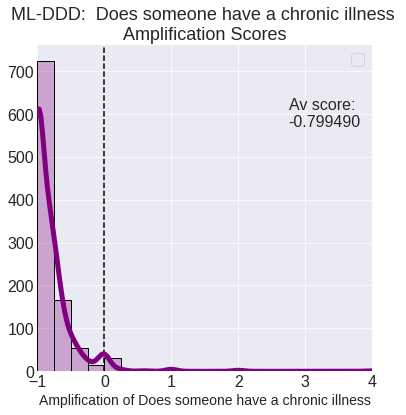

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone fall down stairs: -0.7699303655129155


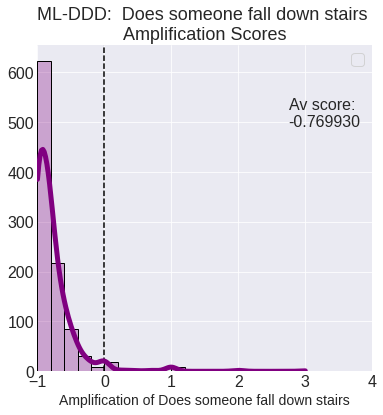

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there flashing lights or images: -0.6252665998783762


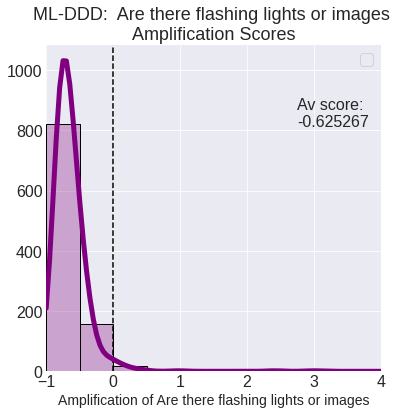

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone say "I'll kill myself": -0.677136235390835


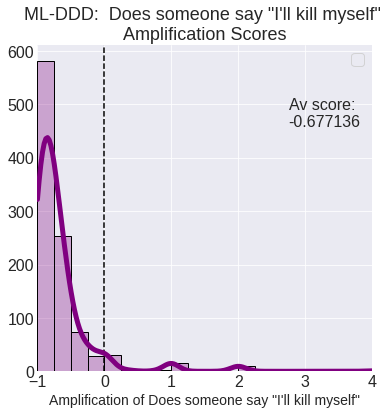

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there snakes: -0.5932208151982228


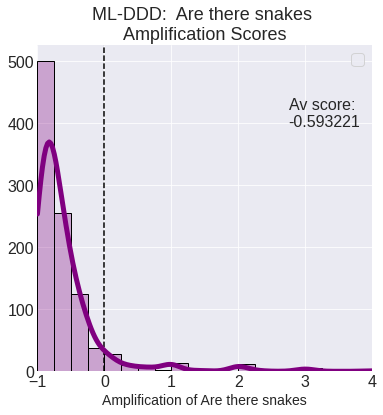

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there hate speech: -0.7140056886597663


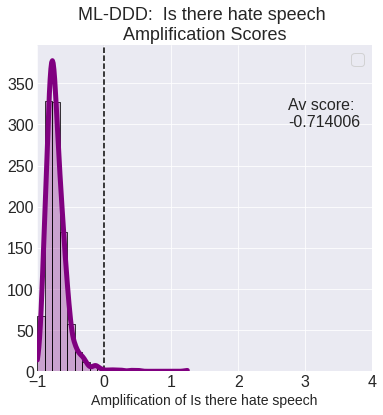

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone vomit: -0.5351962109880535


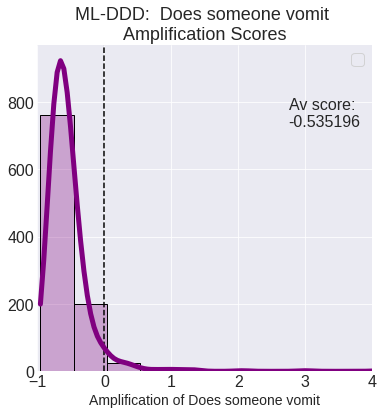

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there gun violence: -0.7132772741865752


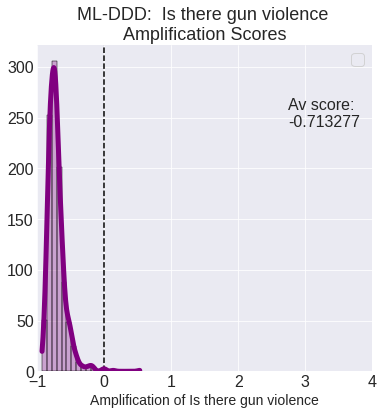

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is the fourth wall broken: -0.6598671499273623


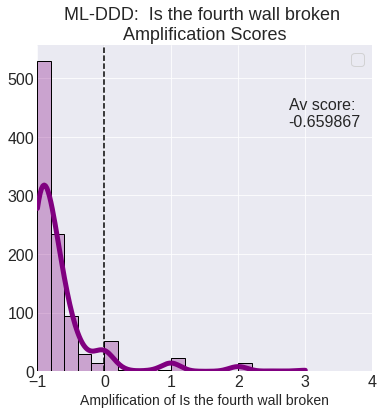

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there body horror: -0.7822177042566199


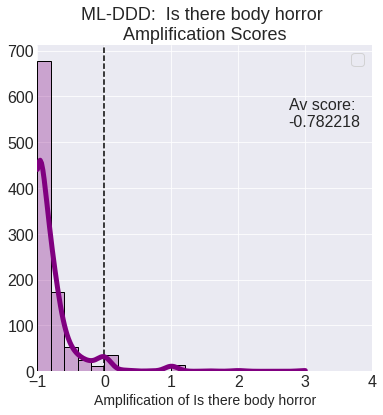

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a horse die: -0.6307322119952732


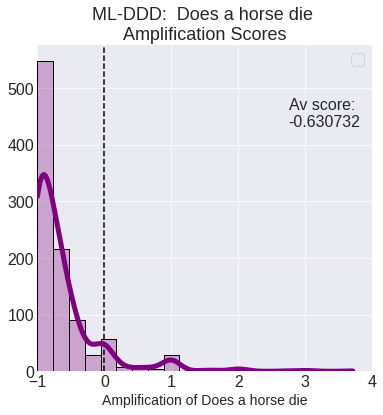

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a shower scene: -0.6293757978263693


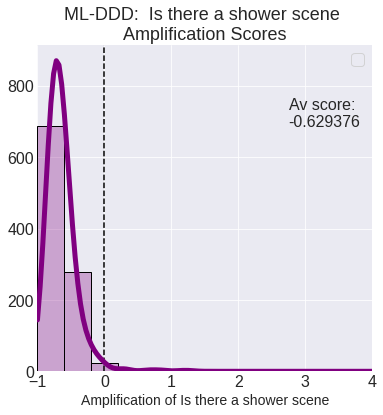

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone self harm: -0.4518039906604343


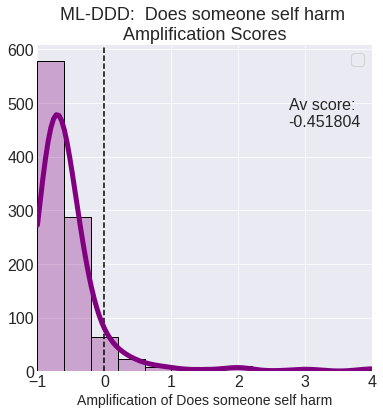

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there childbirth: -0.3266777868893262


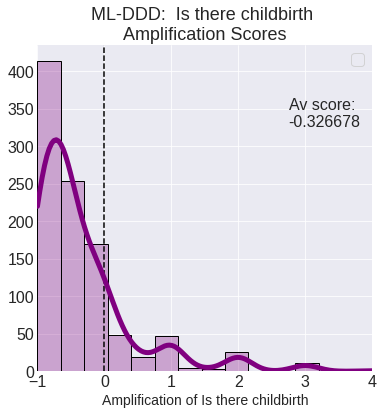

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a nuclear explosion: -0.6596225688184121


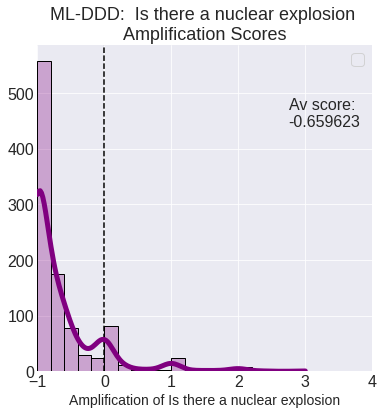

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there autism specific abuse: -0.7243937192227105


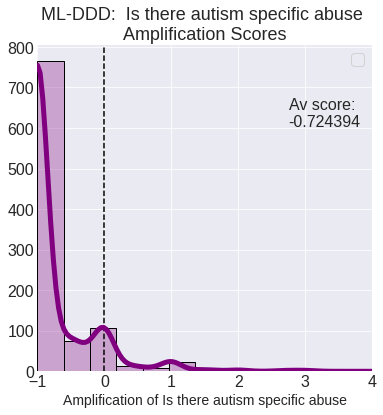

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there cannibalism: -0.2640566782348707


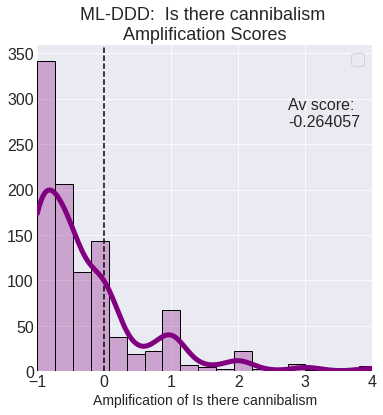

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone misgendered: -0.5888363482974838


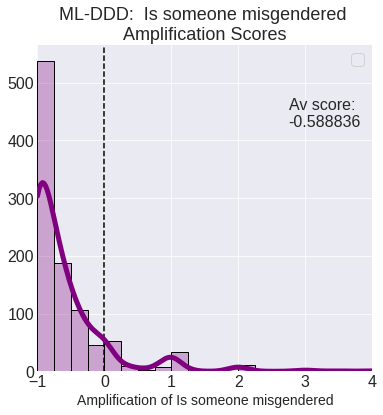

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there aphobia: -0.98756


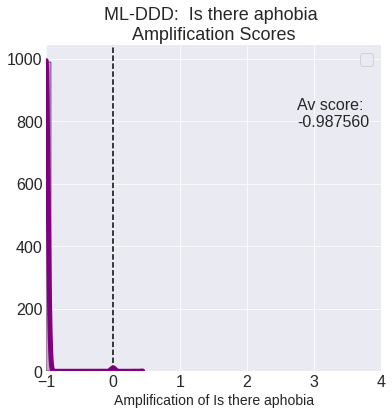

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a cat die: -0.21024078598774346


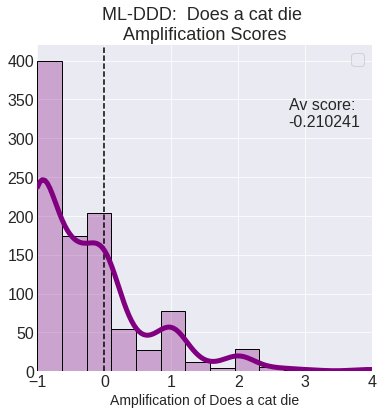

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a dragon die: -0.7389252692307694


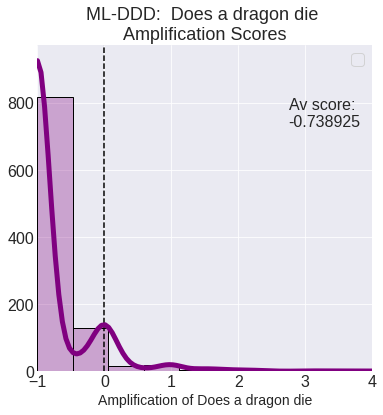

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone overdose: -0.7192578103496735


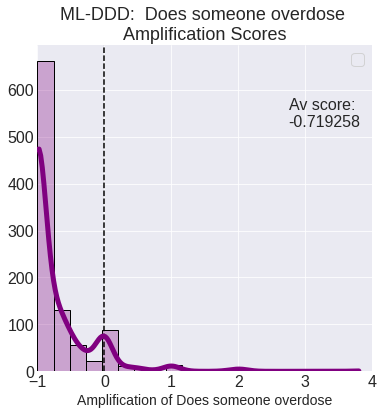

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a mental institution scene: -0.5286756570649751


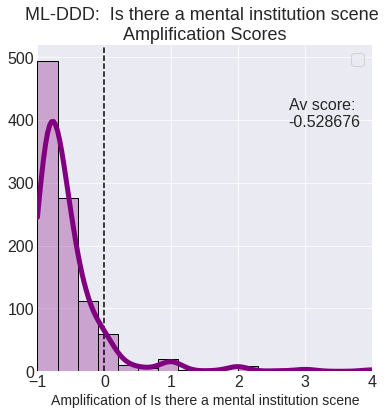

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have a stroke: -0.7947562647630146


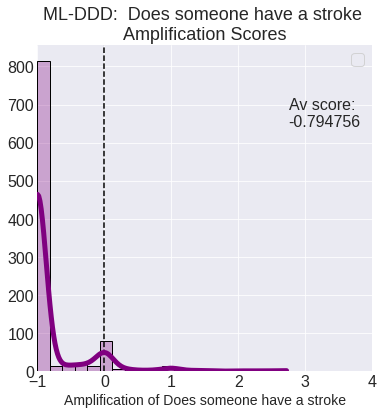

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does an LGBT person die: -0.37853398491426477


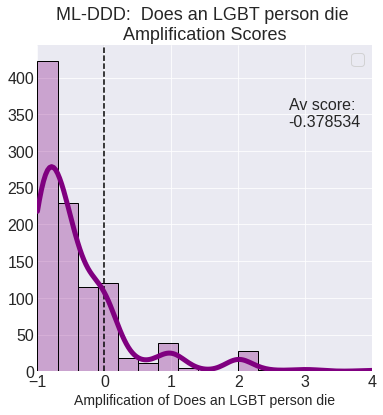

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there body dysphoria: -0.98698


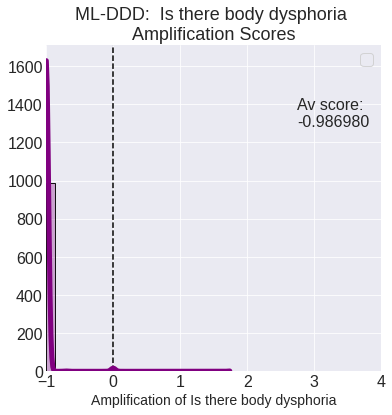

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone struggle to breathe: -0.7119014011441243


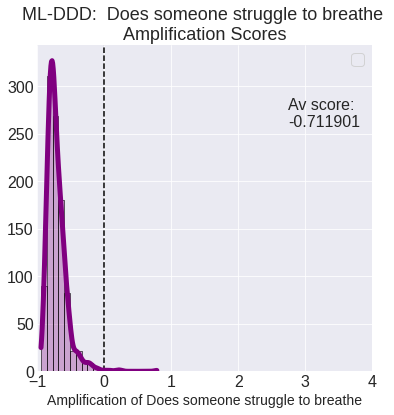

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have cancer: -0.47634924311145804


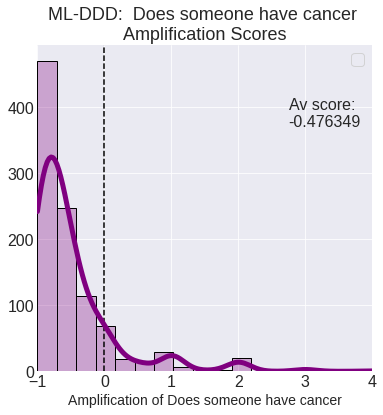

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone fall to their death: -0.692596243252492


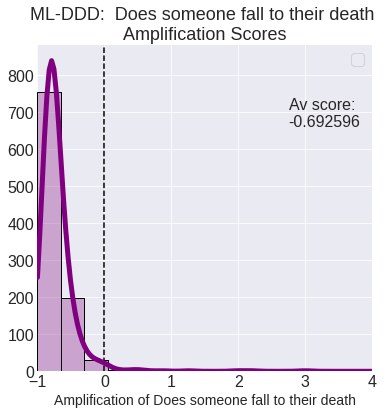

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there ghosts: -0.21517586064488906


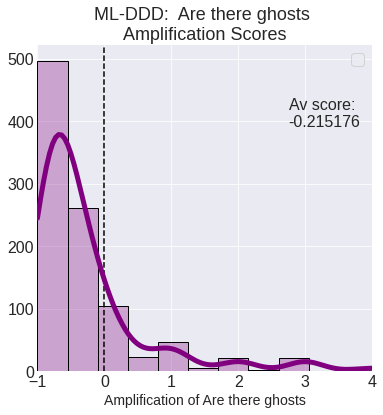

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone raped onscreen: -0.7303155692409727


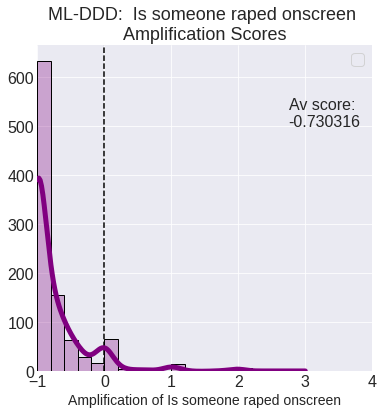

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there babies or unborn children: -0.7134693888457587


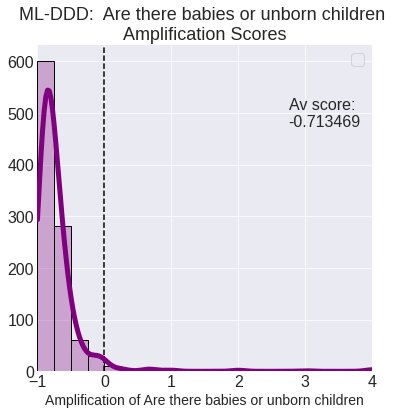

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone asphyxiate: -0.6803568280927805


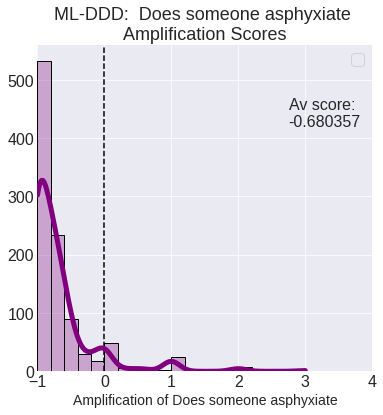

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is the R word used: -0.7034717507700268


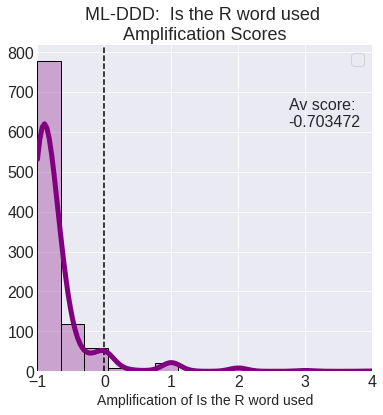

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does the dog die: -0.054496533121903085


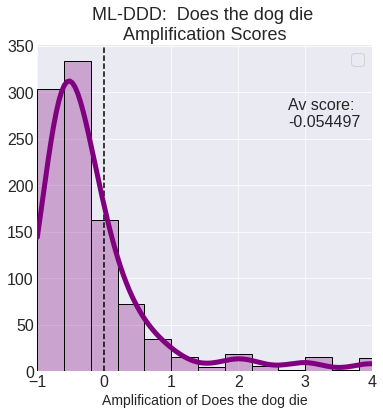

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a baby cry: -0.6774501194468918


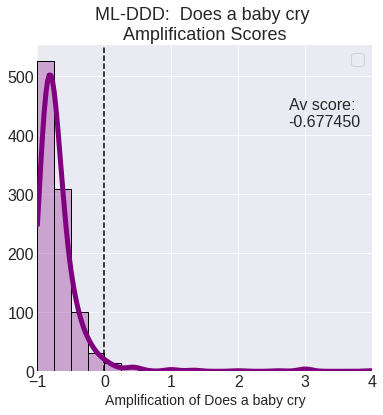

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there bugs: -0.6051523627530624


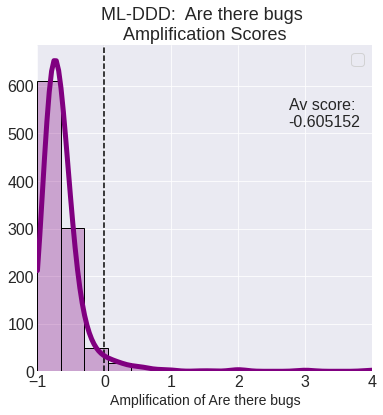

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a non-human character die: -0.9453449999999999


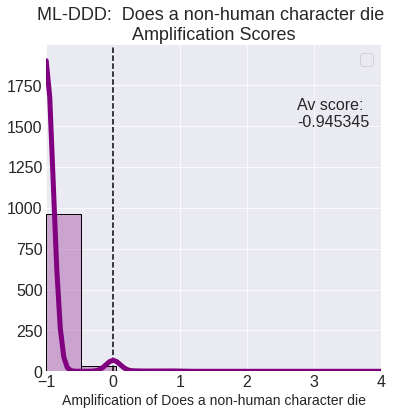

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a minor sexualized: -0.7317684379446651


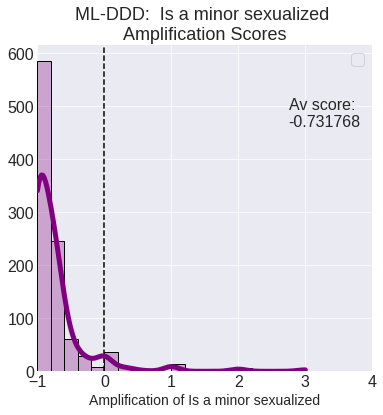

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are needles/syringes used: -0.6807528772549446


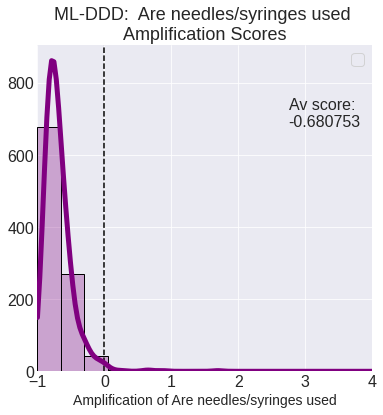

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there nude scenes: -0.7322814089596611


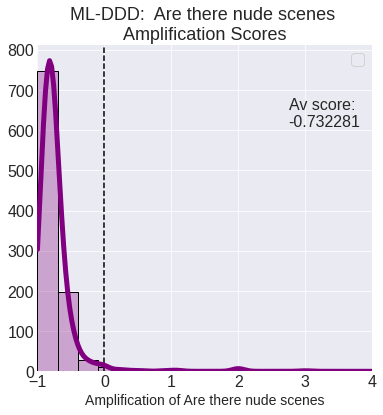

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone tortured: -0.6777342276204554


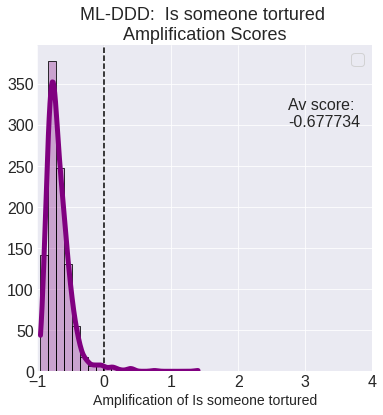

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a kid die: -0.4150977970900528


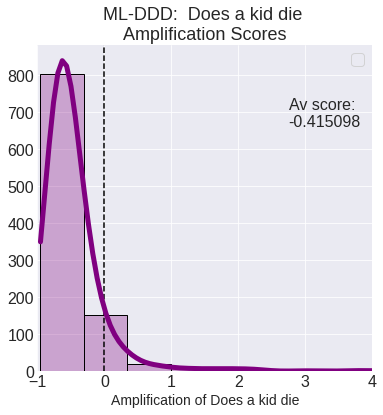

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a pregnant person die: -0.37396472846563467


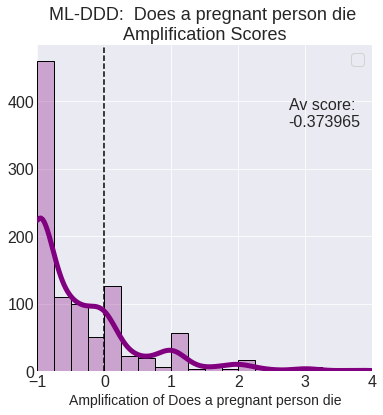

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there homophobic slurs: -0.5411065363427289


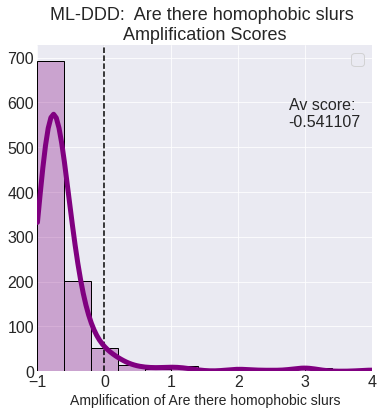

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone break a bone: -0.7219895533980172


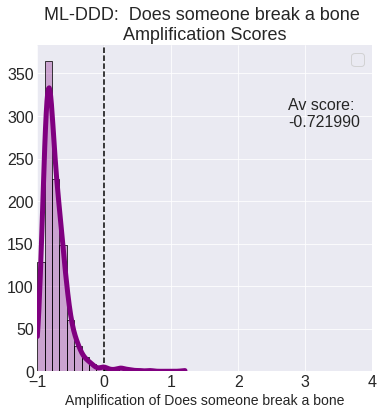

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there n-words: -0.6836274014769316


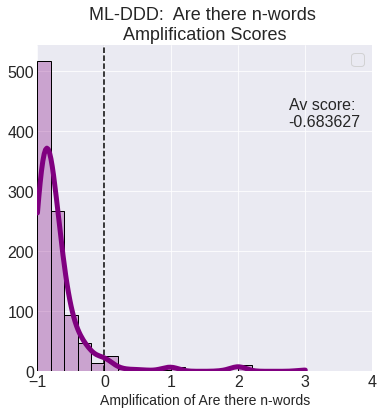

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there addiction: -0.515499392701922


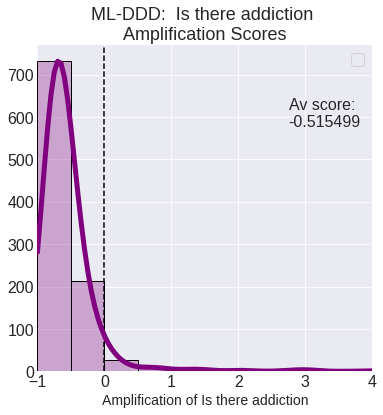

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there shakey cam: -0.5187116031946912


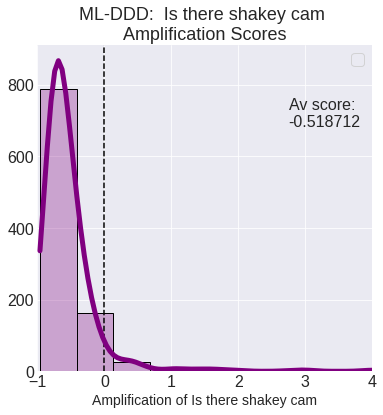

 av amp for Is there body dysmorphia: -0.5789821736370099


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


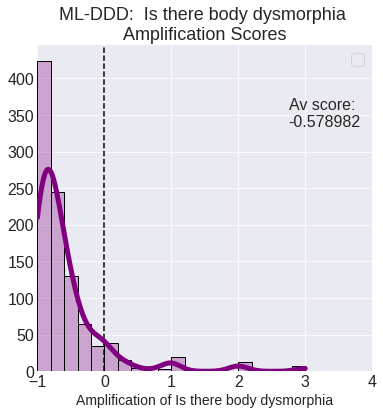

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a dead animal: -0.6530533038860534


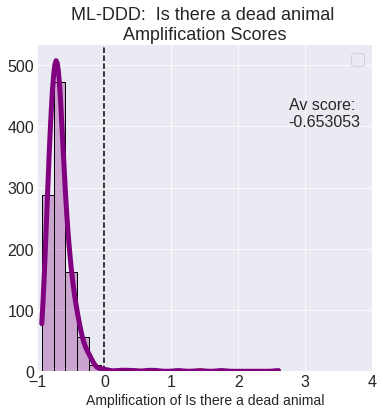

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there clowns: -0.566768940290579


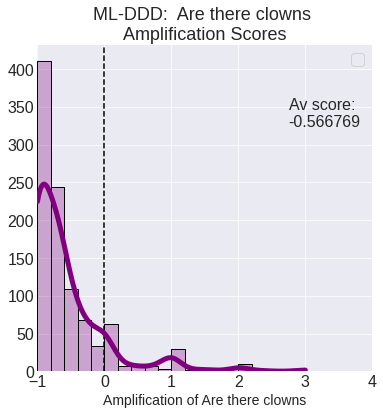

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a mentally ill person violent: -0.6445832582722608


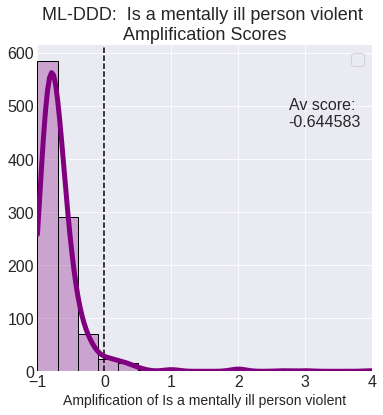

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there spiders: -0.6574555365987224


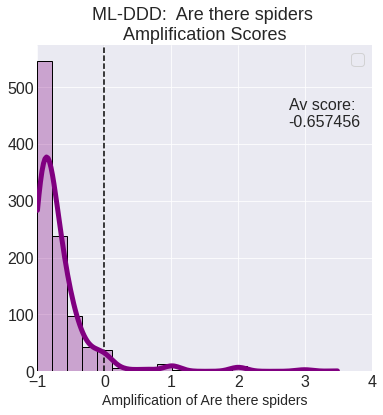

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a child's toy destroyed: -0.6018599562145167


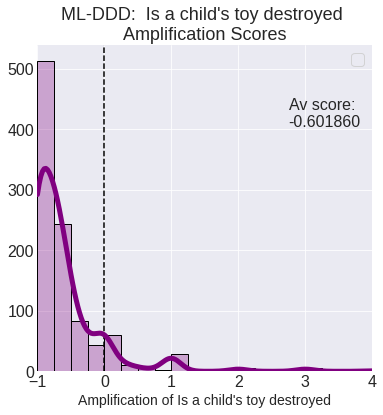

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there mannequins: -0.8659423133306753


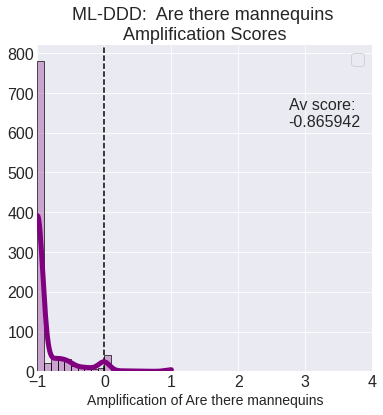

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there Achilles Tendon injury: -0.8219078333333332


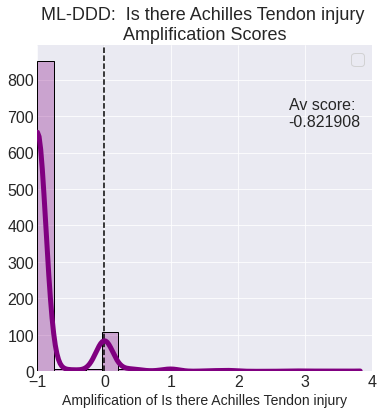

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone stalked: -0.542018621383305


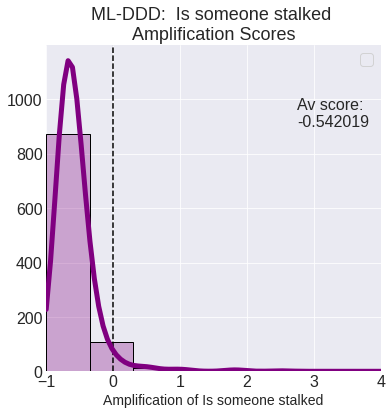

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there D.I.D. misrepresentation: -0.9553750000000001


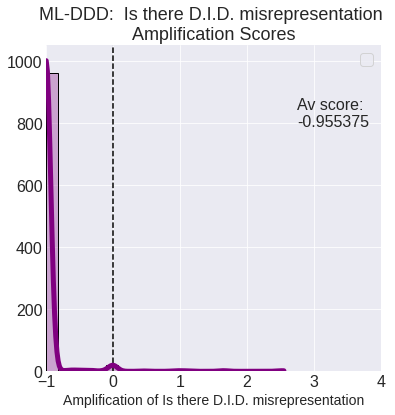

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there 9/11 depictions: -0.8710527261904765


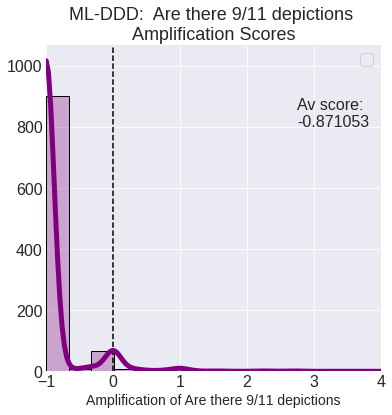

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a child abused: -0.5330611093405018


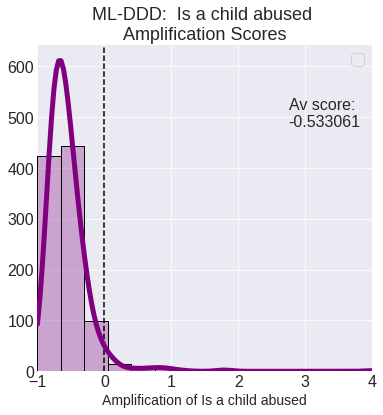

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are animals abused: -0.6163914814112993


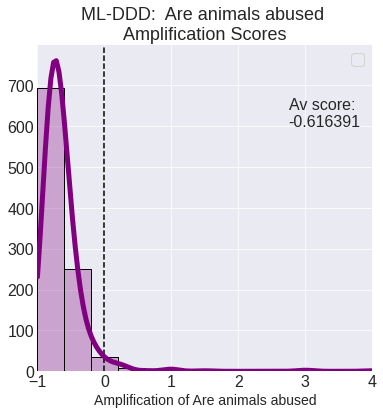

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is an infant abducted: -0.7858123140331892


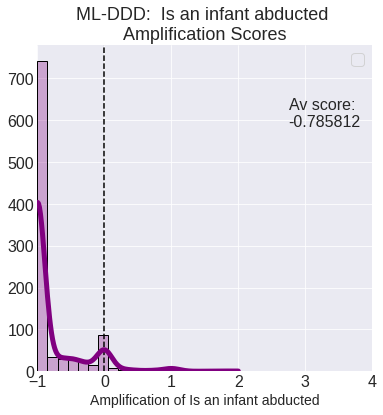

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a large age gap: -0.7414829591450747


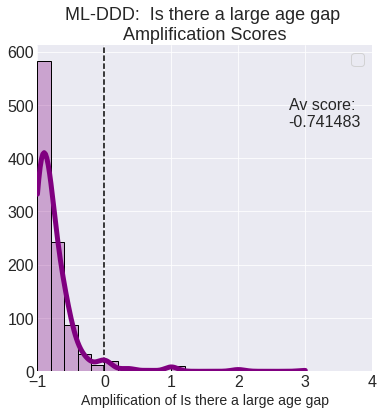

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a claustrophobic scene: -0.7160762530360035


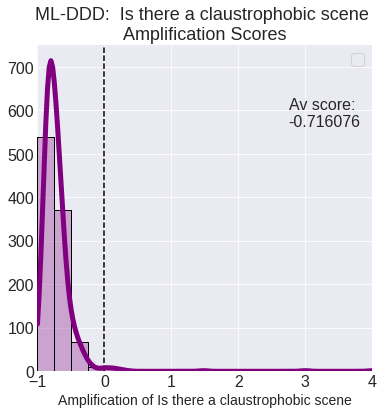

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone miscarry: -0.4412891743605217


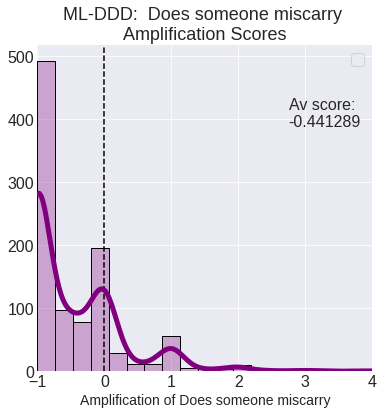

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does the black guy die first: -0.6095190074706591


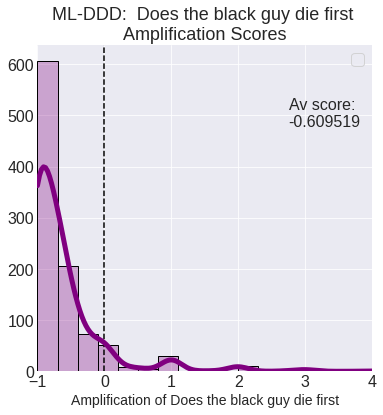

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there misophonia: -0.703633885928938


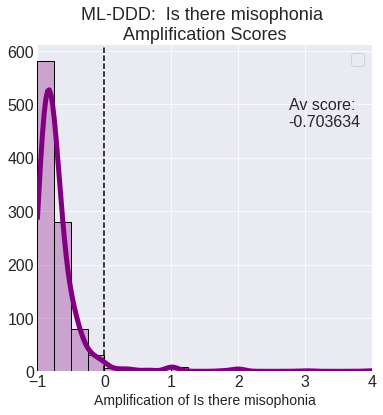

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a pet die: -0.6350448080414501


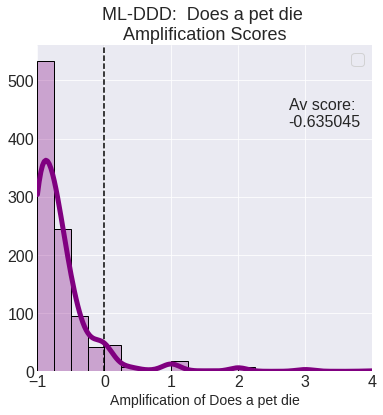

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a baby stillborn: -0.8284810000000001


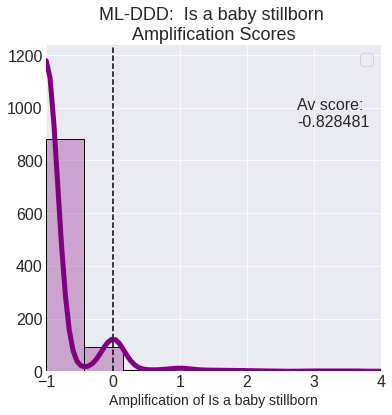

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there "Man in a dress" jokes: -0.7410893526449778


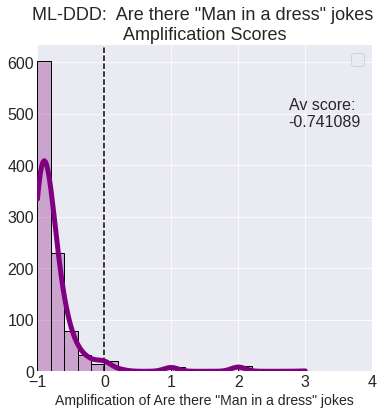

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone hit by a car: -0.6399361519991927


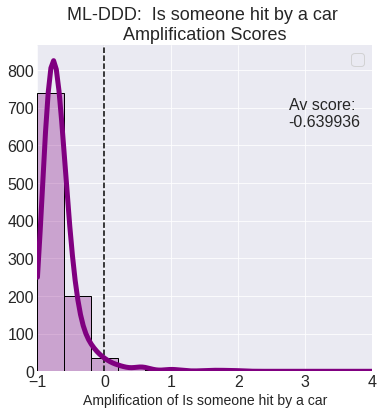

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is Santa (et al) spoiled: -0.6946573809523809


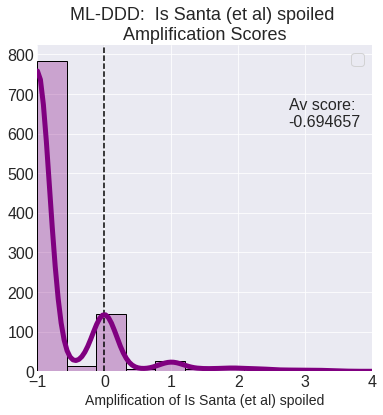

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have a seizure: -0.4895833149324221


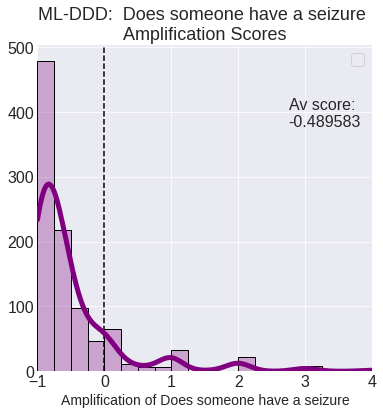

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there domestic violence: -0.5548783382602057


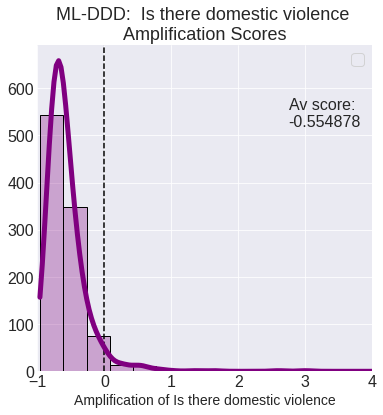

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone possessed: -0.29172483935991994


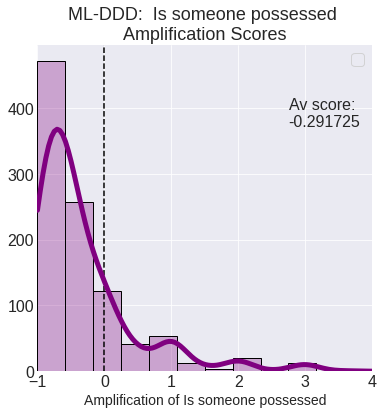

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there amputation: -0.5773138930268041


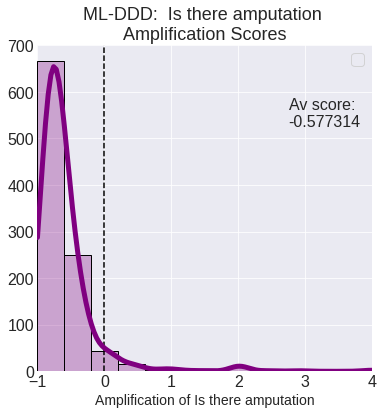

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there razors: -0.7896380651058312


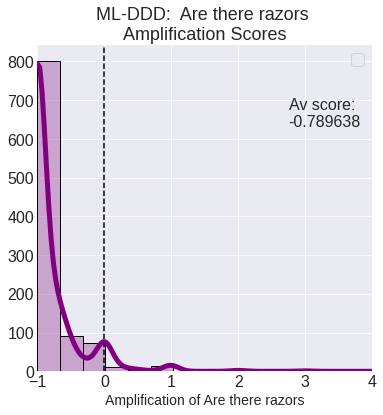

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there genital trauma/mutilation: -0.6121691350183265


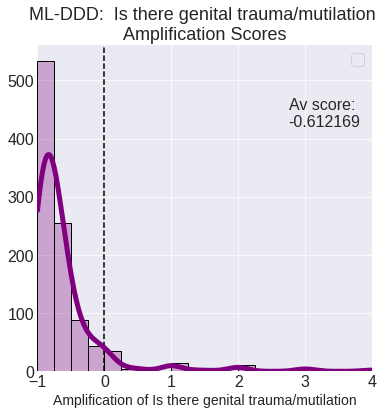

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are any teeth damaged: -0.4707566288178484


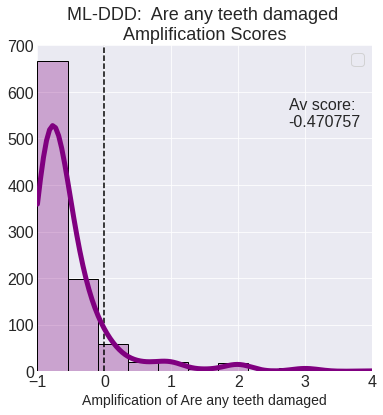

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there antisemitism: -0.7013606554791332


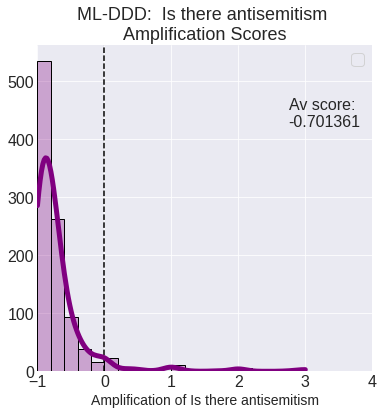

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is electro-therapy used: -0.6346388628346056


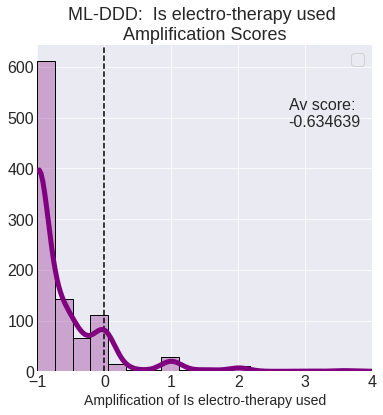

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone gaslighted: -0.679849224222939


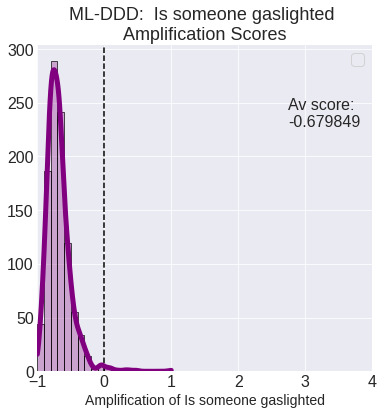

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone wet/soil themselves: -0.557697538105736


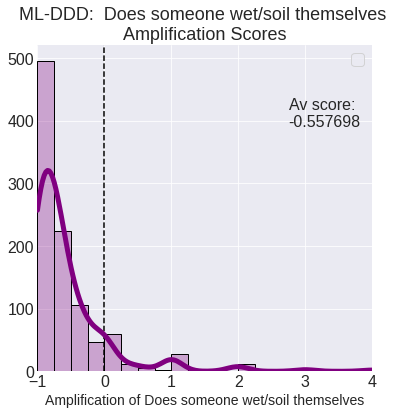

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone attempt suicide: -0.7578997677096307


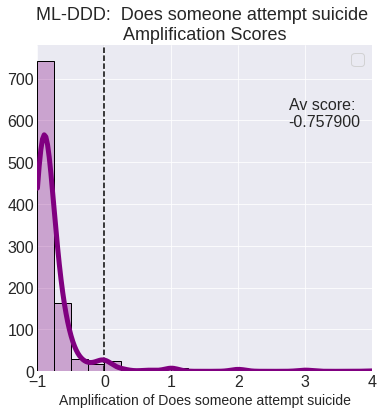

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a male character ridiculed for crying: -0.777014037909099


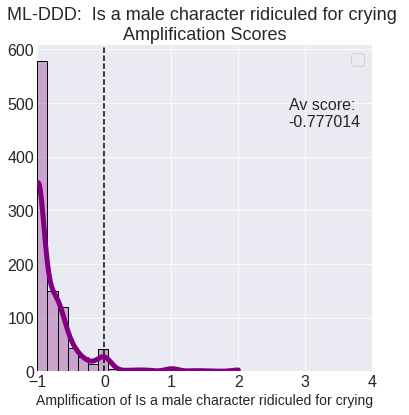

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone sacrifice themselves: -0.7748060909085361


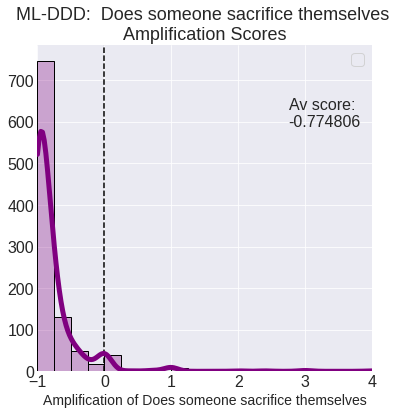

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a car crash: -0.7254602408463001


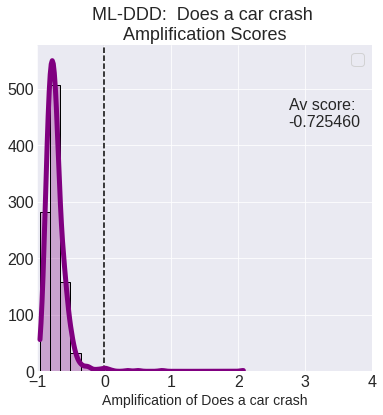

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone sexually assaulted: -0.5987505185529165


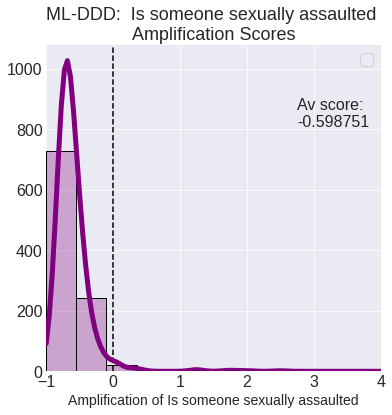

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone homeless: -0.7529191790701046


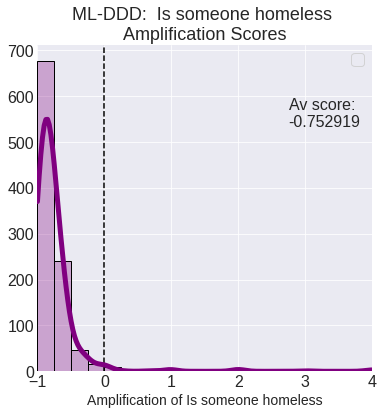

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there fat suits: -0.9439613333333334


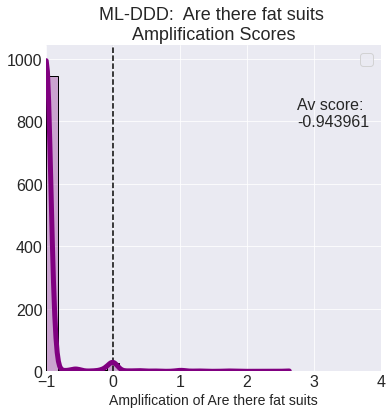

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there excessive gore: -0.4904057350074264


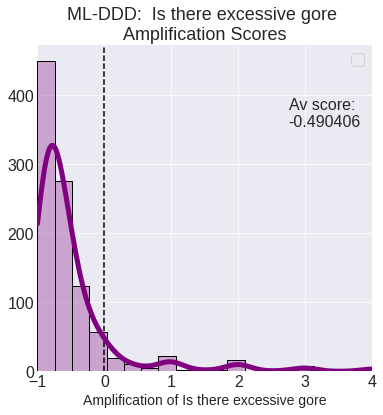

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone restrained: -0.8164065748768681


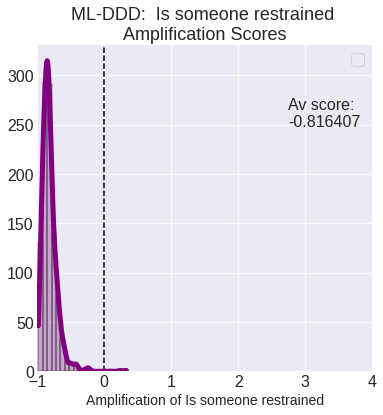

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone kidnapped: -0.7016673122804772


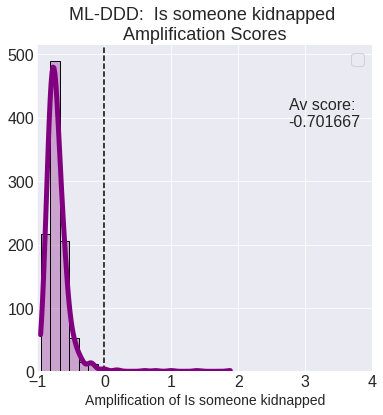

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there fat jokes: -0.7399093351388066


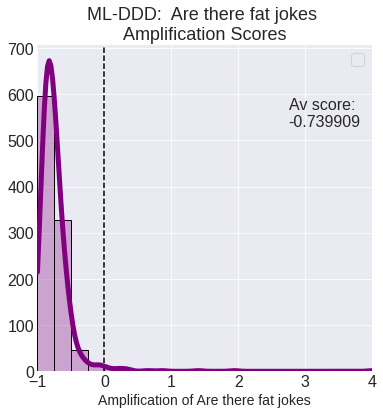

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone sexually objectified: -0.7916007560327467


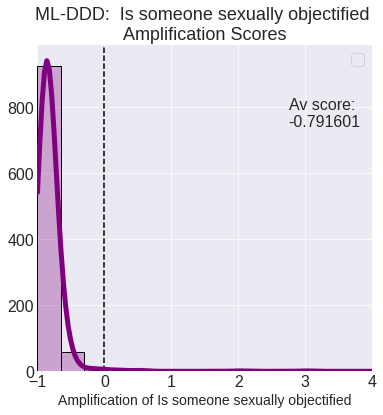

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a plane crash: -0.7241288396889395


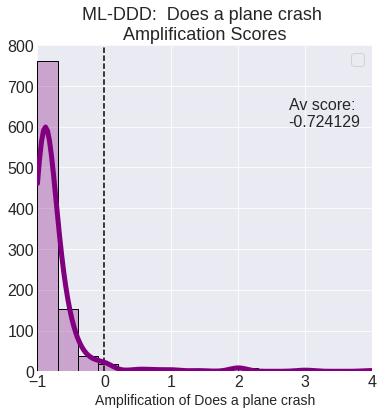

In [26]:
warning_amplification_plots(random_amplification_dfs)

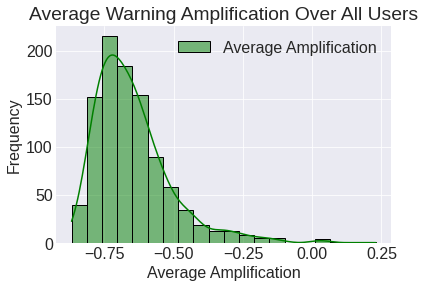

In [27]:
user_amplification_plots(random_amplification_dfs)

### SVD Algorithm

In [28]:
svd_amplification_dfs = amplification_dfs(svd_recs)

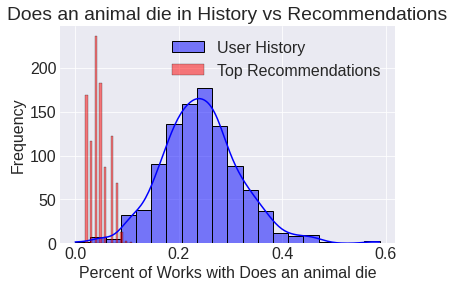

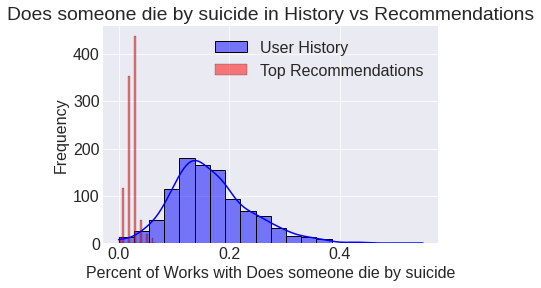

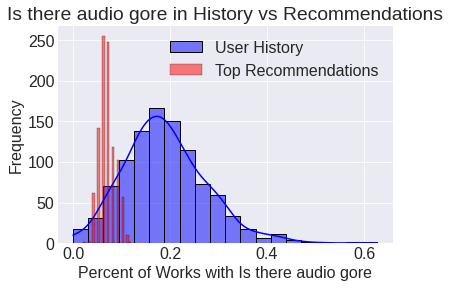

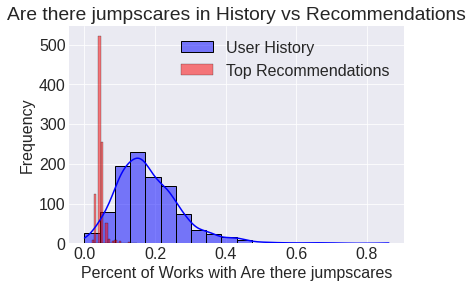

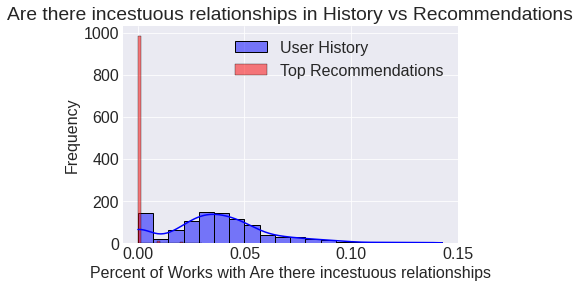

...

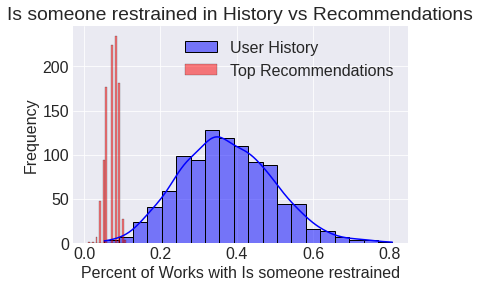

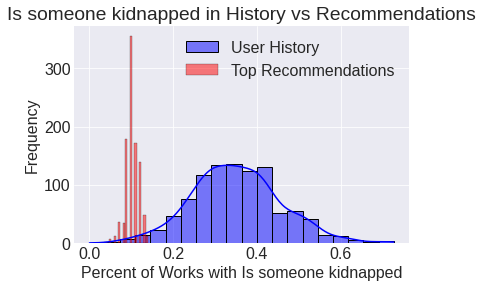

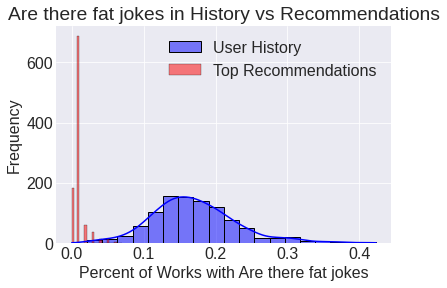

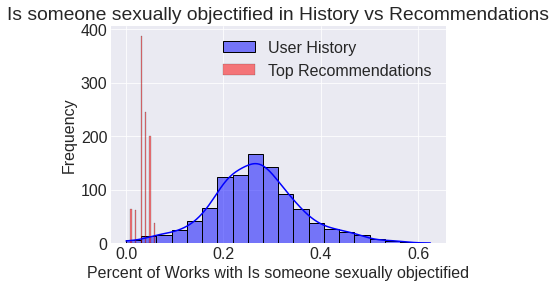

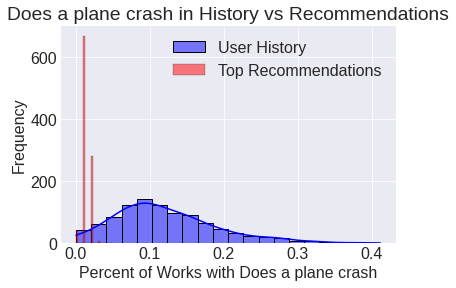

In [29]:
warning_distribution_plots(svd_amplification_dfs)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does an animal die: -0.7814624246672698


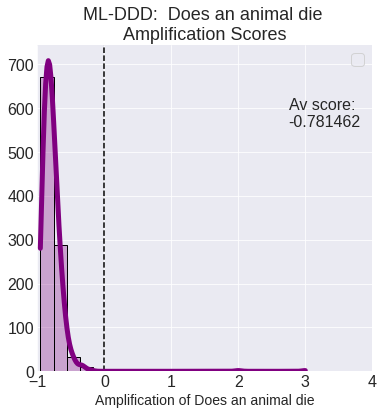

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone die by suicide: -0.7963901862421354


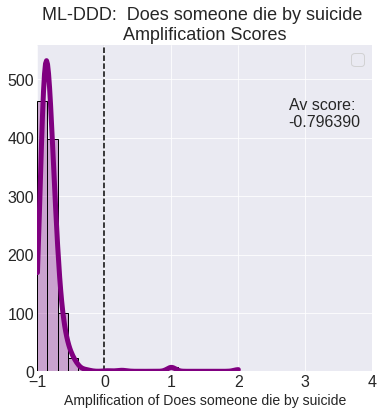

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there audio gore: -0.48648482686102323


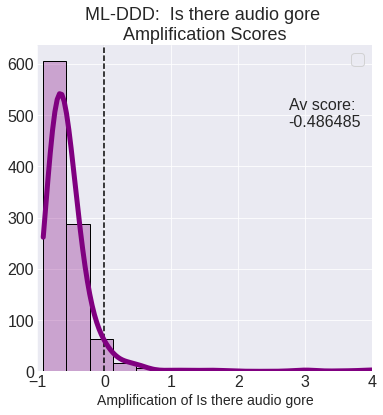

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there jumpscares: -0.6524509473419059


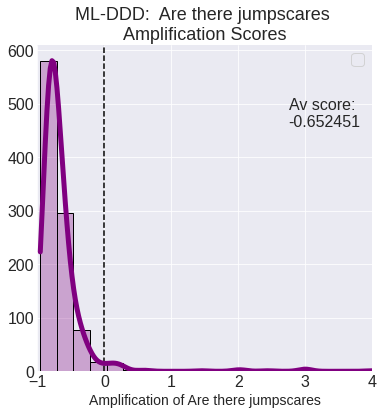

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there incestuous relationships: -0.9930971805836197


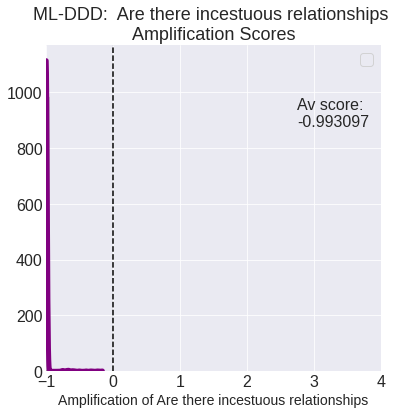

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there shaving/cutting: -0.66544272667965


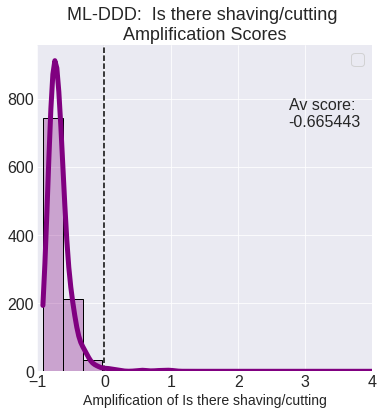

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone abuse alcohol: -0.6749373507461462


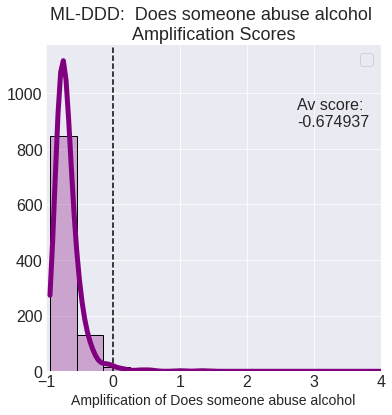

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone use drugs: -0.71223215399541


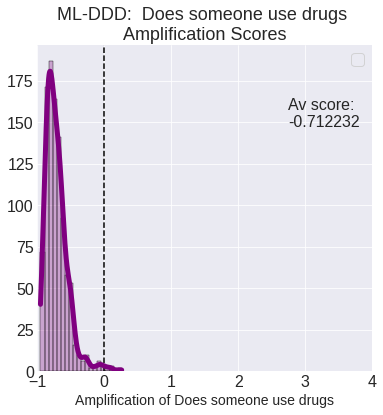

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a car honk or tires screech: -0.9019538861708777


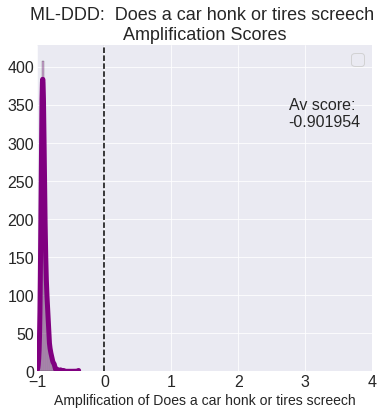

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does it have a sad ending: -0.5586875972691467


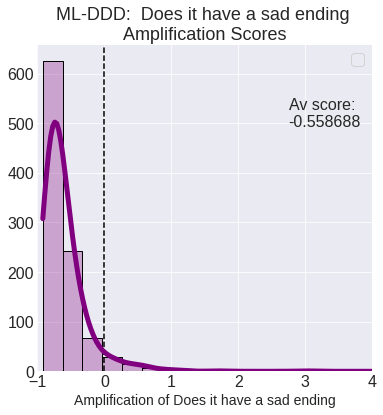

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a hospital scene: -0.7868820168276385


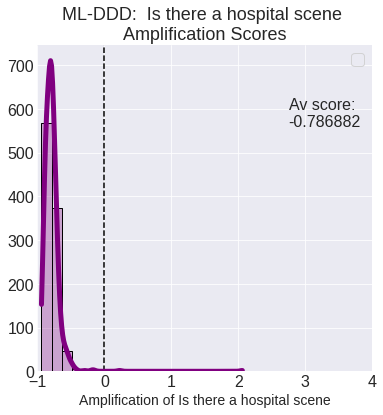

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there ableist language or behavior: -0.7562429670437326


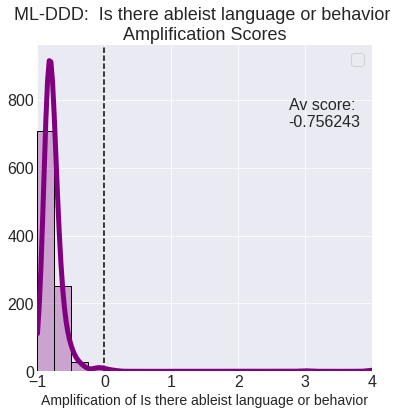

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone burned alive: -0.7378828112018098


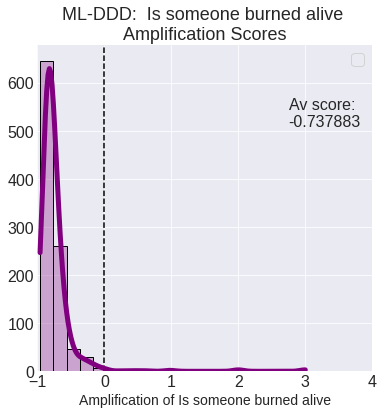

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there copaganda: -0.8625396154013596


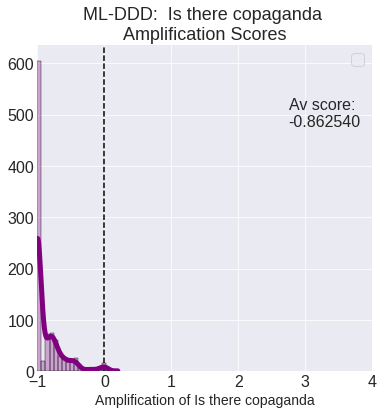

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there anxiety attacks: -0.7959392565953533


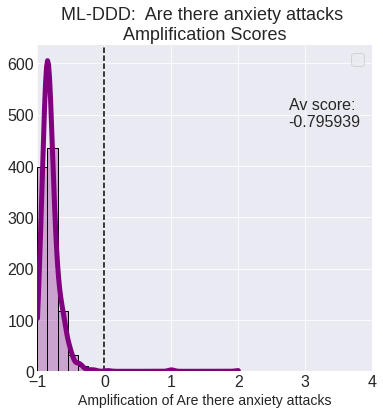

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there abortions: -0.9020179067939115


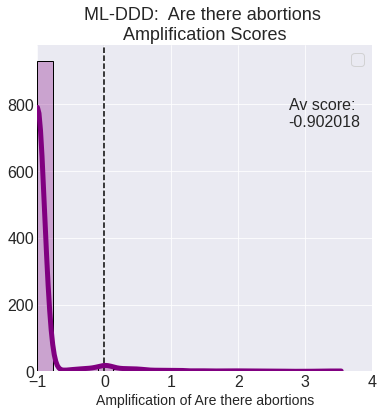

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there sexual content: -0.7306187847765656


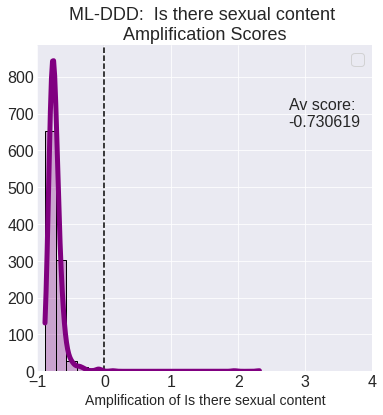

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a child abandoned by a parent: -0.9623587530479845


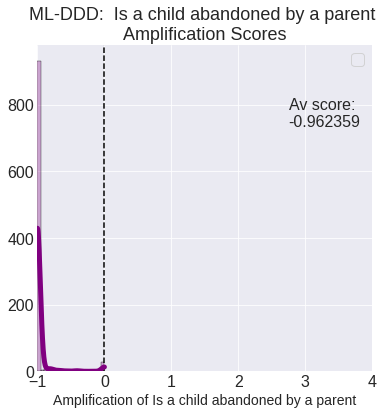

/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there bisexual cheating: -1.0


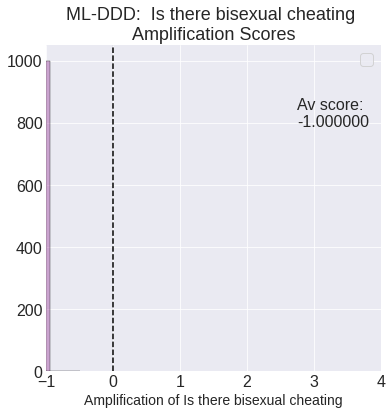

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there eye mutilation: -0.8303278466097421


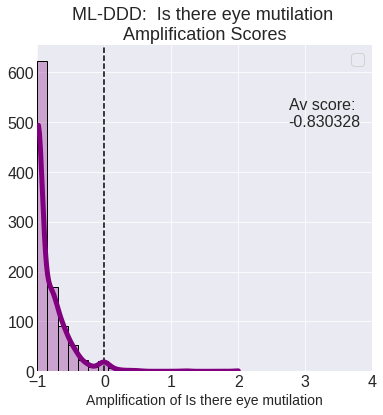

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there dementia/Alzheimer's: -0.4576425000000003


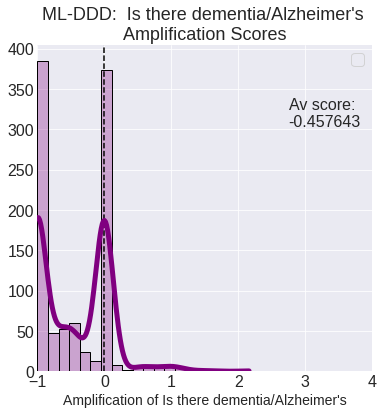

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a head get squashed: -0.7034528077411362


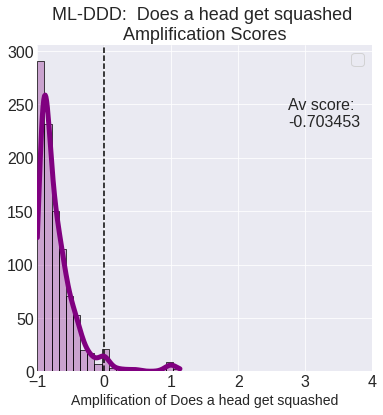

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there blood/gore: -0.7357948555399515


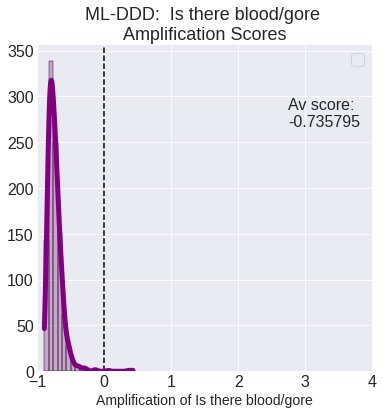

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone crushed to death: -0.8485584587288575


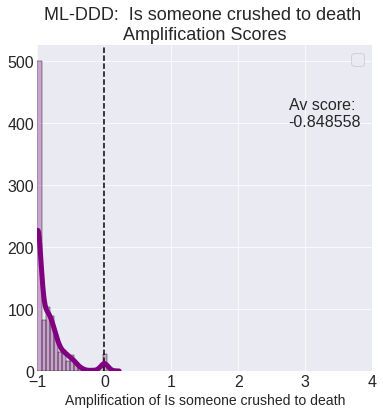

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone becomes unconscious: -0.9447965205915313


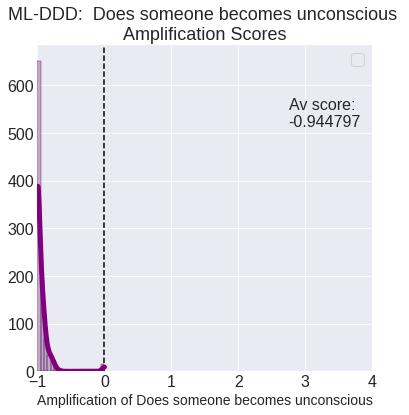

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there dog fighting: -0.5922116587301585


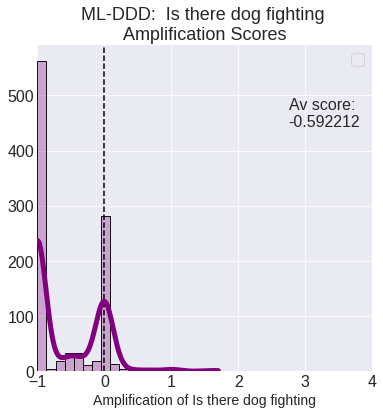

/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there bestiality: -1.0


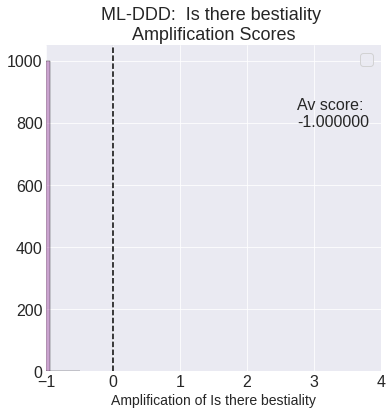

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there finger/toe mutilation: -0.8406997102108796


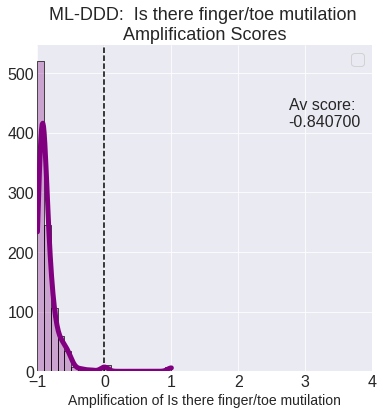

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone suffer from PTSD: -0.8544932220023574


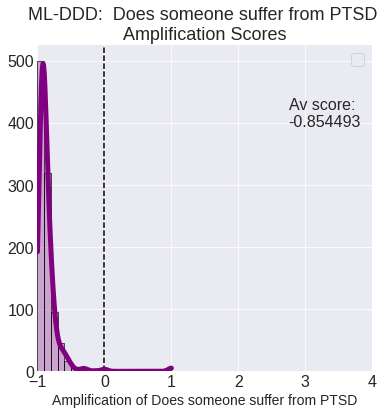

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone fart or spit: -0.8745384718831396


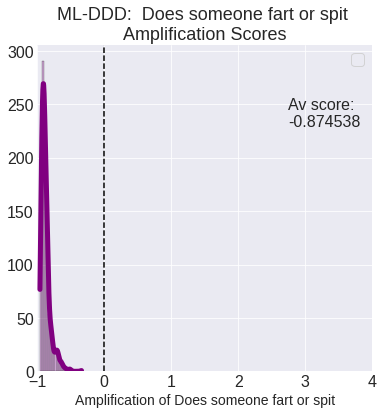

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone drugged: -0.9070818518518515


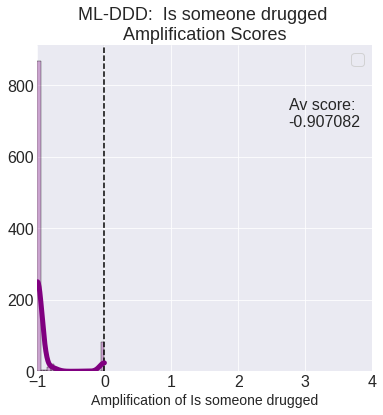

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone drown: -0.8093779620835925


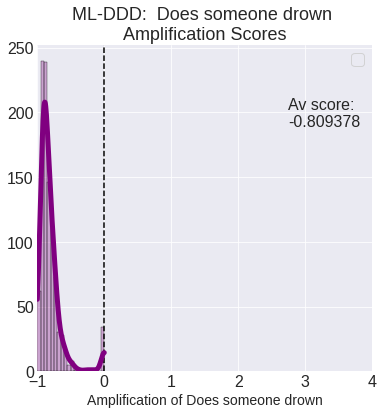

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have an eating disorder: -0.9572513473778251


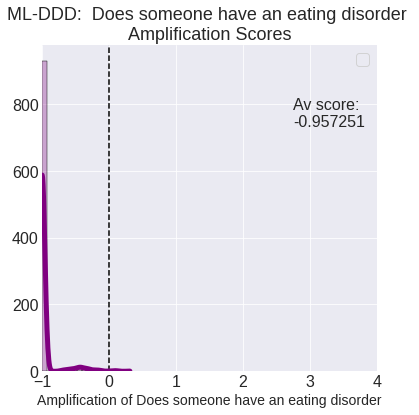

/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does the abused become the abuser: -1.0


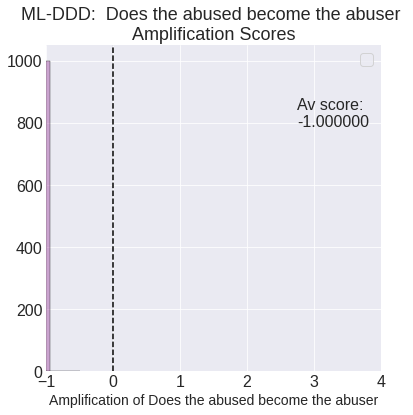

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a parent die: -0.74813706076134


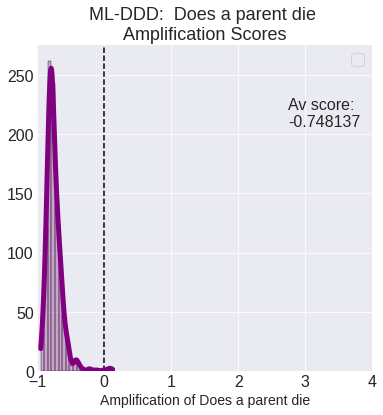

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone buried alive: -0.37969224693820347


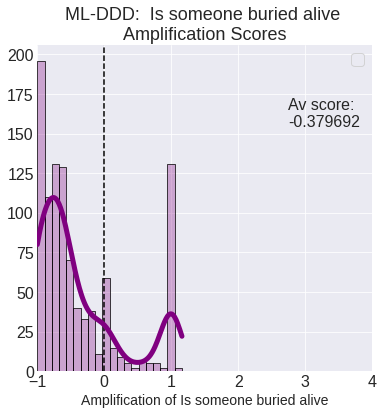

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a minority is misrepresented: -0.9974297087065055


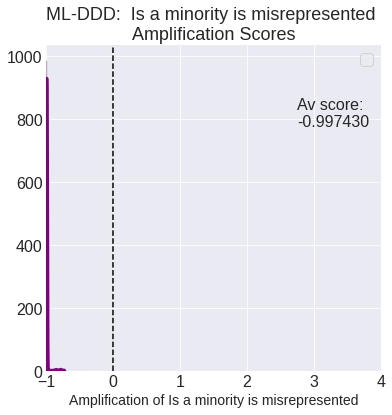

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there obscene language/gestures: -0.876774576247495


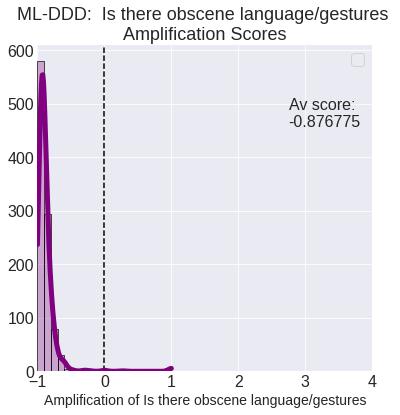

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a hanging: -0.9297785418999017


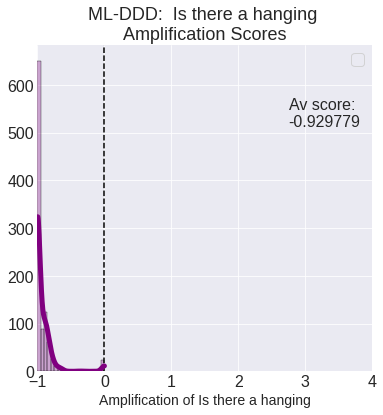

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone cheat: -0.7532794686665218


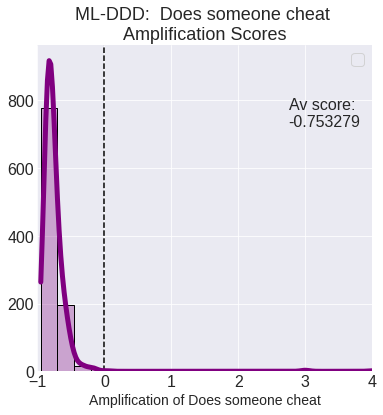

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have a chronic illness: -0.7998935004023575


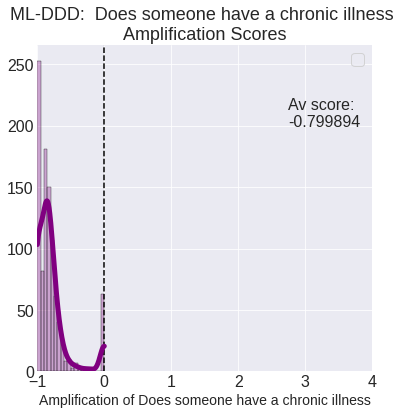

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone fall down stairs: -0.6028764081915863


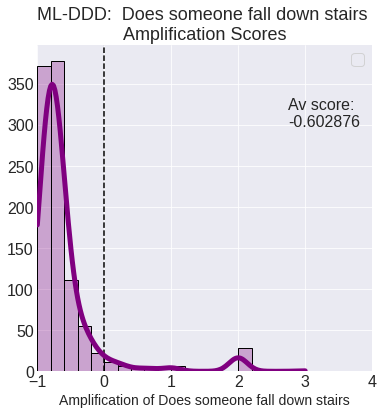

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there flashing lights or images: -0.5155359260751882


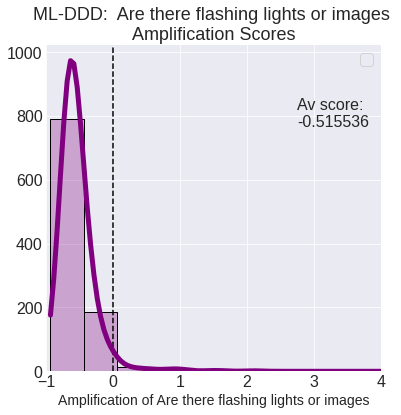

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone say "I'll kill myself": -0.9488378955248248


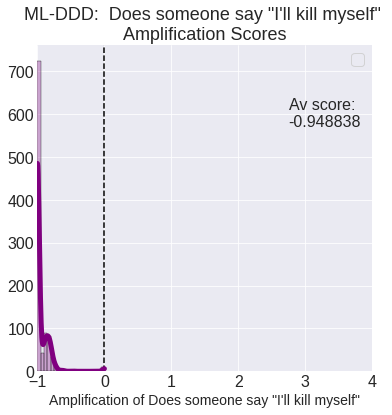

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there snakes: -0.3537324106223396


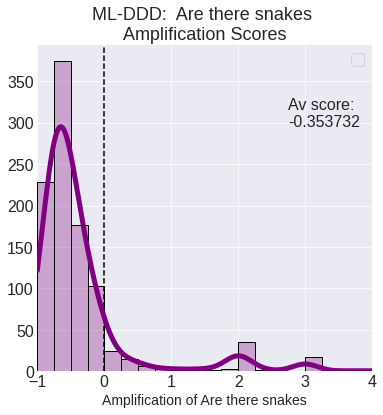

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there hate speech: -0.8538535823128467


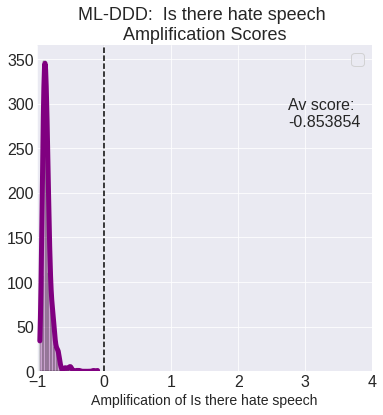

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone vomit: -0.6710850145848312


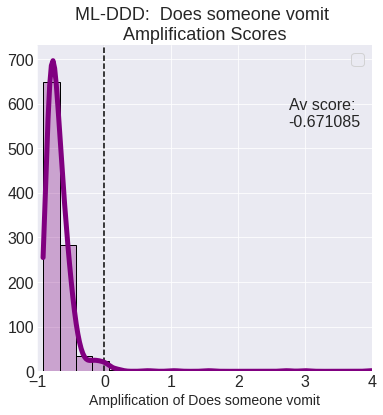

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there gun violence: -0.795115239331581


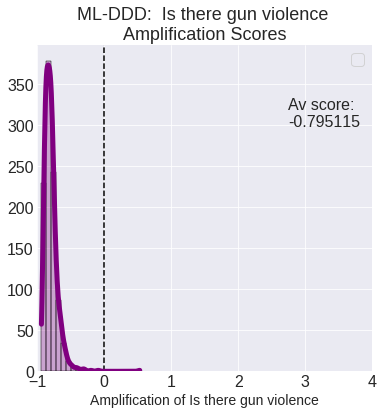

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is the fourth wall broken: -0.9936818057307807


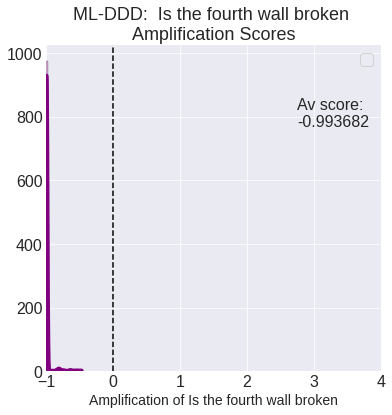

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there body horror: -0.9324008284004159


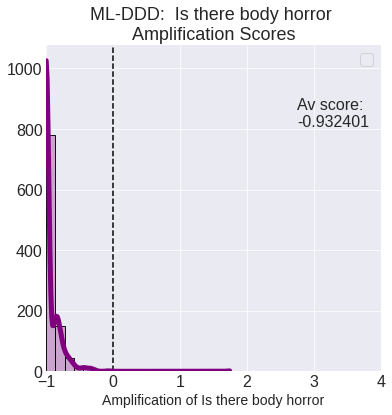

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a horse die: -0.9857833607167789


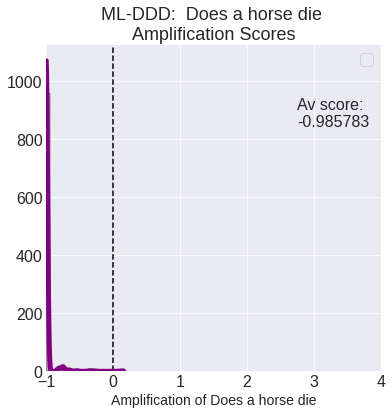

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a shower scene: -0.7464124768695132


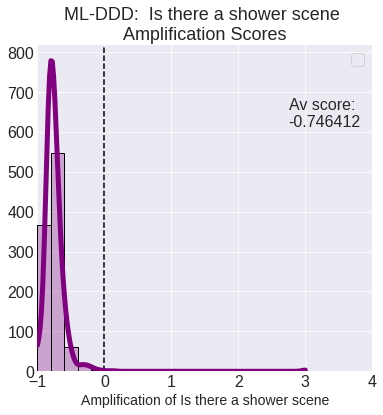

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone self harm: -0.6388843317473138


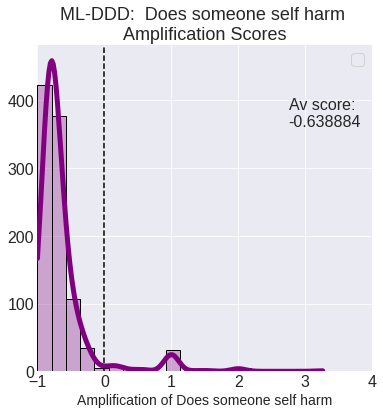

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there childbirth: 0.01639991046667659


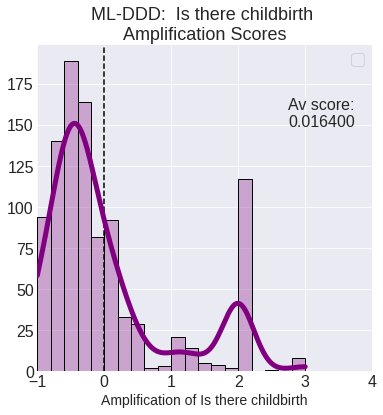

 av amp for Is there a nuclear explosion: -0.7589162554232558


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


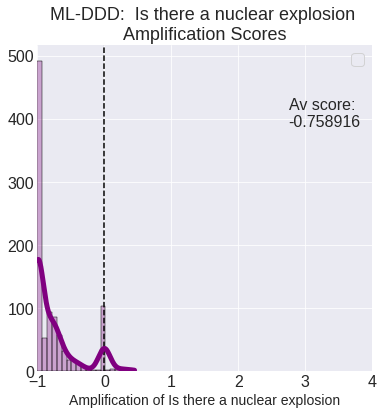

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there autism specific abuse: -0.9982598870967742


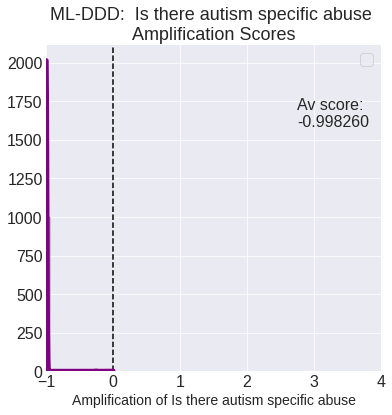

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there cannibalism: -0.7604393701139454


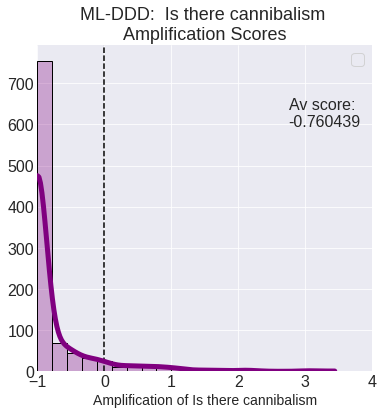

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone misgendered: -0.5941162453426793


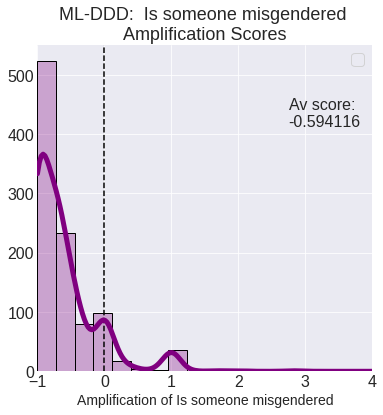

/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there aphobia: -1.0


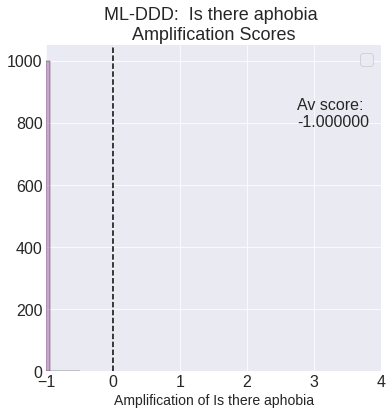

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a cat die: -0.5656025206680955


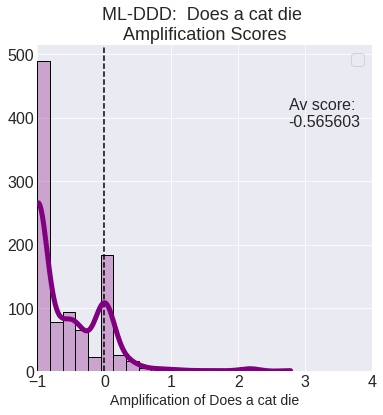

/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a dragon die: -1.0


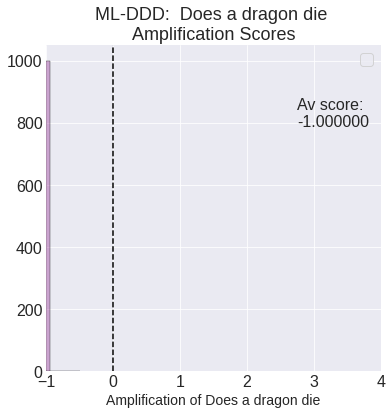

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone overdose: -0.45642794428855454


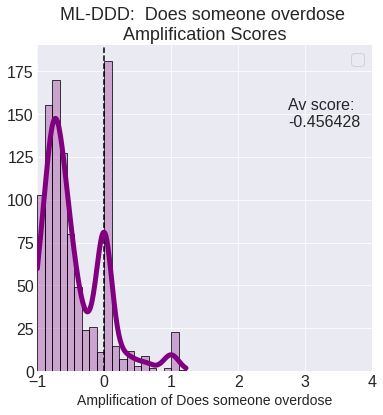

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a mental institution scene: -0.4720039533526269


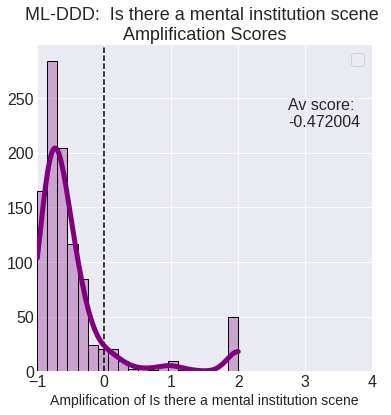

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have a stroke: -0.48595166666666667


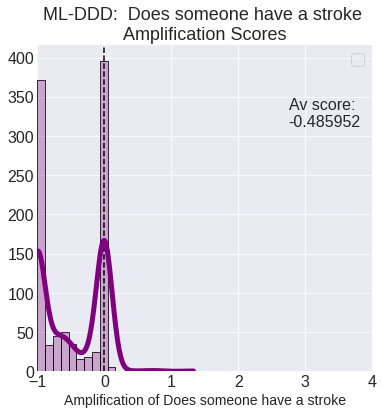

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does an LGBT person die: -0.7938251550654282


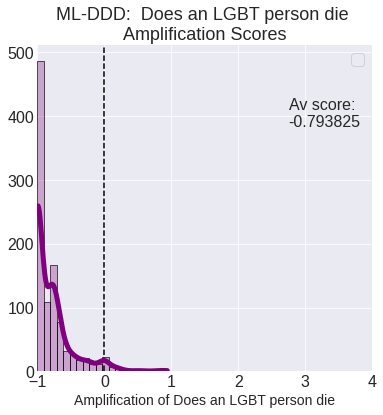

/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there body dysphoria: -1.0


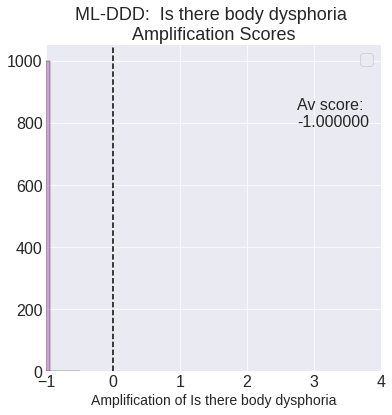

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone struggle to breathe: -0.7612333390822507


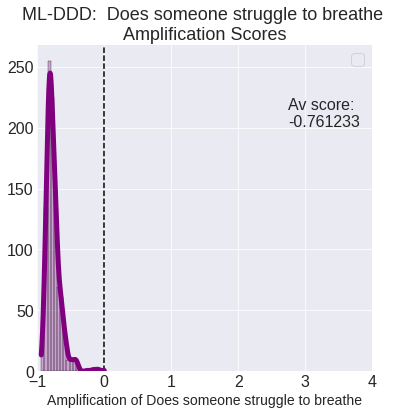

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have cancer: -0.30693946354308654


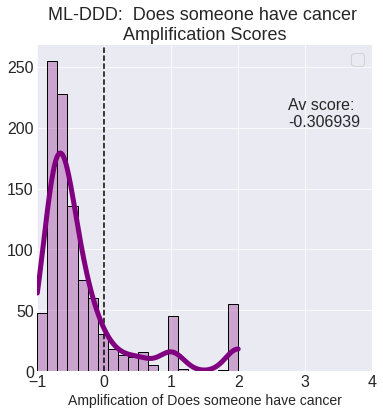

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone fall to their death: -0.8734457235390851


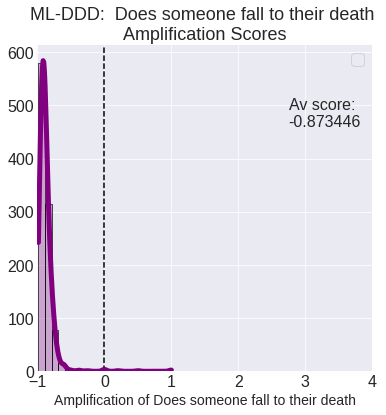

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there ghosts: -0.704746926972003


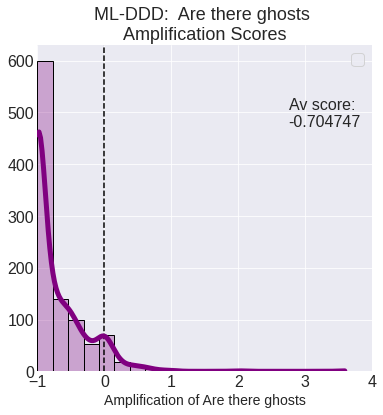

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone raped onscreen: -0.8596487991954702


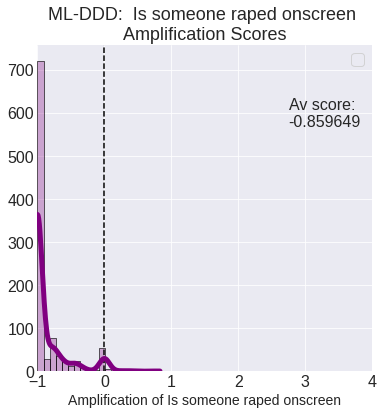

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there babies or unborn children: -0.9239156113315461


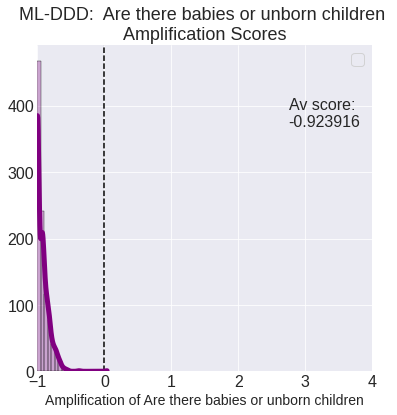

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone asphyxiate: -0.9076909738731035


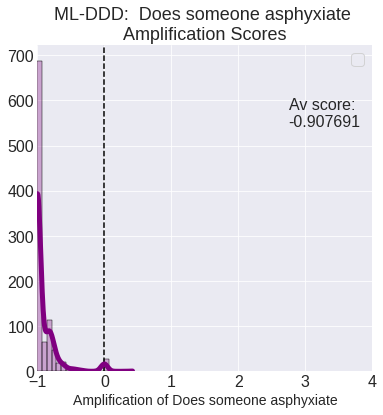

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is the R word used: -0.834300586870648


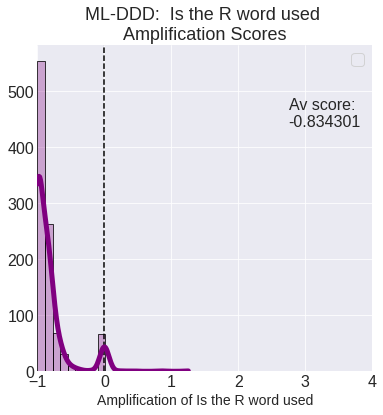

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does the dog die: 0.03928078865251038


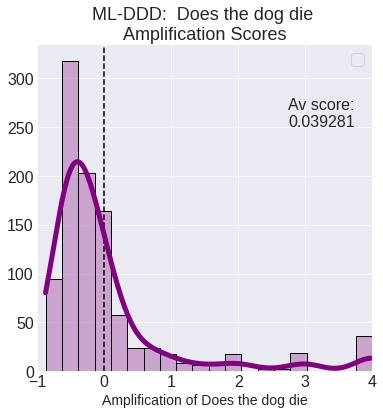

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a baby cry: -0.6445466671582931


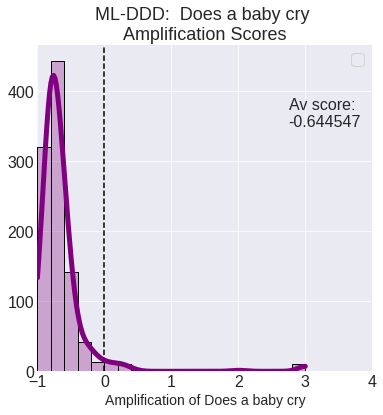

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there bugs: -0.7383856994417007


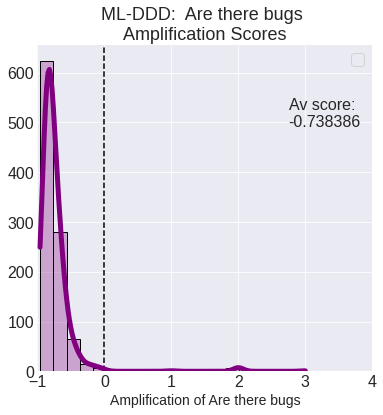

/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a non-human character die: -1.0


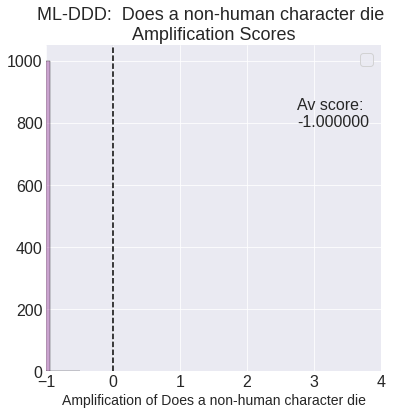

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a minor sexualized: -0.6644837787269717


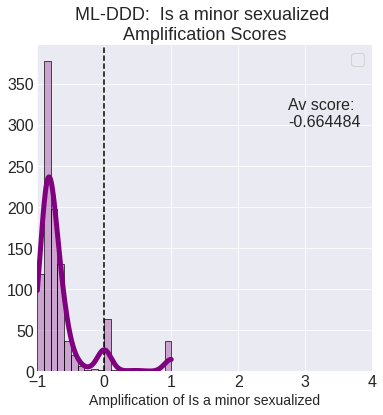

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are needles/syringes used: -0.8102879994109704


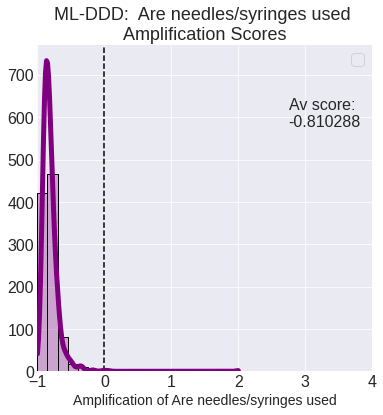

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there nude scenes: -0.8097524386733418


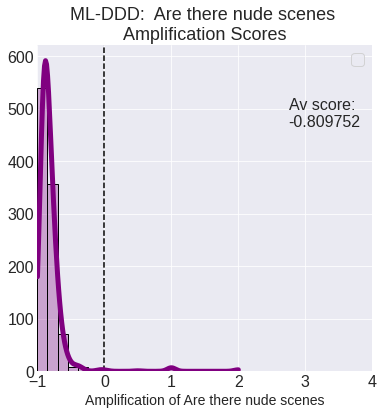

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone tortured: -0.7336952084941749


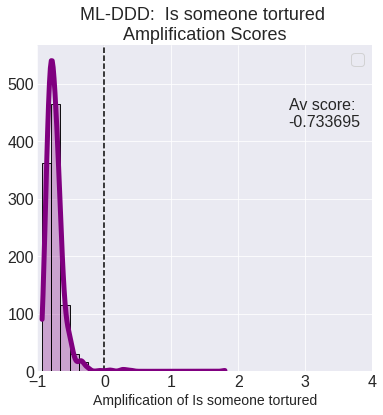

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a kid die: -0.5234740967797411


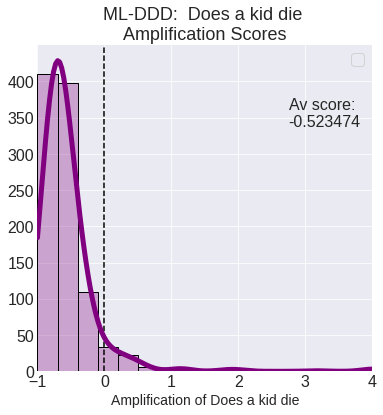

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a pregnant person die: -0.9604945116357327


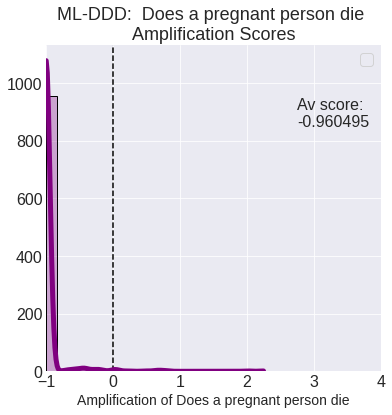

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there homophobic slurs: -0.7309454919858339


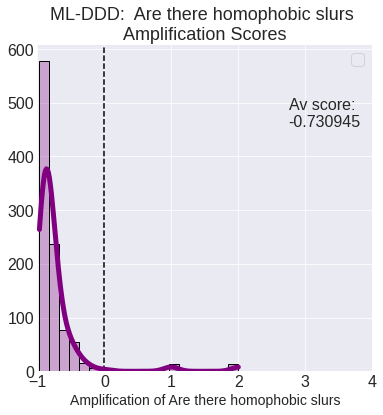

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone break a bone: -0.7992595612500214


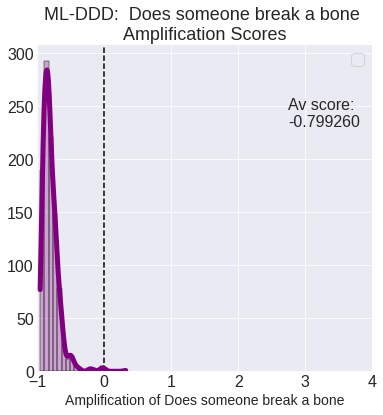

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there n-words: -0.6312290147503479


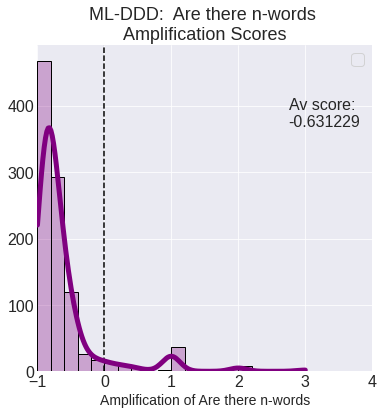

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there addiction: -0.5812359854971111


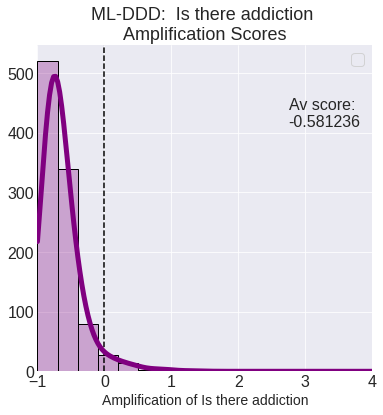

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there shakey cam: -0.5078157110970909


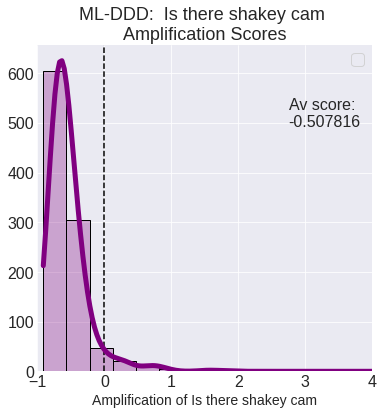

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there body dysmorphia: -0.46584206141614537


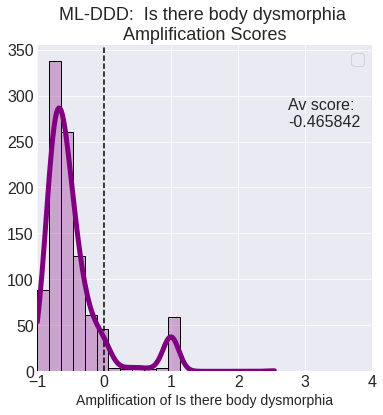

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a dead animal: -0.722765723160181


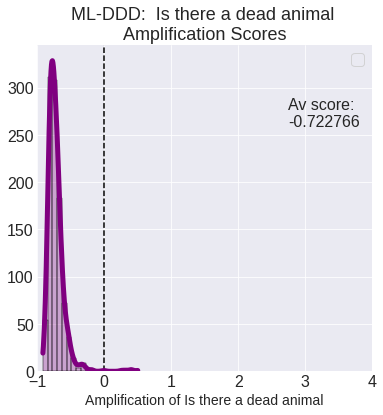

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there clowns: -0.2868706352924985


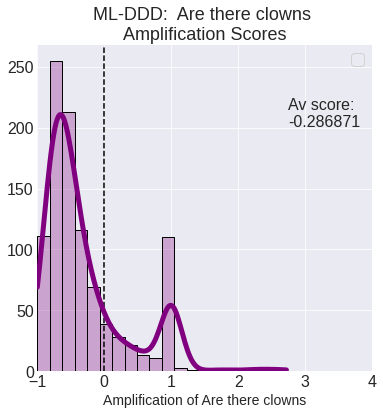

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a mentally ill person violent: -0.6730507473141859


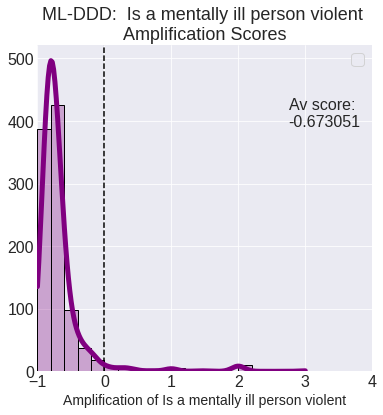

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there spiders: -0.4134343371127097


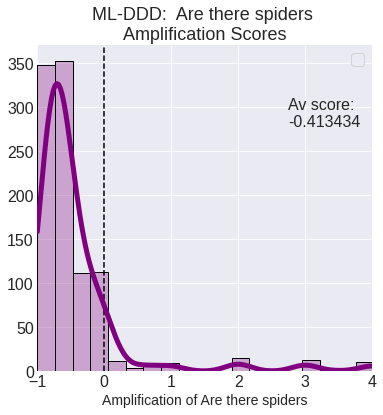

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a child's toy destroyed: -0.335434561332044


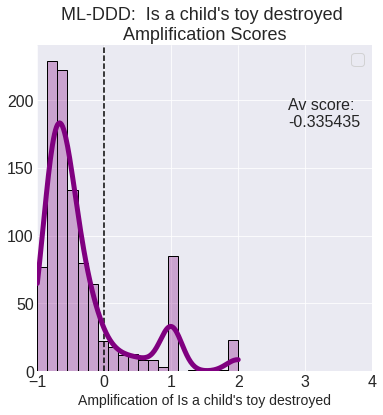

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there mannequins: -0.5246745743795681


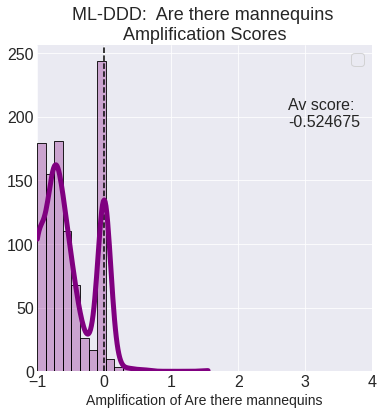

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there Achilles Tendon injury: -0.7006720833333333


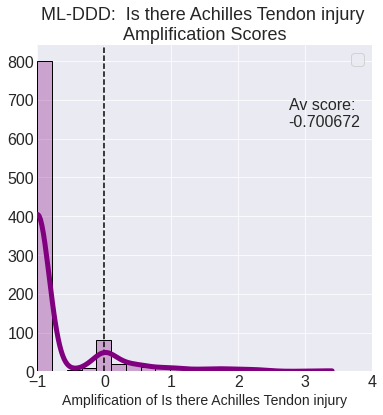

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone stalked: -0.5572146428801752


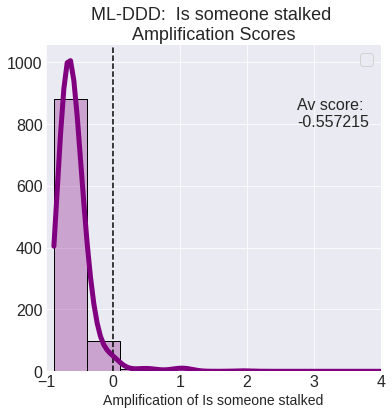

/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there D.I.D. misrepresentation: -1.0


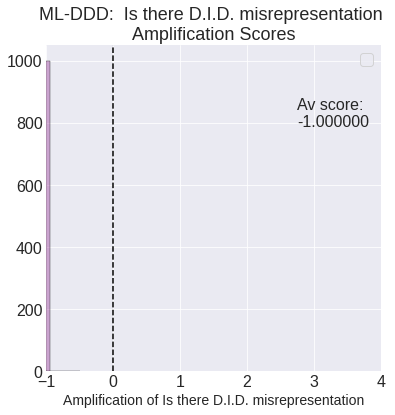

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there 9/11 depictions: -0.9875485227272728


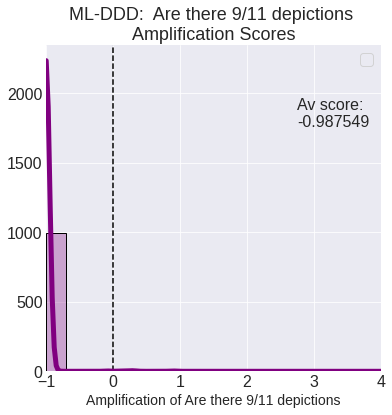

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a child abused: -0.5710619985187966


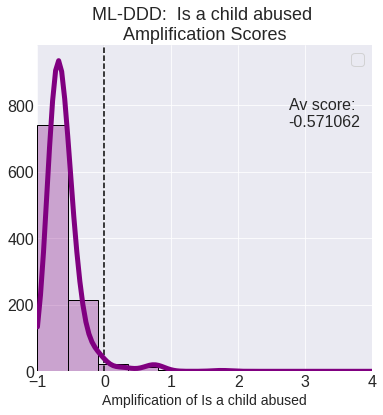

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are animals abused: -0.8571163711344856


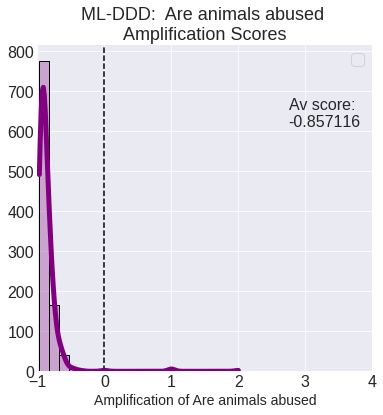

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is an infant abducted: -0.15259384623938155


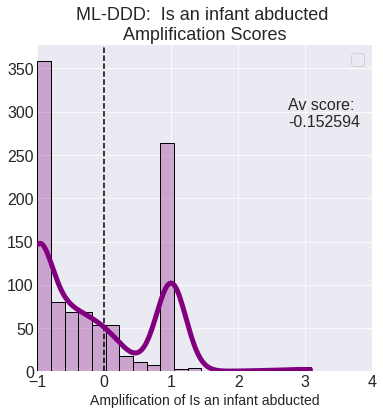

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a large age gap: -0.8326383294016653


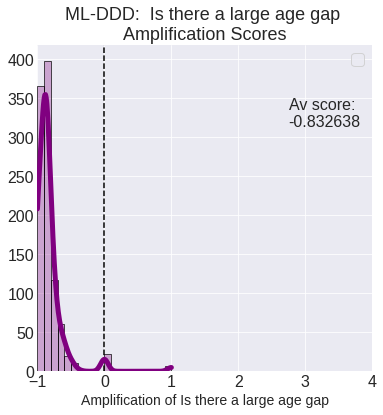

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there a claustrophobic scene: -0.8595426021221597


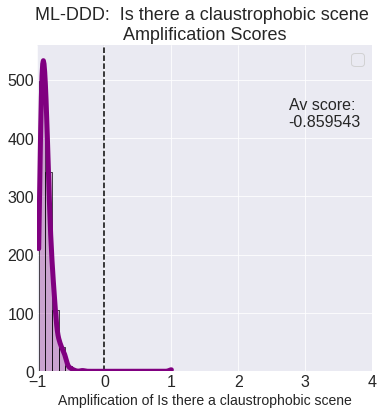

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone miscarry: -0.9836053516015103


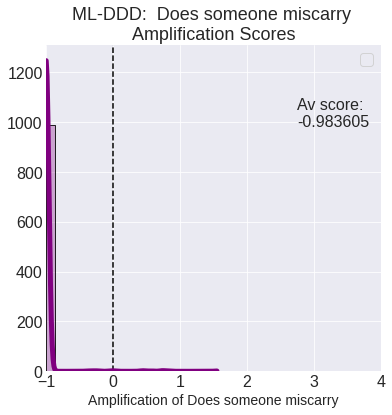

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does the black guy die first: -0.9656207251516693


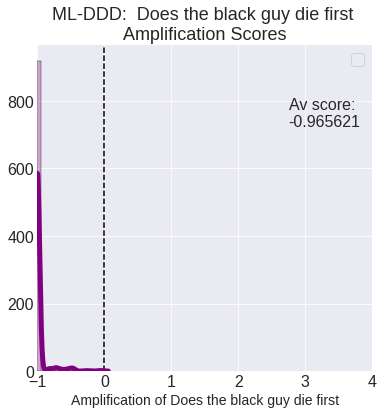

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there misophonia: -0.8648097669687747


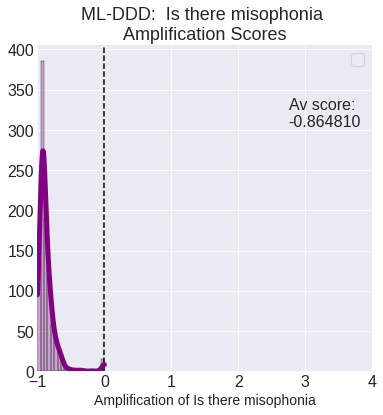

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a pet die: -0.7559995957146334


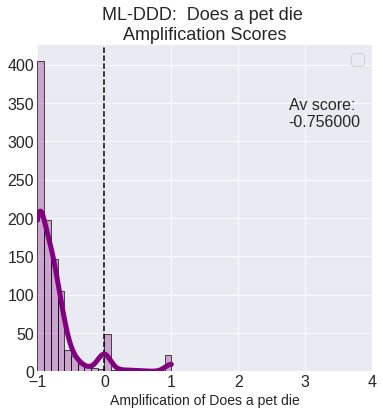

 av amp for Is a baby stillborn: -0.9627471428571428


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


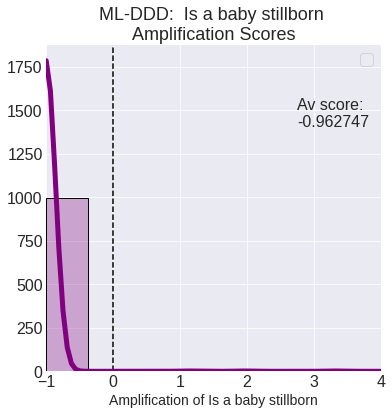

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there "Man in a dress" jokes: -0.780642202959334


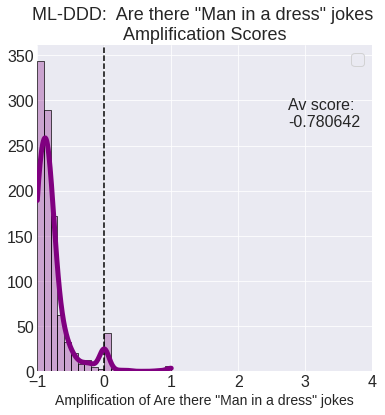

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone hit by a car: -0.7848527100062194


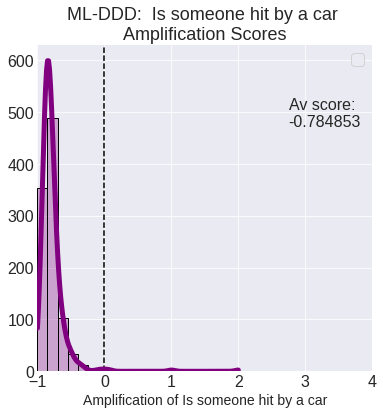

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is Santa (et al) spoiled: -0.9504908421855921


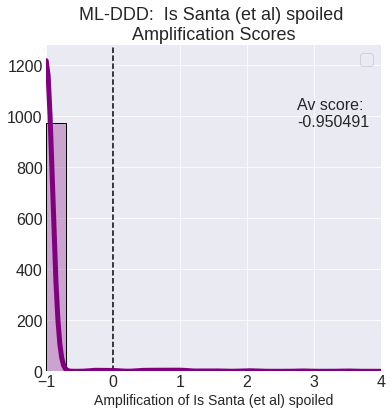

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone have a seizure: -0.4065893206009252


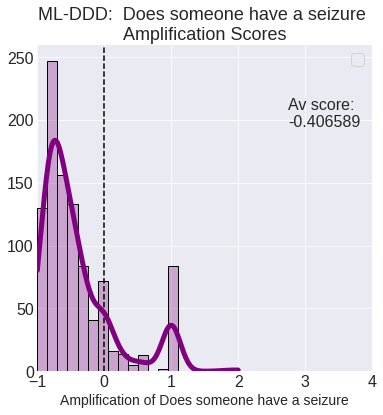

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there domestic violence: -0.7249037417454913


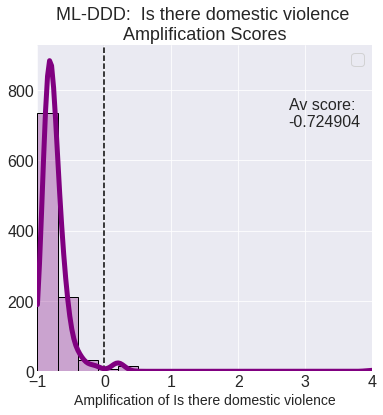

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone possessed: -0.22142123499696534


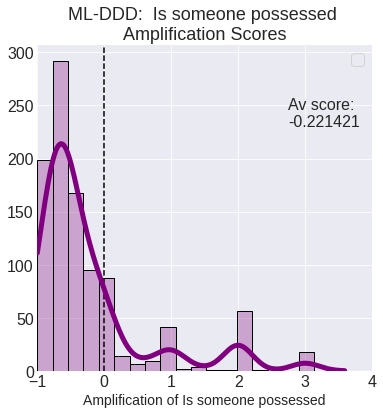

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there amputation: -0.7261956804594674


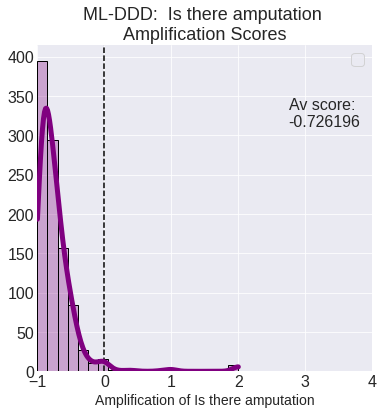

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there razors: -0.997334312797288


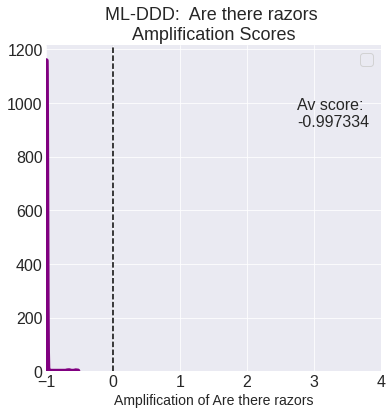

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there genital trauma/mutilation: -0.7361614090509687


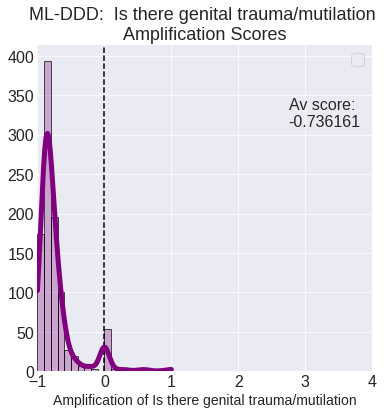

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are any teeth damaged: -0.7821637205104454


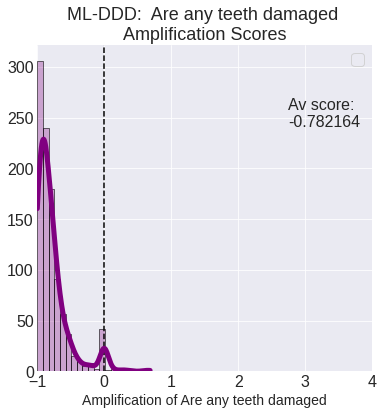

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there antisemitism: -0.9893461588658107


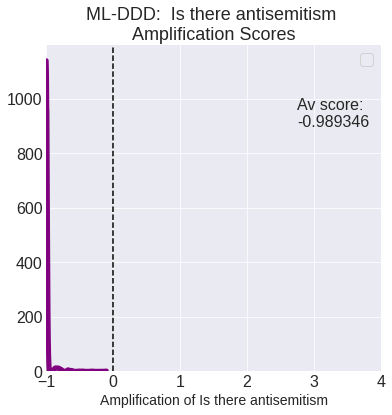

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is electro-therapy used: -0.9771142833182144


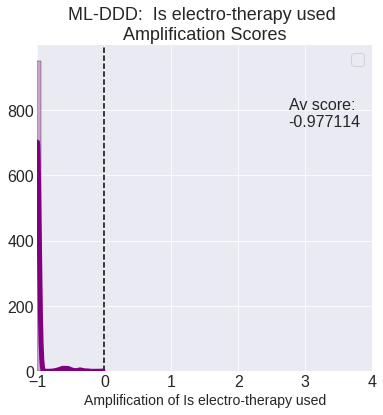

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone gaslighted: -0.6348610510718431


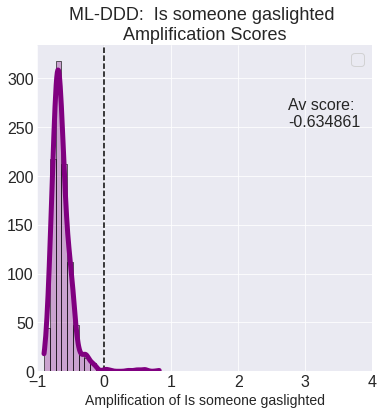

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone wet/soil themselves: -0.9114122287546924


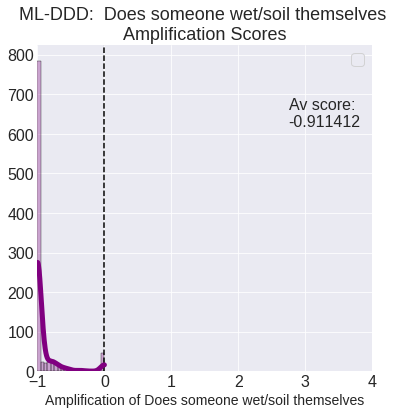

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone attempt suicide: -0.8286612845042765


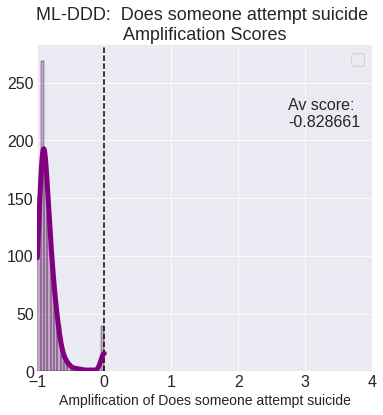

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is a male character ridiculed for crying: -0.8978803435588053


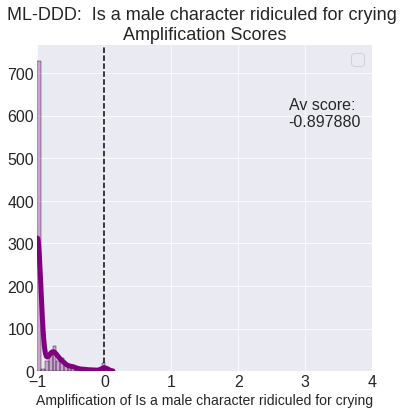

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does someone sacrifice themselves: -0.755515365766853


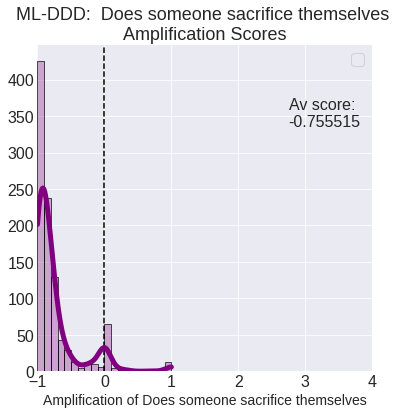

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a car crash: -0.8143149910796186


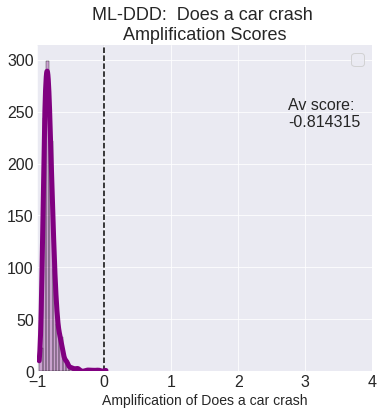

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone sexually assaulted: -0.6802760434685375


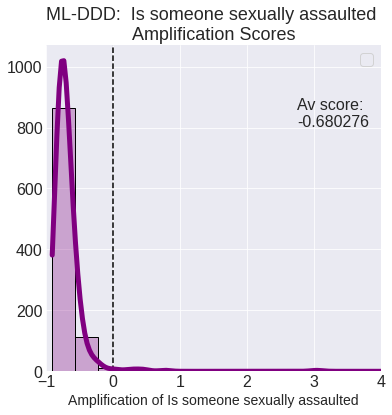

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone homeless: -0.6386900867335906


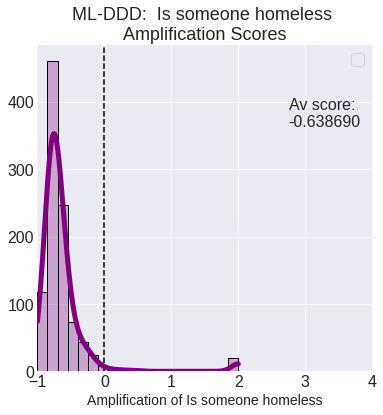

/share/apps/anaconda3/2021.05/lib/python3.8/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there fat suits: -1.0


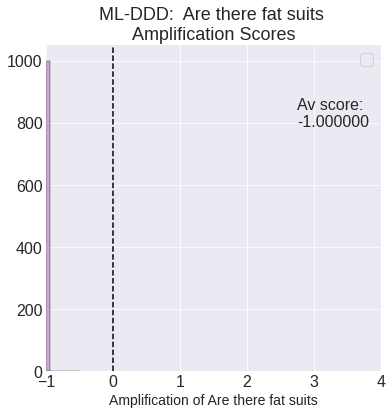

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is there excessive gore: -0.48911441313102477


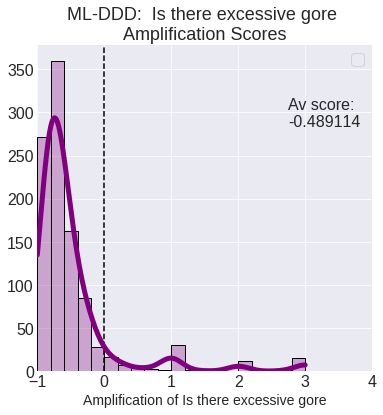

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone restrained: -0.7822743731189012


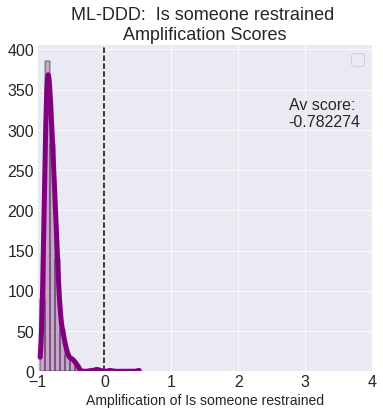

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone kidnapped: -0.6644870411187277


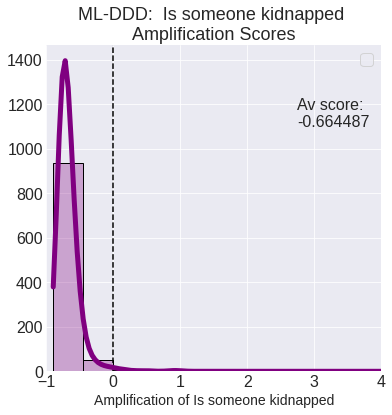

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Are there fat jokes: -0.925584239068816


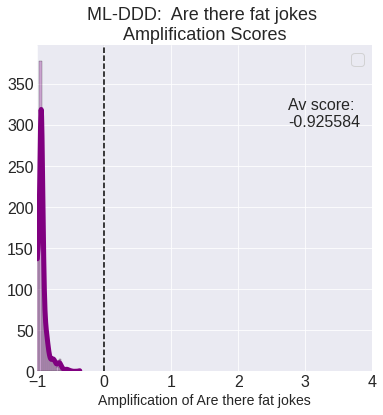

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Is someone sexually objectified: -0.8241394114583612


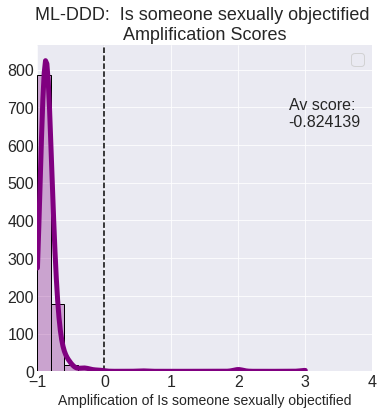

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


 av amp for Does a plane crash: -0.8241212165431729


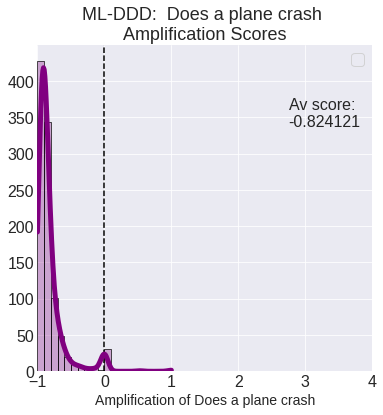

In [30]:
warning_amplification_plots(svd_amplification_dfs)

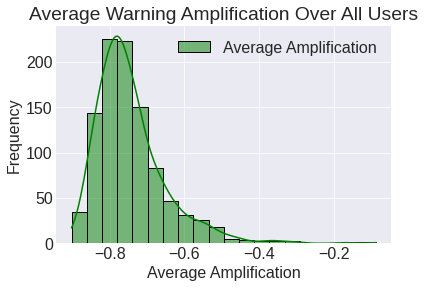

In [31]:
user_amplification_plots(svd_amplification_dfs)

### Overall

Random av amp: -0.6462829107928056
SVD av amp: -0.7444979138909967
Top Pop av amp: 0.7258862089175787


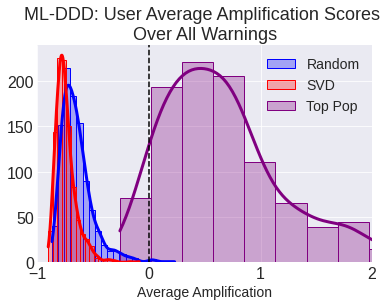

In [32]:
dms = [["Random", random_amplification_dfs, "blue"], ["SVD", svd_amplification_dfs, "red"], ["Top Pop", top_pop_amplification_dfs, "purple"]]

overlay_user_amplifications(dms)

Random av amp for Is there blood/gore: -0.6254629676742917


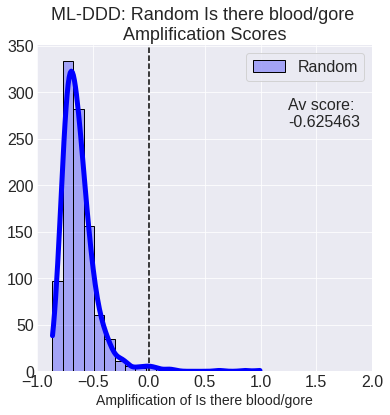

SVD av amp for Is there blood/gore: -0.7357948555399515


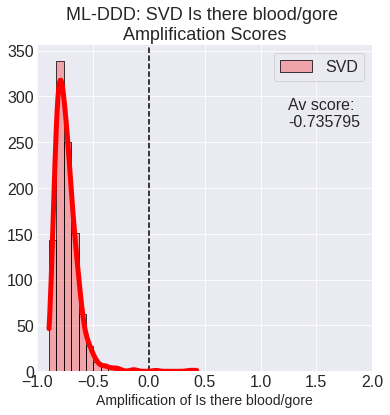

Top Pop av amp for Is there blood/gore: 0.2881515170635059


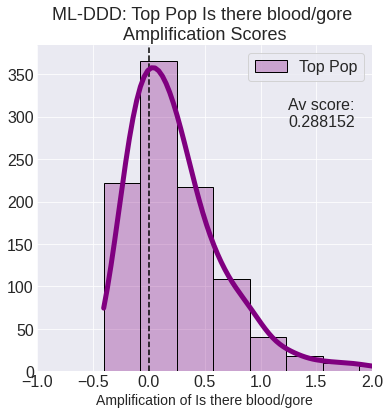

In [33]:
single_warning_amplification("Is there blood/gore", random_amplification_dfs, "Random", "blue", 2)
single_warning_amplification("Is there blood/gore", svd_amplification_dfs, "SVD", "red", 2)
single_warning_amplification("Is there blood/gore", top_pop_amplification_dfs, "Top Pop", "purple", 2)

Random av amp for Is there sexual content: -0.6222529018783081


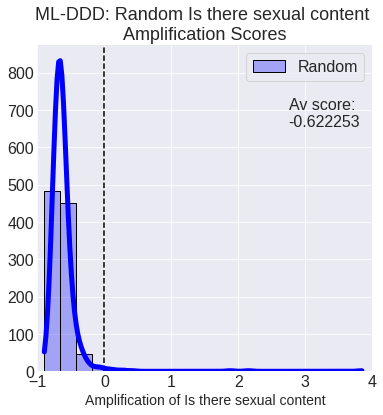

SVD av amp for Is there sexual content: -0.7306187847765656


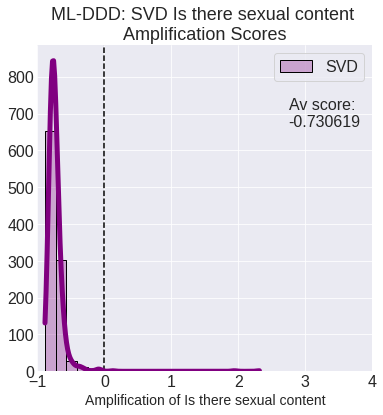

Top Pop av amp for Is there sexual content: 0.2494272186733639


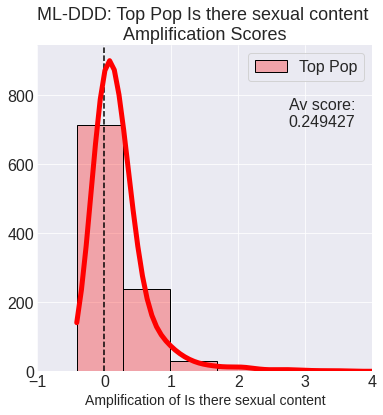

In [34]:
single_warning_amplification("Is there sexual content", random_amplification_dfs, "Random", "blue", 4)
single_warning_amplification("Is there sexual content", svd_amplification_dfs, "SVD", "purple", 4)
single_warning_amplification("Is there sexual content", top_pop_amplification_dfs, "Top Pop", "red", 4)

Random av amp for Does the dog die: -0.054496533121903085


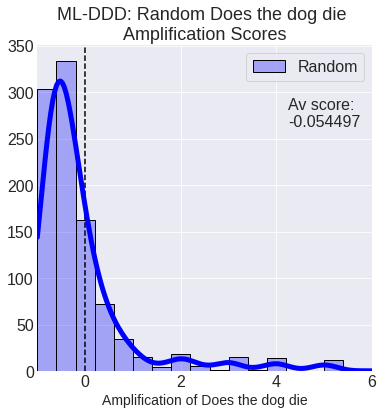

SVD av amp for Does the dog die: 0.03928078865251038


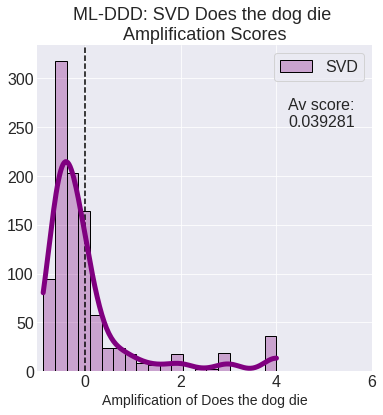

Top Pop av amp for Does the dog die: 0.46264739869529825


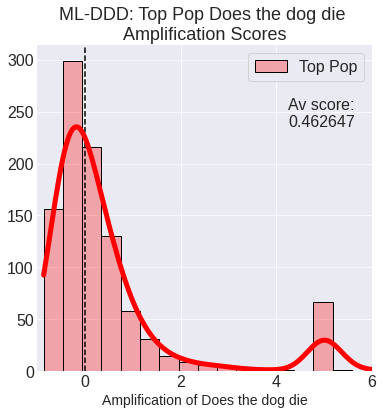

In [35]:
single_warning_amplification("Does the dog die", random_amplification_dfs, "Random", "blue", 6)
single_warning_amplification("Does the dog die", svd_amplification_dfs, "SVD", "purple", 6)
single_warning_amplification("Does the dog die", top_pop_amplification_dfs, "Top Pop", "red", 6)